# Set up

In [28]:
import drjit as dr
import mitsuba as mi
import matplotlib.pyplot as plt
import math
import numpy as np
import Imath, array
import OpenEXR

mi.set_variant('cuda_ad_rgb')
#mi.set_variant('scalar_rgb')

In [29]:
mi.ScalarTransform4f().rotate(axis=[0.9848*0.93969,0.173648*0.93969,-0.34202014], angle=30).rotate(axis=[-0.173648,0.9848,0], angle=20).rotate(axis=[0,0,1], angle=10)
mi.ScalarTransform4f().rotate(axis=[0,0,1], angle=10).rotate(axis=[0,1,0], angle=20).rotate(axis=[1,0,0], angle=30)

Transform[
  matrix=[[0.925417, 0.0180283, 0.378522, 0],
          [0.163176, 0.882564, -0.44097, 0],
          [-0.34202, 0.469846, 0.813798, 0],
          [0, 0, 0, 1]],
  inverse_transpose=[[0.925417, 0.0180283, 0.378522, 0],
                     [0.163176, 0.882564, -0.44097, 0],
                     [-0.34202, 0.469846, 0.813798, 0],
                     [0, 0, 0, 1]]
]

In [30]:
def render_livingroom_disk(mesh_path, dir_path, mat=False, twosided=False, spp=1000, max_depth=8, fov=50, res=[360,640]):
    if twosided:
        mesh_loaded = mi.load_dict({
            'type': 'ply',
            #'filename': 'ds_sample.ply',
            'filename': mesh_path,
            'bsdf': {
                'type':'twosided',
                'material':{        
                    'type': 'principled',
                    'base_color': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_albedo',
                    },
                    'metallic': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_metallic',
                    },
                    'roughness': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_roughness',
                    },
                }
            },
        })
    else:    
        mesh_loaded = mi.load_dict({
            'type': 'ply',
            #'filename': 'ds_sample.ply',
            'filename': mesh_path,
            'bsdf': {
                'type': 'principled',
                'base_color': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_albedo',
                },
                'metallic': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_metallic',
                },
                'roughness': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_roughness',
                },
            },
        })
    

    scene_dict = {
        'type': 'scene',
        'integrator': {
            'type':'aov',
            'aovs':'al:albedo,pos:position',
            'my_integrator':{'type': 'path', 'max_depth': max_depth, 'hide_emitters':True},
        },
        #'light': {'type': 'point', 'position': [0, 0, 0.1], 'intensity': {'type': 'spectrum', 'value': 1.0,}},
        #'light' : {'type' :'constant'},
        'sensor': {
            'type': 'perspective',
            'fov': fov,
            'near_clip': 0.01,
            'to_world': mi.ScalarTransform4f().look_at(
                origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
            ),
            'film_id': {
            'type': 'hdrfilm',
            'width': res[1],
            'height': res[0],
            'pixel_format': 'rgb',
            'component_format': 'float32',
            'filter': { 'type': 'tent' }
            },
        },
        'wholescene': mesh_loaded,
    }




    centers = np.load(dir_path+'/disk_centers.npy')
    light_num = centers.shape[0]
    eulers = np.load(dir_path+'/disk_eulers.npy')
    radiances = np.load(dir_path+'/disk_radiances.npy')
    scales = np.load(dir_path+'/disk_scales.npy')

    for i in range(light_num):
        name = 'light_'+str(i+1)
        scene_dict[name] = {
            'type': 'disk',
            'to_world': mi.ScalarTransform4f().translate(centers[i]).rotate(axis=[0,0,1], angle=eulers[i][2]).rotate(axis=[0,1,0], angle=eulers[i][1]).rotate(axis=[1,0,0], angle=eulers[i][0]).scale(float(scales[i])),
            'emitter': {
                'type': 'area',
                'radiance': {
                    'type': 'rgb',
                    'value': radiances[i] 
                },
            },
        }
    scene = mi.load_dict(scene_dict)
    if mat:
        params = mi.traverse(scene)
        params['wholescene.vertex_roughness'] = np.load(dir_path+'/rough_best.npy')
        params['wholescene.vertex_albedo'] = np.load(dir_path+'/albedo_best.npy')
        params['wholescene.vertex_metallic'] = np.load(dir_path+'/metal_best.npy')
        params.update() 

    return  mi.render(scene, spp=spp)

def build_mesh_2d_metal(z_depth_pos, name, albedo_1d_array, material_array, res=[256,256], fov=90, write_ply=True, threshold=0.01, delete_square=False, normal_array=None):
    # mesh : H * W * 3
    # modified xy

    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    if albedo_1d_array.ndim != 1:
        albedo_1d_array = albedo_1d_array.reshape([-1])

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim

    y,x = np.mgrid[(y_dim-1)/(x_dim-1):-(y_dim-1)/(x_dim-1):y_dim*1j, -1:1:x_dim*1j]
    y = y.reshape([-1])
    x = x.reshape([-1])
    z = (-1*z_depth_pos).reshape([-1])

    y_modified = y*np.abs(z)*math.tan(math.radians(fov/2))
    x_modified = x*np.abs(z)*math.tan(math.radians(fov/2))

    vertex_pos = mi.Point3f(x_modified, y_modified, z)

    # face list : 
    # q--p           r
    # | /  x res,  / | x res
    # r           p--q

    p_tmp_1 = np.arange(x_dim*(y_dim-1))
    p_1 = p_tmp_1[p_tmp_1 % x_dim != (x_dim-1)]

    p = np.concatenate([p_1+1, p_1+x_dim])
    q = np.concatenate([p_1, p_1+x_dim+1])
    r = np.concatenate([p_1+x_dim, p_1+1])


    delete_idx = []
    
    if not delete_square:
        for i in range(2*(x_dim-1)*(y_dim-1)):
            dist1 = ((x_modified[p[i]] - x_modified[q[i]])**2 + (y_modified[p[i]] - y_modified[q[i]])**2 + (z[p[i]] - z[q[i]])**2)**0.5
            dist2 = ((x_modified[q[i]] - x_modified[r[i]])**2 + (y_modified[q[i]] - y_modified[r[i]])**2 + (z[q[i]] - z[r[i]])**2)**0.5
        
            #dist = np.max([z[p[i]], z[q[i]], z[r[i]]]) - np.min([z[p[i]], z[q[i]], z[r[i]]])
            dist = max(dist1,dist2)
            if dist > threshold: #delete mesh
                delete_idx.append(i)
    else:
        for i in range((x_dim-1)*(y_dim-1)):
            dist1 = ((x_modified[p[i]] - x_modified[q[i]])**2 + (y_modified[p[i]] - y_modified[q[i]])**2 + (z[p[i]] - z[q[i]])**2)**0.5
            dist2 = ((x_modified[q[i]] - x_modified[r[i]])**2 + (y_modified[q[i]] - y_modified[r[i]])**2 + (z[q[i]] - z[r[i]])**2)**0.5
            dist3 = ((x_modified[p[i+(x_dim-1)*(y_dim-1)]] - x_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[p[i+(x_dim-1)*(y_dim-1)]] - y_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (z[p[i+(x_dim-1)*(y_dim-1)]] - z[q[i+(x_dim-1)*(y_dim-1)]])**2)**0.5
            dist4 = ((x_modified[q[i+(x_dim-1)*(y_dim-1)]] - x_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[q[i+(x_dim-1)*(y_dim-1)]] - y_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (z[q[i+(x_dim-1)*(y_dim-1)]] - z[r[i+(x_dim-1)*(y_dim-1)]])**2)**0.5


            #dist = np.max([z[p[i]], z[q[i]], z[r[i]]]) - np.min([z[p[i]], z[q[i]], z[r[i]]])
            dist = np.max([dist1,dist2,dist3,dist4])
            if dist > threshold: #delete mesh
                # p[i] q[i] r[i] 
                delete_idx.append(i)
                delete_idx.append(i+(x_dim-1)*(y_dim-1))
    print(len(delete_idx))
    p = np.delete(p,delete_idx)
    q = np.delete(q,delete_idx)
    r = np.delete(r,delete_idx)

    face_indices = mi.Vector3u(p, q, r)
    #print(len(delete_idx))
    if normal_array is None:
        mesh = mi.Mesh(
            name,
            vertex_count=N,
            face_count=2*(x_dim-1)*(y_dim-1)-len(delete_idx),
            has_vertex_normals=False,
            has_vertex_texcoords=False,
        )
    else:
        mesh = mi.Mesh(
            name,
            vertex_count=N,
            face_count=2*(x_dim-1)*(y_dim-1)-len(delete_idx),
            has_vertex_normals=True,
            has_vertex_texcoords=False,
        )        
    mesh_params = mi.traverse(mesh)
    mesh_params['vertex_positions'] = dr.ravel(vertex_pos)
    mesh_params['faces'] = dr.ravel(face_indices)
    if normal_array is not None:
        mesh_params['vertex_normals'] = dr.ravel(normal_array.reshape(-1))

    mesh.add_attribute('vertex_albedo', 3, albedo_1d_array)
    mesh.add_attribute('vertex_roughness', 1, material_array[:,:,0].reshape(-1))
    mesh.add_attribute('vertex_metallic', 1, material_array[:,:,1].reshape(-1))
    mesh_params.update()
    if write_ply:
        mesh.write_ply(name+'.ply')
    return mesh

def exr2np(exr_path, height=480):
    img= OpenEXR.InputFile(exr_path)
    pt = Imath.PixelType(Imath.PixelType.FLOAT)
    r_str, g_str, b_str = img.channels('RGB', pt)
    red = np.array(array.array('f', r_str))
    green = np.array(array.array('f', g_str))
    blue = np.array(array.array('f', b_str))

    return np.stack([red.reshape([height,-1]),green.reshape([height,-1]),blue.reshape([height,-1])], axis=-1)

from PIL import Image
import torch
import torch.nn.functional as F
def change_albedo(albedo_filename, mask_filename, new_color=[0,0,0], height=360):
    if len(albedo_filename) >= 4 and albedo_filename[-3:] == 'png':
        albedo_np = np.array(Image.open(albedo_filename))
        if albedo_np.shape[2] == 4:
            albedo_np = albedo_np[:,:,:3]
    elif albedo_filename[-3:] == 'npy':
        albedo_np = np.load(albedo_filename)
        if albedo_np.ndim == 4:
            #cv2 format
            albedo_np = albedo_np.squeeze().transpose([1,2,0])
    elif albedo_filename[-3:] == 'exr':
        albedo_np = (exr2np(albedo_filename, height=height))
    if not albedo_np.dtype in [np.int8, np.int16, np.int32, np.int64, np.uint8, np.uint16, np.uint32, np.uint32]:
        albedo_np = (albedo_np*255).astype(np.uint8)
    
    if type(mask_filename) is list:
        mask_filenames = mask_filename
        new_colors = new_color
        if not type(new_color[0]) is list or len(mask_filename) != len(new_color):
            print('error: mask number and color number are not same.')
            return
    else:
        mask_filenames = [mask_filename]
        new_colors = [new_color]
    
    for i, mp in enumerate(mask_filenames):  
        mask_np = np.array(Image.open(mp).convert('L')).astype(np.float32)/255
        h_albedo = albedo_np.shape[0]
        h_mask = mask_np.shape[0]
        nc = new_colors[i]
        if h_albedo == h_mask:
            # just change the color
            mask_np = mask_np[:,:,np.newaxis]
            new_albedo_np = mask_np*np.array([*nc]*(h_albedo)*(albedo_np.shape[1])).reshape(h_albedo,albedo_np.shape[1],3) + (1-mask_np)*(albedo_np)
            new_albedo_np = new_albedo_np.astype(np.uint8) 
        else:
            # down/up sample the size of mask
            mask_torch = torch.from_numpy((mask_np[:,:,np.newaxis,np.newaxis]).transpose(2,3,0,1))
            mask_np = F.adaptive_avg_pool2d(mask_torch, (h_albedo, albedo_np.shape[1])).numpy().squeeze(0).transpose(1,2,0)
            new_albedo_np = mask_np*np.array([*nc]*(h_albedo)*(albedo_np.shape[1])).reshape(h_albedo,albedo_np.shape[1],3) + (1-mask_np)*(albedo_np)
            new_albedo_np = new_albedo_np.astype(np.uint8)
        albedo_np = new_albedo_np

    return new_albedo_np

def change_material(material_filename, mask_filename, new_rough=0, height=360):
    mat_np = exr2np(material_filename, height=height)
    mask_np = np.array(Image.open(mask_filename).convert('L')).astype(np.float32)/255
    h_mat = mat_np.shape[0]
    h_mask = mask_np.shape[0]
    if h_albedo == h_mask:
        # just change the color
        mask_np = mask_np[:,:,np.newaxis]
        new_mat_np = mask_np*np.array(new_rough*(h_mat)*(mat_np.shape[1])).reshape(h_mat,mat_np.shape[1],2) + (1-mask_np)*(mat_np)
    return new_mat_np

def depth_from_plane(depth_2d, fov):
    h = depth_2d.shape[0]
    w = depth_2d.shape[1]
    refined_depth = np.zeros([h,w])
    c_x = w/2
    c_y = h/2
    for i in range(h):
        for j in range(w):
            tan_theta = (((i-c_y)**2+(j-c_x)**2)**0.5)*math.tan(math.radians(fov/2))/(w/2)
            refined_depth[i,j] = depth_2d[i,j] / np.sqrt(1+(tan_theta)**2)
    return refined_depth

In [31]:
def render_livingroom_env(mesh_path, dir_path, twosided=False, spp=1000, max_depth=8, fov=50, res=[360,640]):
    if twosided:
        mesh_loaded = mi.load_dict({
            'type': 'ply',
            #'filename': 'ds_sample.ply',
            'filename': mesh_path,
            'bsdf': {
                'type':'twosided',
                'material':{        
                    'type': 'principled',
                    'base_color': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_albedo',
                    },
                    'metallic': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_metallic',
                    },
                    'roughness': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_roughness',
                    },
                }
            },
        })
    else:    
        mesh_loaded = mi.load_dict({
            'type': 'ply',
            #'filename': 'ds_sample.ply',
            'filename': mesh_path,
            'bsdf': {
                'type': 'principled',
                'base_color': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_albedo',
                },
                'metallic': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_metallic',
                },
                'roughness': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_roughness',
                },
            },
        })
    

    scene_dict = {
        'type': 'scene',
        'integrator': {
            'type':'aov',
            'aovs':'al:albedo,pos:position',
            'my_integrator':{'type': 'path', 'max_depth': max_depth, 'hide_emitters':True},
        },
        #'light': {'type': 'point', 'position': [0, 0, 0.1], 'intensity': {'type': 'spectrum', 'value': 1.0,}},
        #'light' : {'type' :'constant'},
        'sensor': {
            'type': 'perspective',
            'fov': fov,
            'near_clip': 0.01,
            'to_world': mi.ScalarTransform4f().look_at(
                origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
            ),
            'film_id': {
            'type': 'hdrfilm',
            'width': res[1],
            'height': res[0],
            'pixel_format': 'rgb',
            'component_format': 'float32',
            'filter': { 'type': 'tent' }
            },
        },
        'wholescene': mesh_loaded,
    }

    scene_dict['light'] = {
        'type': 'envmap',
        'filename': dir_path+'/best_env.exr'
    }
    scene = mi.load_dict(scene_dict)

    return  mi.render(scene, spp=spp)

# Render GT envmap

In [ ]:
scene = mi.load_file('living-room-3/living-room-3/scene.xml')
sensors = [mi.load_dict({
    'type': 'perspective',
    'fov': 90,
    'near_clip': 0.001,
    'to_world': x,
    'film_id': {
        'type': 'hdrfilm',
        'width': 120,
        'height': 120,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
    },
}),
mi.load_dict({
    'type': 'perspective',
    'fov': 90,
    'near_clip': 0.001,
    'to_world': x @ mi.ScalarTransform4f.rotate(axis=[0, -1, 0], angle=90),
    'film_id': {
        'type': 'hdrfilm',
        'width': 120,
        'height': 120,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
    },
}),
mi.load_dict({
    'type': 'perspective',
    'fov': 90,
    'near_clip': 0.001,
    'to_world': x @ mi.ScalarTransform4f.rotate(axis=[0, 1, 0], angle=90),
    'film_id': {
        'type': 'hdrfilm',
        'width': 120,
        'height': 120,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
    },
}),
mi.load_dict({
    'type': 'perspective',
    'fov': 90,
    'near_clip': 0.001,
    'to_world': x @ mi.ScalarTransform4f.rotate(axis=[0, 1, 0], angle=180),
    'film_id': {
        'type': 'hdrfilm',
        'width': 120,
        'height': 120,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
    },
}),
mi.load_dict({
    'type': 'perspective',
    'fov': 90,
    'near_clip': 0.001,
    'to_world': x @ mi.ScalarTransform4f.rotate(axis=[-1, 0, 0], angle=90),
    'film_id': {
        'type': 'hdrfilm',
        'width': 120,
        'height': 120,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
    },
}),
mi.load_dict({
    'type': 'perspective',
    'fov': 90,
    'near_clip': 0.001,
    'to_world': x @ mi.ScalarTransform4f.rotate(axis=[1, 0, 0], angle=90),
    'film_id': {
        'type': 'hdrfilm',
        'width': 120,
        'height': 120,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
    },
})
]
front = mi.render(scene, sensor = sensors[0], spp=200)[:,:,:3]
right = mi.render(scene, sensor = sensors[1], spp=200)[:,:,:3] #right
left = mi.render(scene, sensor = sensors[2], spp=200)[:,:,:3] #left
back = mi.render(scene, sensor = sensors[3], spp=200)[:,:,:3] #back
up = mi.render(scene, sensor = sensors[4], spp=200)[:,:,:3] #up
down = mi.render(scene, sensor = sensors[5], spp=200)[:,:,:3] #down
mi.util.write_bitmap('living_env_front.png', front)
mi.util.write_bitmap('living_env_right.png', right)
mi.util.write_bitmap('living_env_left.png', left)
mi.util.write_bitmap('living_env_back.png', back)
mi.util.write_bitmap('living_env_up.png', up)
mi.util.write_bitmap('living_env_down.png', down)
canvas = np.zeros([360, 480, 3], dtype=np.float32)
canvas[120:240, 0:120, :] = left.numpy()
canvas[120:240, 120:240, :] = front.numpy()
canvas[120:240, 240:360, :] = right.numpy()
canvas[120:240, 360:480, :] = back.numpy()
canvas[:120, 120:240, :] = up.numpy()
canvas[240:, 120:240, :] = down.numpy()
imageio.imwrite('livingroom_cube.exr', canvas)

# 1

In [ ]:
build_mesh_2d_metal(depth_l[::2,::2]*0.6+0.3, 'livingroom_normal_gt', albedo_l_bl.reshape(-1), mat_l[:,:,::-1], res=[360,640],threshold=0.03, fov=50, normal_array=normal_gt)

4844


Mesh[
  name = "livingroom_normal_gt",
  bbox = BoundingBox3f[
    min = [-0.246383, -0.101543, -0.9],
    max = [0.419677, 0.235781, -0.3]
  ],
  vertex_count = 230400,
  vertices = [9.67 MiB of vertex data],
  face_count = 453958,
  faces = [5.2 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
normal_l = exr2np('../IndoorInverseRendering/mgnet/livingroom_2/dense_v1/normal/0000.exr', height=360)

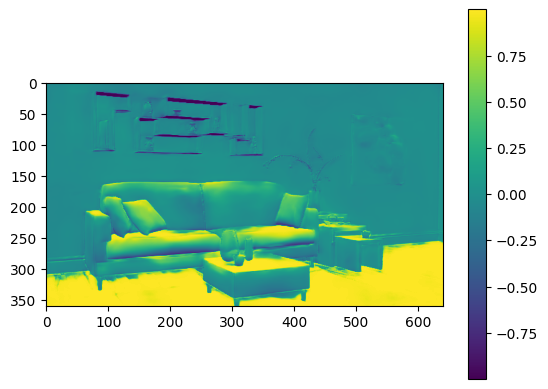

In [ ]:
plt.imshow((normal_l*2-1.0)[:,:,1])
plt.colorbar()

In [ ]:
albedo_l_2 = exr2np('../IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr', height=360)

In [ ]:
albedo_l_bl = exr2np('../IndoorInverseRendering/lightnet/test/livingroom_2/00_output_albedo_bl.exr', height=360)

In [155]:
mat_l_2 = exr2np('../IndoorInverseRendering/mgnet/livingroom_3/dense_v1/material/0000.exr', height=360)

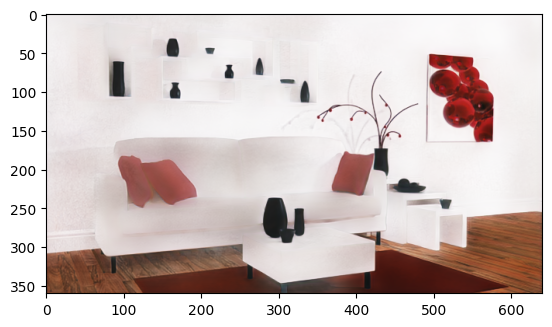

In [ ]:
plt.imshow(albedo_l_2)

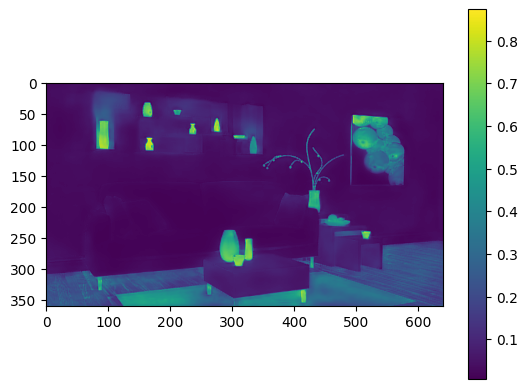

In [ ]:
plt.imshow(mat_l_2[:,:,1])
plt.colorbar()

In [ ]:
build_mesh_2d_metal(depth_gt, 'livingroom_depthgt_2', albedo_l_2.reshape(-1), mat_l_2, res=[360,640],threshold=0.03, fov=50)

5585


Mesh[
  name = "livingroom_depthgt_2",
  bbox = BoundingBox3f[
    min = [-0.295698, -0.123355, -1],
    max = [0.461457, 0.257751, -0.438188]
  ],
  vertex_count = 230400,
  vertices = [7.03 MiB of vertex data],
  face_count = 453217,
  faces = [5.19 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [156]:
al_red = change_albedo('../IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr', 'living-room-3/living-room-3/living_mask2.png',[200,0,0], height=360).astype(np.float32)/255
build_mesh_2d_metal(depth_gt, 'livingroom_depthgt_2_red', al_red.reshape(-1), mat_l_2, res=[360,640],threshold=0.03, fov=50)

5573


Mesh[
  name = "livingroom_depthgt_2_red",
  bbox = BoundingBox3f[
    min = [-0.2957, -0.123397, -1],
    max = [0.461461, 0.257781, -0.438192]
  ],
  vertex_count = 230400,
  vertices = [7.03 MiB of vertex data],
  face_count = 453229,
  faces = [5.19 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
scene = mi.load_file('living-room-3/living-room-3/scene_red.xml')
image = mi.render(scene, spp=2500)
mi.util.write_bitmap('livingroom_red.exr', image[:,:,:3])
mi.util.write_bitmap('livingroom_red.png', image[:,:,:3])
mi.util.write_bitmap('livingroom_albedo_red.png', image[:,:,6:9])

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


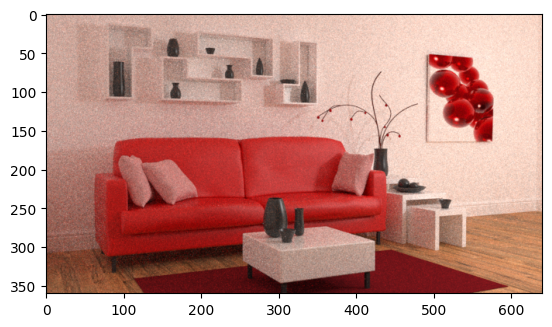

In [136]:
scene = mi.load_file('living-room-3/living-room-3/scene_diffuse_sofa.xml')
im = mi.render(scene,spp=100)
plt.imshow((im[:,:,:3])**(1/2.2))


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'z')

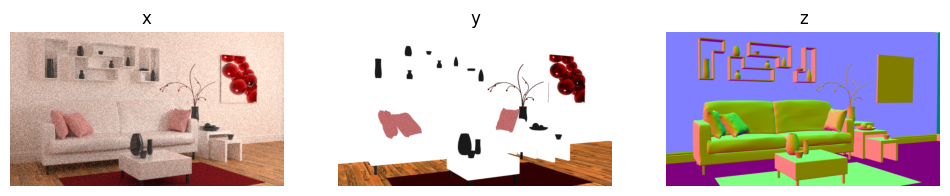

In [83]:
import matplotlib.pyplot as plt
scene = mi.load_file('living-room-3/living-room-3/scene.xml')
image_l2 = mi.render(scene, spp=30)

fig, axs = plt.subplots(1, 3, figsize=(12, 4))
axs[0].imshow(image_l2[:,:,:3]**(1/2.2));  axs[0].axis('off'); axs[0].set_title('x')
axs[1].imshow(image_l2[:,:,6:9]);  axs[1].axis('off'); axs[1].set_title('y') #srgb
axs[2].imshow((image_l2[:,:,9:12].numpy()+1)/2);  axs[2].axis('off'); axs[2].set_title('z')

(-0.5, 639.5, 359.5, -0.5)

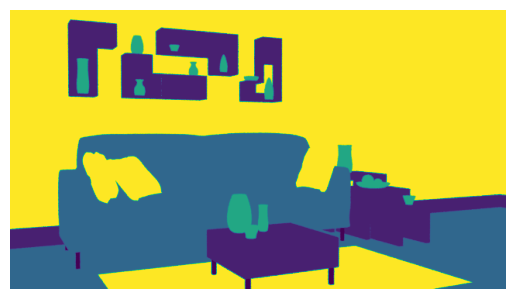

In [105]:
scene = mi.load_file('living-room-3/living-room-3/scene_roughness_info.xml')
plt.imshow(mi.render(scene,spp=10)[:,:,3])
plt.axis('off')

(-0.5, 639.5, 359.5, -0.5)

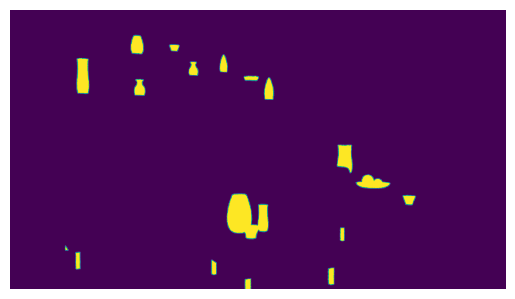

In [110]:
scene = mi.load_file('living-room-3/living-room-3/scene_metal_info.xml')
plt.imshow(mi.render(scene,spp=10)[:,:,6])
plt.axis('off')

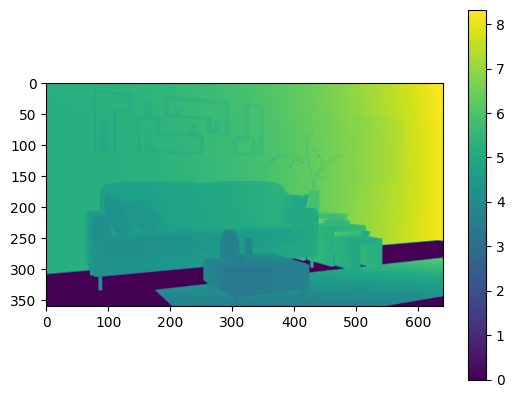

In [102]:
scene = mi.load_file('living-room-3/living-room-3/scene_normal_info.xml')
plt.imshow((mi.render(scene, spp=30)[:,:,15]))
plt.colorbar()

In [93]:
mi.util.write_bitmap('normal_map.png', ((mi.render(scene, spp=30)[:,:,9:12]+1)/2)**(2.2))

In [ ]:
Image.fromarray(((image_l2[:,:,6:9].numpy())*255).astype(np.uint8)).save('living_albedo_1.png')

In [ ]:
image_l2[338,471,6:9] # = sRGB value

[0.19, 0.0058496, 0.0103978]

In [ ]:
scene_b = mi.load_file('living-room-3/living-room-3/scene_b.xml')
image_l2_b = mi.render(scene_b, spp=2000)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


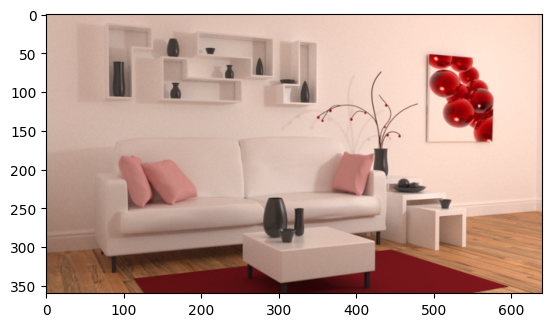

In [ ]:
plt.imshow(image_l2[:,:,:3]**(1/2.2))
mi.util.write_bitmap('living-room-3/living-room-3/livingroom_nograss.exr', image_l2[:,:,:3])
mi.util.write_bitmap('living-room-3/living-room-3/livingroom_nograss.png', image_l2[:,:,:3])

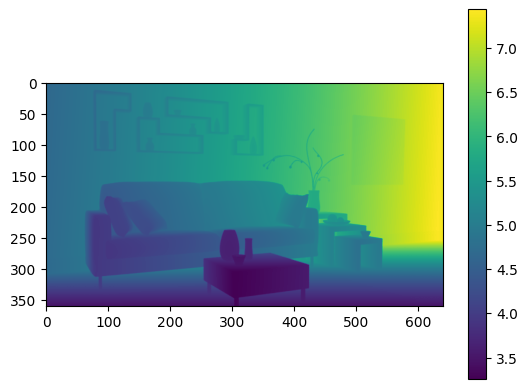

In [152]:
depth_gt = depth_from_plane(image_l2[:,:,-1].numpy(), fov=50)
plt.imshow(depth_gt)
plt.colorbar()


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


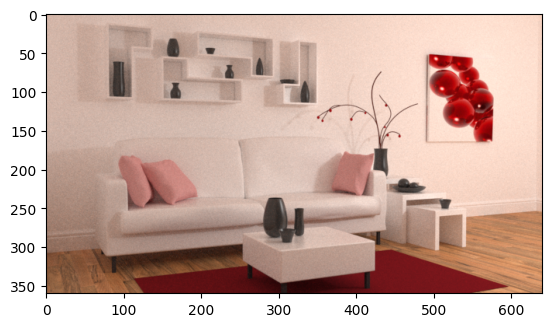

In [ ]:
import matplotlib.pyplot as plt
scene = mi.load_file('living-room-3/living-room-3/scene.xml')
image_l2 = mi.render(scene)

plt.imshow(image_l2[:,:,:3]**(1/2.2));

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


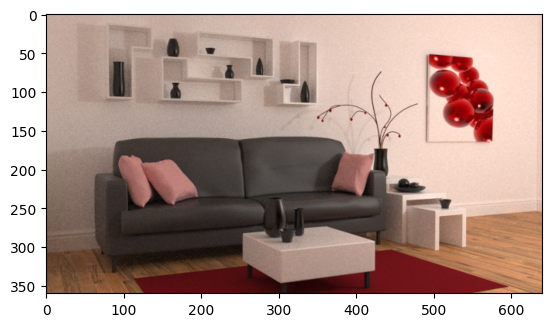

In [ ]:
scene_b = mi.load_file('living-room-3/living-room-3/scene_b.xml')
image_l2_b = mi.render(scene_b)
plt.imshow(image_l2_b[:,:,:3]**(1/2.2));


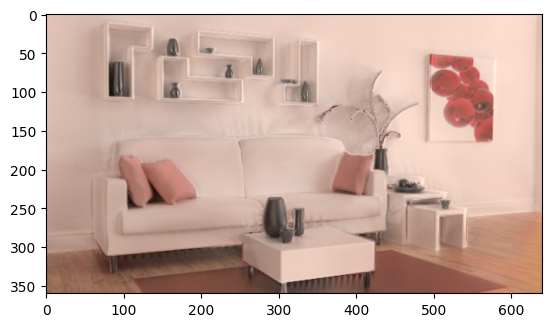

In [ ]:
img_002_two = render_livingroom('livingroom_depthgt_2.ply',env_path='livingroom_light_opt_results/0910_00:26:04/best_env.exr',scale=1.4620638)
plt.imshow(mi.util.convert_to_bitmap(img_002_two))  

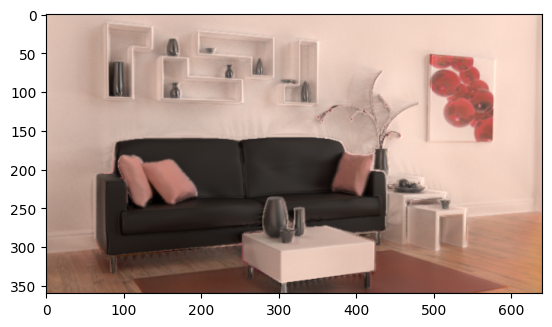

In [ ]:
img_bl = render_livingroom('livingroom_depthgt_2_bl.ply',env_path='livingroom_light_opt_results/0910_00:26:04/best_env.exr',scale=1.4620638)
plt.imshow(mi.util.convert_to_bitmap(img_bl))

In [ ]:
mask_np = (np.array(Image.open('living-room-3/living-room-3/living_mask2.png').convert('L')).astype(np.float32)/255)[:,:,np.newaxis]

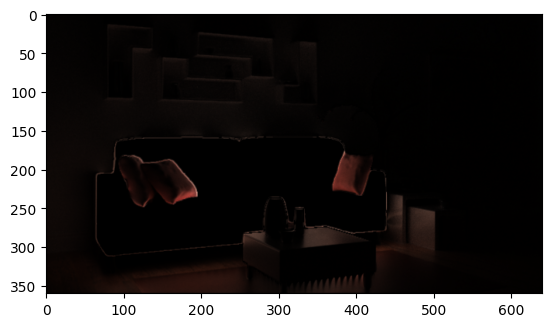

In [ ]:
plt.imshow(2*np.abs(img_002_two - img_bl)*(1-mask_np))

In [ ]:
Image.fromarray(2*(np.abs(img_002_two - img_bl)*(1-mask_np)*255).astype(np.uint8)).save('ours_diff_2.png')

In [ ]:
np.load('livingroom_arealight_opt_results/0910_21:52:03/best_sphere_radiance.npy').shape

(45, 3)

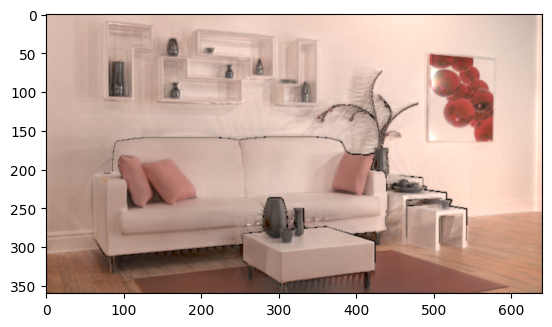

In [ ]:
img_area = render_livingroom_arealight('livingroom_depthgt_2.ply',radiance_path='livingroom_arealight_opt_results/0910_21:52:03/best_sphere_radiance.npy')
plt.imshow(mi.util.convert_to_bitmap(img_area)) 

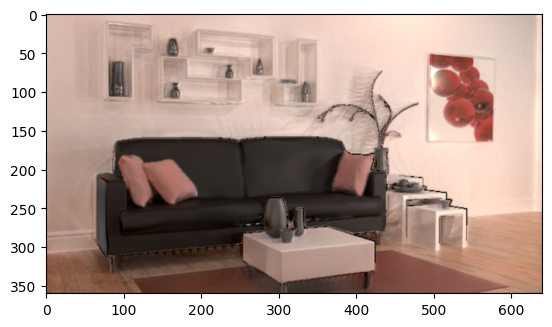

In [ ]:
img_area_bl = render_livingroom_arealight('livingroom_depthgt_2_bl.ply',radiance_path='livingroom_arealight_opt_results/0910_21:52:03/best_sphere_radiance.npy')
plt.imshow(mi.util.convert_to_bitmap(img_area_bl)) 

In [ ]:
from PIL import Image
Image.fromarray(2*(np.abs(img_area - img_area_bl)*(1-mask_np)*255).astype(np.uint8)).save('area_diff.png')

In [ ]:
np.load('livingroom_arealight_opt_results/0910_19:52:09/best_sphere_radiance.npy')

array([[[25.97585869, 14.70984173, 10.69473362]]])

In [ ]:
mask = exr2np('../IndoorInverseRendering/lightnet/test/livingroom_2/albedo_mask.exr', height=360)

In [ ]:
mesh_loaded = mi.load_dict({
    'type': 'ply',
    #'filename': 'ds_sample.ply',
    'filename': 'livingroom_3.ply',
    'bsdf': {
        'type': 'principled',
        'base_color': {
            'type': 'mesh_attribute',
            'name': 'vertex_albedo',
        },
        'metallic': {
            'type': 'mesh_attribute',
            'name': 'vertex_metallic',
        },
        'roughness': {
            'type': 'mesh_attribute',
            'name': 'vertex_roughness',
        },
    },
})

scene = mi.load_dict({
    'type': 'scene',
    'integrator': {'type': 'path', 'max_depth': 6},
    'light': {'type': 'point', 'position': [0, 0, 0.1], 'intensity': {'type': 'spectrum', 'value': 1.0,}},
    #'light' : {'type' :'constant'},
    'sensor': {
        'type': 'perspective',
        'fov': 50,
        'near_clip': 0.01,
        'to_world': mi.ScalarTransform4f.look_at(
            origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
        ),
        'film_id': {
        'type': 'hdrfilm',
        'width': 640,
        'height': 360,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
        },
    },
    'wholescene': mesh_loaded,
})

img_001 = mi.render(scene, spp=5000)

#from matplotlib import pyplot as plt

plt.axis('off')
plt.imshow(mi.util.convert_to_bitmap(img_001))

/tmp/ipykernel_31063/2503264089.py:3: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  re = np.array(imageio.imread('../IndoorLightEditing/Example8/Rendering_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/rendered.hdr'))
/tmp/ipykernel_31063/2503264089.py:4: DeprecationWarning: Starting with ImageIO v3 the behavior of this function will switch to that of iio.v3.imread. To keep the current behavior (and make this warning disappear) use `import imageio.v2 as imageio` or call `imageio.v2.imread` directly.
  bl = np.array(imageio.imread('../IndoorLightEditing/Example8/re_Rendering_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/rendered.hdr'))


(-0.5, 479.5, 269.5, -0.5)

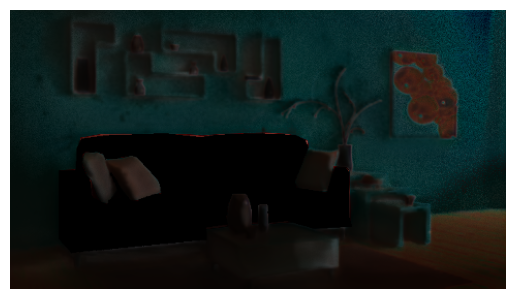

In [ ]:
import imageio
import cv2
re = np.array(imageio.imread('../IndoorLightEditing/Example8/Rendering_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/rendered.hdr'))
bl = np.array(imageio.imread('../IndoorLightEditing/Example8/re_Rendering_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/rendered.hdr'))
plt.imshow(np.abs(re-bl)*(cv2.resize(1-mask, [480,270])))
plt.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 359.5, -0.5)

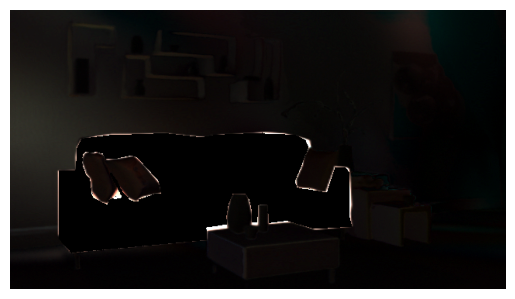

In [ ]:
re = cv2.imread('../IntrinsicImageDiffusion/data/livingroom/result/IID_re.png')[:,:,::-1].astype(np.float32)/255
bl = cv2.imread('../IntrinsicImageDiffusion/data/livingroom/result_edited/IID_bl.png')[:,:,::-1].astype(np.float32)/255
plt.imshow(np.abs(re-bl)*(1-mask)*3)
plt.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 359.5, -0.5)

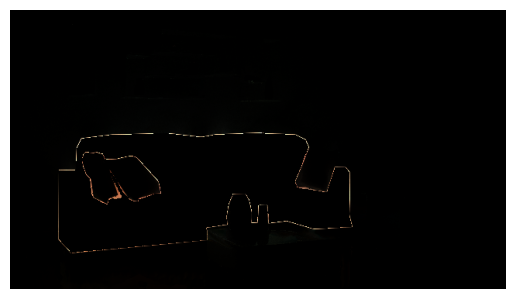

In [ ]:
re = exr2np('../IndoorInverseRendering/lightnet/test/livingroom_2/result_00_output_re.exr', height=360)
bl = exr2np('../IndoorInverseRendering/lightnet/test/livingroom_2/result_00_output.exr', height=360)
plt.imshow(np.abs(re-bl)*(1-mask)*2)
plt.axis('off')

# Colorful obj

In [ ]:
x = exr2np('colorful_obj1/material.exr')

In [ ]:
def build_mesh_from_dir(path):
    depth_np = np.load(path+'/'+path+'_depth_fp32.npy')
    h = depth_np.shape[0]
    w = depth_np.shape[1]
    albedo = exr2np(path+'/albedo.exr',height=h)
    material = exr2np(path+'/material.exr',height=h)
    return build_mesh_2d_metal(depth_np*0.6+0.3, path+'/'+path, albedo.reshape(-1), material, res=[h,w], fov=90, write_ply=True, threshold=0.01, delete_square=False, normal_array=None)

In [ ]:
build_mesh_from_dir('colorful_obj1')

35779


Mesh[
  name = "colorful_obj1/colorful_obj1",
  bbox = BoundingBox3f[
    min = [-0.749707, -0.22787, -0.898828],
    max = [0.487939, 0.661471, -0.3]
  ],
  vertex_count = 307200,
  vertices = [9.38 MiB of vertex data],
  face_count = 576383,
  faces = [6.6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
import numpy as np
cbox_mat = np.zeros([256,256,3],dtype=np.float32)
cbox_mat[:,:,0]=1.0
import os
os.environ['OPENCV_IO_ENABLE_OPENEXR']='1'
import cv2
cv2.imwrite('cbox_gt_mat.exr', cbox_mat)


True

In [ ]:
#np.stack([(1-image[:,:,5].numpy())/2, np.zeros([256,256],dtype=np.float32), np.zeros([256,256],dtype=np.float32)], axis=2)
cv2.imwrite('cbox_gt_depth.exr', np.stack([(1-image[:,:,5].numpy())/2, np.zeros([256,256],dtype=np.float32), np.zeros([256,256],dtype=np.float32)], axis=2)[:,:,::-1])

True

In [ ]:
def check_deletion(z_depth_pos, res=[256,256], fov=90, threshold=0.01, check_dir=False):
    # mesh : H * W * 3
    # modified xy
    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim

    y,x = np.mgrid[(y_dim-1)/(x_dim-1):-(y_dim-1)/(x_dim-1):y_dim*1j, -1:1:x_dim*1j]
    y = y.reshape([-1])
    x = x.reshape([-1])
    z = (-1*z_depth_pos).reshape([-1])

    y_modified = y*np.abs(z)*math.tan(math.radians(fov/2))
    x_modified = x*np.abs(z)*math.tan(math.radians(fov/2))

    vertex_pos = mi.Point3f(x_modified, y_modified, z)

    # face list : 
    # q--p           r
    # | /  x res,  / | x res
    # r           p--q

    p_tmp_1 = np.arange(x_dim*(y_dim-1))
    p_1 = p_tmp_1[p_tmp_1 % x_dim != (x_dim-1)]

    p = np.concatenate([p_1+1, p_1+x_dim])
    q = np.concatenate([p_1, p_1+x_dim+1])
    r = np.concatenate([p_1+x_dim, p_1+1])


    delete_idx = []
    delete_positions = []
    record = [0]*(2*(x_dim-1)*(y_dim-1))

    if not check_dir:
        results = np.empty((y_dim-1, x_dim-1))
        for i in range(2*(x_dim-1)*(y_dim-1)):
            dist1 = ((x_modified[p[i]] - x_modified[q[i]])**2 + (y_modified[p[i]] - y_modified[q[i]])**2 + (z[p[i]] - z[q[i]])**2)**0.5
            dist2 = ((x_modified[q[i]] - x_modified[r[i]])**2 + (y_modified[q[i]] - y_modified[r[i]])**2 + (z[q[i]] - z[r[i]])**2)**0.5
        
            dist = max(dist1,dist2)
            if dist > threshold: #delete mesh
                record[i]=1
            if i >= (x_dim-1)*(y_dim-1):
                results[(i-(x_dim-1)*(y_dim-1))//(x_dim-1),(i-(x_dim-1)*(y_dim-1))%(x_dim-1)] = 2*record[i-(x_dim-1)*(y_dim-1)]+record[i]
        return results
    else:
        results = np.empty((y_dim-1, x_dim-1))
        for i in range((x_dim-1)*(y_dim-1)):
            dist1 = ((x_modified[p[i]] - x_modified[q[i]])**2 + (y_modified[p[i]] - y_modified[q[i]])**2 + (z[p[i]] - z[q[i]])**2)**0.5
            dist2 = ((x_modified[q[i]] - x_modified[r[i]])**2 + (y_modified[q[i]] - y_modified[r[i]])**2 + (z[q[i]] - z[r[i]])**2)**0.5
            dist3 = ((x_modified[p[i+(x_dim-1)*(y_dim-1)]] - x_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[p[i+(x_dim-1)*(y_dim-1)]] - y_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (z[p[i+(x_dim-1)*(y_dim-1)]] - z[q[i+(x_dim-1)*(y_dim-1)]])**2)**0.5
            dist4 = ((x_modified[q[i+(x_dim-1)*(y_dim-1)]] - x_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[q[i+(x_dim-1)*(y_dim-1)]] - y_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (z[q[i+(x_dim-1)*(y_dim-1)]] - z[r[i+(x_dim-1)*(y_dim-1)]])**2)**0.5

            dist = max(dist1,dist2)
            if (dist1 > threshold or dist3 > threshold) and (dist2 > threshold or dist4 > threshold):
                results[(i)//(x_dim-1),(i)%(x_dim-1)] = 3
            elif dist1 > threshold or dist3 > threshold:
                results[(i)//(x_dim-1),(i)%(x_dim-1)] = 2
            elif dist2 > threshold or dist4 > threshold:
                results[(i)//(x_dim-1),(i)%(x_dim-1)] = 1
        return results


In [ ]:
def check_deletion_angle(z_depth_pos, res=[256,256], fov=90, threshold=0.01, th_angle=3 ,check_dir=False):
    # mesh : H * W * 3
    # modified xy
    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim

    y,x = np.mgrid[(y_dim-1)/(x_dim-1):-(y_dim-1)/(x_dim-1):y_dim*1j, -1:1:x_dim*1j]
    y = y.reshape([-1])
    x = x.reshape([-1])
    z = (-1*z_depth_pos).reshape([-1])

    y_modified = y*np.abs(z)*math.tan(math.radians(fov/2))
    x_modified = x*np.abs(z)*math.tan(math.radians(fov/2))

    vertex_pos = mi.Point3f(x_modified, y_modified, z)

    # face list : 
    # q--p           r
    # | /  x res,  / | x res
    # r           p--q

    p_tmp_1 = np.arange(x_dim*(y_dim-1))
    p_1 = p_tmp_1[p_tmp_1 % x_dim != (x_dim-1)]

    p = np.concatenate([p_1+1, p_1+x_dim])
    q = np.concatenate([p_1, p_1+x_dim+1])
    r = np.concatenate([p_1+x_dim, p_1+1])

    delete_idx = []
    delete_positions = []
    record = [0]*(2*(x_dim-1)*(y_dim-1))

    if not check_dir:
        results = np.empty((y_dim-1, x_dim-1))
        for i in range((x_dim-1)*(y_dim-1)):
            p_coord = np.array([x_modified[p[i]], y_modified[p[i]], z[p[i]]])
            q_coord = np.array([x_modified[q[i]], y_modified[q[i]], z[q[i]]])
            r_coord = np.array([x_modified[r[i]], y_modified[r[i]], z[r[i]]])

            v1 = q_coord - r_coord
            v2 = q_coord - p_coord
            n = np.cross(v1, v2)
            n /= np.linalg.norm(n)
            center = (q_coord + r_coord + p_coord) / 3.0
            u = center / np.linalg.norm(center)
            angle = math.degrees(math.asin(abs(np.dot(n, u))))
            if angle < th_angle:
                results[i//(x_dim-1), i%(x_dim-1)] = 1.0
            
            #results[(i-(x_dim-1)*(y_dim-1))//(x_dim-1),(i-(x_dim-1)*(y_dim-1))%(x_dim-1)] = 2*record[i-(x_dim-1)*(y_dim-1)]+record[i]

            # if dist > threshold: #delete mesh
            #     record[i]=1
            # if i >= (x_dim-1)*(y_dim-1):
            #     results[(i-(x_dim-1)*(y_dim-1))//(x_dim-1),(i-(x_dim-1)*(y_dim-1))%(x_dim-1)] = 2*record[i-(x_dim-1)*(y_dim-1)]+record[i]
        return results
    else:
        results = np.empty((y_dim-1, x_dim-1))
        for i in range((x_dim-1)*(y_dim-1)):
            dist1 = ((x_modified[p[i]] - x_modified[q[i]])**2 + (y_modified[p[i]] - y_modified[q[i]])**2 + (z[p[i]] - z[q[i]])**2)**0.5
            dist2 = ((x_modified[q[i]] - x_modified[r[i]])**2 + (y_modified[q[i]] - y_modified[r[i]])**2 + (z[q[i]] - z[r[i]])**2)**0.5
            dist3 = ((x_modified[p[i+(x_dim-1)*(y_dim-1)]] - x_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[p[i+(x_dim-1)*(y_dim-1)]] - y_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (z[p[i+(x_dim-1)*(y_dim-1)]] - z[q[i+(x_dim-1)*(y_dim-1)]])**2)**0.5
            dist4 = ((x_modified[q[i+(x_dim-1)*(y_dim-1)]] - x_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[q[i+(x_dim-1)*(y_dim-1)]] - y_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (z[q[i+(x_dim-1)*(y_dim-1)]] - z[r[i+(x_dim-1)*(y_dim-1)]])**2)**0.5

            dist = max(dist1,dist2)
            if (dist1 > threshold or dist3 > threshold) and (dist2 > threshold or dist4 > threshold):
                results[(i)//(x_dim-1),(i)%(x_dim-1)] = 3
            elif dist1 > threshold or dist3 > threshold:
                results[(i)//(x_dim-1),(i)%(x_dim-1)] = 2
            elif dist2 > threshold or dist4 > threshold:
                results[(i)//(x_dim-1),(i)%(x_dim-1)] = 1

    # if not check_dir:
    #     results = np.empty((y_dim-1, x_dim-1))
    #     for i in range(2*(x_dim-1)*(y_dim-1)):
    #         dist1 = ((x_modified[p[i]] - x_modified[q[i]])**2 + (y_modified[p[i]] - y_modified[q[i]])**2 + (z[p[i]] - z[q[i]])**2)**0.5
    #         dist2 = ((x_modified[q[i]] - x_modified[r[i]])**2 + (y_modified[q[i]] - y_modified[r[i]])**2 + (z[q[i]] - z[r[i]])**2)**0.5
        
    #         dist = max(dist1,dist2)
    #         if dist > threshold: #delete mesh
    #             record[i]=1
    #         if i >= (x_dim-1)*(y_dim-1):
    #             results[(i-(x_dim-1)*(y_dim-1))//(x_dim-1),(i-(x_dim-1)*(y_dim-1))%(x_dim-1)] = 2*record[i-(x_dim-1)*(y_dim-1)]+record[i]
    #     return results
    # else:
    #     results = np.empty((y_dim-1, x_dim-1))
    #     for i in range((x_dim-1)*(y_dim-1)):
    #         dist1 = ((x_modified[p[i]] - x_modified[q[i]])**2 + (y_modified[p[i]] - y_modified[q[i]])**2 + (z[p[i]] - z[q[i]])**2)**0.5
    #         dist2 = ((x_modified[q[i]] - x_modified[r[i]])**2 + (y_modified[q[i]] - y_modified[r[i]])**2 + (z[q[i]] - z[r[i]])**2)**0.5
    #         dist3 = ((x_modified[p[i+(x_dim-1)*(y_dim-1)]] - x_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[p[i+(x_dim-1)*(y_dim-1)]] - y_modified[q[i+(x_dim-1)*(y_dim-1)]])**2 + (z[p[i+(x_dim-1)*(y_dim-1)]] - z[q[i+(x_dim-1)*(y_dim-1)]])**2)**0.5
    #         dist4 = ((x_modified[q[i+(x_dim-1)*(y_dim-1)]] - x_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (y_modified[q[i+(x_dim-1)*(y_dim-1)]] - y_modified[r[i+(x_dim-1)*(y_dim-1)]])**2 + (z[q[i+(x_dim-1)*(y_dim-1)]] - z[r[i+(x_dim-1)*(y_dim-1)]])**2)**0.5

    #         dist = max(dist1,dist2)
    #         if (dist1 > threshold or dist3 > threshold) and (dist2 > threshold or dist4 > threshold):
    #             results[(i)//(x_dim-1),(i)%(x_dim-1)] = 3
    #         elif dist1 > threshold or dist3 > threshold:
    #             results[(i)//(x_dim-1),(i)%(x_dim-1)] = 2
    #         elif dist2 > threshold or dist4 > threshold:
    #             results[(i)//(x_dim-1),(i)%(x_dim-1)] = 1
        return results


In [ ]:
def _pixel_coord_np(width, height):
    '''
    Pixel in homogenous coordinate
    Returns:
        Pixel coordinate:       [3, width * height]
    '''
    x = np.linspace(0, width - 1, width).astype(np.int32)
    y = np.linspace(0, height - 1, height).astype(np.int32)
    [x, y] = np.meshgrid(x, y)
    return np.vstack((x.flatten(), y.flatten(), np.ones_like(x.flatten())))

In [ ]:
_pixel_coord_np(640, 480)

array([[  0,   1,   2, ..., 637, 638, 639],
       [  0,   0,   0, ..., 479, 479, 479],
       [  1,   1,   1, ...,   1,   1,   1]], dtype=int32)

# light test

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'z')

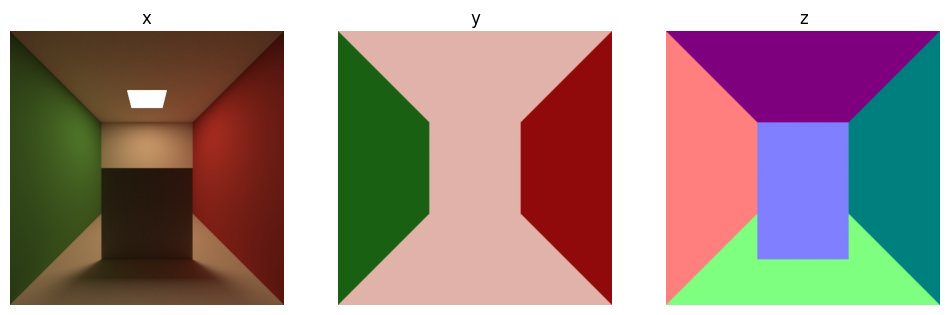

In [ ]:
scene_wall = mi.load_file('scenes/cbox_wall.xml')
image_wall = mi.render(scene_wall, spp=1024)

fig, axs = plt.subplots(1, 3, figsize=(12, 4))
axs[0].imshow(image_wall[:,:,:3]**(1/2.2),cmap='gray');  axs[0].axis('off'); axs[0].set_title('x')
axs[1].imshow(image_wall[:,:,6:9],cmap='gray');  axs[1].axis('off'); axs[1].set_title('y')
axs[2].imshow((image_wall[:,:,9:12].numpy()+1)/2,cmap='gray');  axs[2].axis('off'); axs[2].set_title('z')

In [ ]:
depth_wall = (((-(image_wall[:,:,5].numpy())+1)/2)*2)+1
normal_wall = image_wall[:,:,9:12].numpy()
albedo_1d_wall = image_wall[:,:,6:9].numpy().reshape([-1])

In [ ]:
build_mesh_pixel_face(depth_wall, 'pixel_test_wall', albedo_1d_wall, normal_array=normal_wall, res=[512,512], fov=90)

Mesh[
  name = "pixel_test_wall",
  bbox = BoundingBox3f[
    min = [-0.3344, -0.334375, -1.00004],
    max = [0.334433, 0.334399, -0.333193]
  ],
  vertex_count = 1048576,
  vertices = [24 MiB of vertex data],
  face_count = 524288,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_albedo: 3 floats
  ]
]

In [ ]:
depth_wall_2 = (((-(image_wall[:,:,5].numpy())+1)/2)*0.99)+0.01
mater = np.zeros([512,512,2])
#build_mesh_2d_metal(depth_wall, 'standard_wall', albedo_1d_wall,mater,  res=[512,512], fov=90)

In [ ]:
def build_standard(z_depth_pos, name, res=[256,256], fov=90):
    # mesh : H * W * 3
    # modified xy

    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim

    y,x = np.mgrid[(y_dim-1)/(x_dim-1):-(y_dim-1)/(x_dim-1):y_dim*1j, -1:1:x_dim*1j]
    y = y.reshape([-1])
    x = x.reshape([-1])
    z = (-1*z_depth_pos).reshape([-1])

    y_modified = y*np.abs(z)*math.tan(math.radians(fov/2))
    x_modified = x*np.abs(z)*math.tan(math.radians(fov/2))

    vertex_pos = np.stack([x_modified, y_modified, z], axis=1)
    return vertex_pos
np_standard =  build_standard(depth_wall, 'pixel_test_wall', res=[512,512], fov=90)

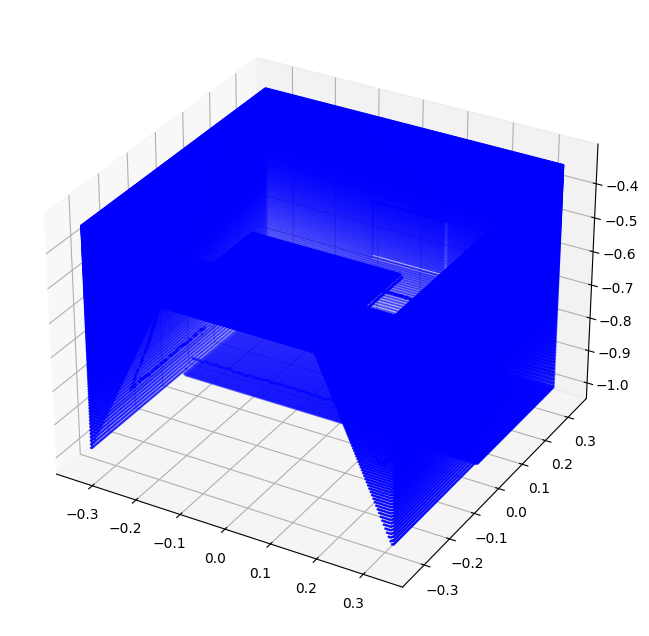

In [ ]:
# matplotlibで可視化
fig = plt.figure(figsize = (8, 8))
ax= fig.add_subplot(111, projection='3d')
ax.scatter(np_standard[:,0],np_standard[:,1],np_standard[:,2], s = 1, c = 'blue')
plt.show()

In [ ]:
def build_pixel(z_depth_pos, name, normal_array=None, res=[256,256], fov=90):
    # mesh : (4*H*W) * 3
    # modified xy

    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    if normal_array is not None and normal_array.ndim > 2:
        normal_array = normal_array.reshape([-1, 3])

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim
    pixel_length = 2 / x_dim # one side length of pixel face

    y_screen,x_screen = np.mgrid[y_dim/x_dim-pixel_length/2 :-y_dim/x_dim+pixel_length/2 :y_dim*1j, -1+pixel_length/2 :1-pixel_length/2:x_dim*1j]
    y_screen = y_screen.reshape([-1])
    x_screen = x_screen.reshape([-1])
    z_screen = -1/math.tan(math.radians(fov/2))*np.ones([N])

    z = (-1*z_depth_pos).reshape([-1])
    y_modified = y_screen * np.abs(z)*math.tan(math.radians(fov/2))
    x_modified = x_screen * np.abs(z)*math.tan(math.radians(fov/2))

    center_pos_screen = np.stack([x_screen, y_screen, z_screen], axis=1)
    center_pos = np.stack([x_modified, y_modified, z], axis=1)
    vertex_pos = np.zeros([4*N,3])
    for i in range(y_dim): # from top to bottom
        for j in range(x_dim): # from left to right
            # p --- q
            # |  c  |
            # s --- r
            c_screen = center_pos_screen[i*x_dim+j,:]
            p_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            q_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            r_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            s_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            n = normal_array[i*x_dim+j,:]
            c = center_pos[i*x_dim+j,:]
            # if np.dot(n,p_screen) < 0.0000001 or np.dot(n,q_screen) < 0.0000001 or np.dot(n,r_screen) < 0.0000001 or np.dot(n,s_screen) < 0.0000001:
            #     print('Normal vector and view vector are nearly orthogonal. (i,j) = ('+str(i)+','+str(j)+')')
            #     return 
            k_p = np.dot(n,c) / np.dot(n,p_screen)
            k_q = np.dot(n,c) / np.dot(n,q_screen)
            k_r = np.dot(n,c) / np.dot(n,r_screen)
            k_s = np.dot(n,c) / np.dot(n,s_screen)

            p = k_p * p_screen
            q = k_q * q_screen
            r = k_r * r_screen
            s = k_s * s_screen
            vertex_pos[4*(i*x_dim+j),:] = p
            vertex_pos[4*(i*x_dim+j)+1,:] = q
            vertex_pos[4*(i*x_dim+j)+2,:] = r
            vertex_pos[4*(i*x_dim+j)+3,:] = s
            #print('p: ', end='')
            #print(vertex_pos[4*(i*x_dim+j),:])
    return center_pos, vertex_pos
np_center, np_vert = build_pixel(depth_wall, 'pixel_test_wall', normal_array=normal_wall, res=[512,512], fov=90)

NameError: name 'depth_wall' is not defined

In [ ]:
# matplotlibで可視化
fig = plt.figure(figsize = (8, 8))
ax= fig.add_subplot(111, projection='3d')
ax.scatter(np_center[:,0],np_center[:,1],np_center[:,2], s = 1, c = 'blue')
plt.show()

In [ ]:
# matplotlibで可視化
fig = plt.figure(figsize = (8, 8))
ax= fig.add_subplot(111, projection='3d')
ax.scatter(np_vert[:,0],np_vert[:,1],np_vert[:,2], s = 1, c = 'blue')
plt.show()

In [ ]:
depth_w = -(image[:,:,5].numpy()  -  2)
depth_w = depth_w / np.max(depth_w)
albedo_1d_w = image[:,:,6].numpy().reshape(-1)



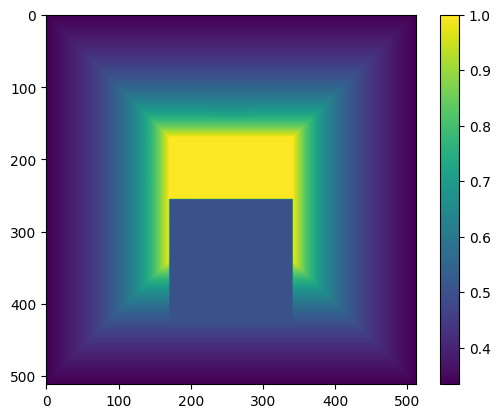

In [ ]:
plt.imshow(depth_w)
plt.colorbar()

In [ ]:
build_mesh_2d_interp(depth_w, 'cbox_wall_interp', albedo_1d_w, res=[512,512], write_ply=True, threshold=0.04, interp=True)

q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
q,r:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p,q:near
p

Mesh[
  name = "cbox_wall_interp",
  bbox = BoundingBox3f[
    min = [-0.423892, -0.382031, -1.3208],
    max = [0.433494, 0.334273, -0.170426]
  ],
  vertex_count = 264357,
  vertices = [6.05 MiB of vertex data],
  face_count = 522242,
  faces = [5.98 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Spot light')

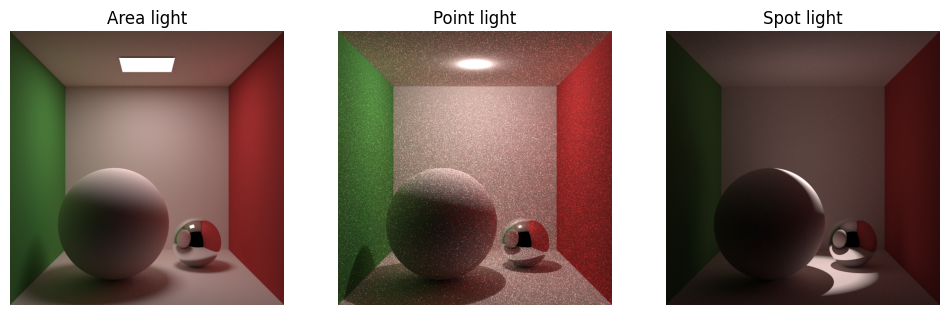

In [ ]:
scene = mi.load_file('scenes/cbox_arealight.xml')
image = mi.render(scene, spp=1024)

scene_pl = mi.load_file('scenes/cbox_pointlight.xml')
image_pl = mi.render(scene_pl, spp=1024)

scene_sl = mi.load_file('scenes/cbox_spotlight.xml')
image_sl = mi.render(scene_sl, spp=1024)
#plt.imshow(image[:,:,:3]**(1/2.2),cmap='gray');  plt.axis('off')



fig, axs = plt.subplots(1, 3, figsize=(12, 4))
axs[0].imshow(image[:,:,:3]**(1/2.2),cmap='gray');  axs[0].axis('off'); axs[0].set_title('Area light')
axs[1].imshow(image_pl[:,:,:3]**(1/2.2),cmap='gray');  axs[1].axis('off'); axs[1].set_title('Point light')
axs[2].imshow(image_sl[:,:,:3]**(1/2.2),cmap='gray');  axs[2].axis('off'); axs[2].set_title('Spot light')

In [ ]:
np.load('/home/michael/yuma/ドキュメント/OmniSR/data/input/normal/input_0.npy')

array([[[-4.34081376e-01,  9.51864272e-02,  8.95819664e-01],
        [-4.45707321e-01,  4.78211232e-02,  8.93889368e-01],
        [-4.18683499e-01,  4.39978726e-02,  9.07054782e-01],
        ...,
        [ 7.73518860e-01,  1.15706295e-01,  6.23105645e-01],
        [ 7.84416139e-01,  8.84731188e-02,  6.13876104e-01],
        [ 7.78672576e-01,  7.67984316e-02,  6.22696519e-01]],

       [[-4.36423361e-01,  4.86867800e-02,  8.98412049e-01],
        [-4.26040828e-01,  3.85170765e-02,  9.03872609e-01],
        [-4.23955858e-01,  3.37964036e-02,  9.05041039e-01],
        ...,
        [ 7.67852604e-01,  9.60873142e-02,  6.33363664e-01],
        [ 7.76427567e-01,  1.05649114e-01,  6.21271670e-01],
        [ 7.76472330e-01,  5.04414812e-02,  6.28113270e-01]],

       [[-4.30460364e-01,  4.90446948e-02,  9.01264906e-01],
        [-4.06623334e-01,  2.22855918e-02,  9.13313091e-01],
        [-4.14063841e-01,  2.60785241e-02,  9.09863174e-01],
        ...,
        [ 7.61229455e-01,  9.68397409e-02,

# end light test

In [ ]:
def load_img(path, to_linear=False):
    img_np = np.array(Image.open(path)).astype(np.float32) / 255
    if to_linear:
        img_np = img_np**(2.2)
    return img_np

In [ ]:
origin_linear = load_img('../OmniSR/data/input/origin/input_0.png', to_linear=True)
noshadow_linear = load_img('../OmniSR/data/result/input_0.png', to_linear=True)

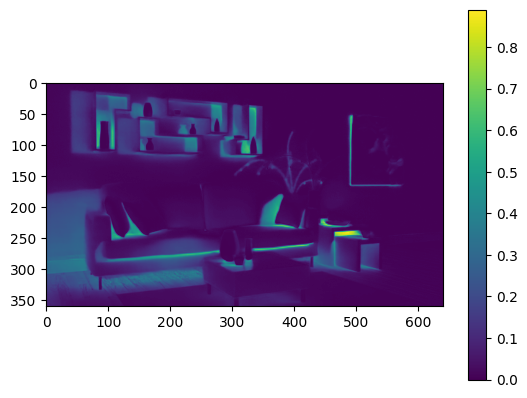

In [ ]:
plt.imshow(np.sqrt(np.sum((origin_linear - noshadow_linear)**2, axis=2)))
plt.colorbar()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 255.5, 255.5, -0.5)

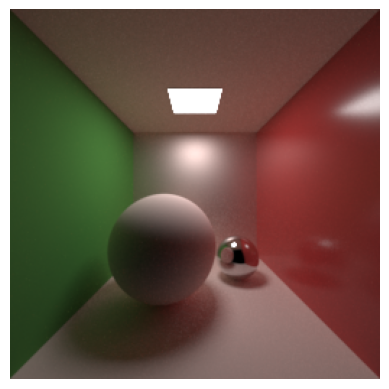

In [ ]:
scene = mi.load_file('scenes/cbox_depth_1230.xml')
image = mi.render(scene, spp=1500)
plt.imshow(image[:,:,:3]**(1/2.2));  plt.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 255.5, 255.5, -0.5)

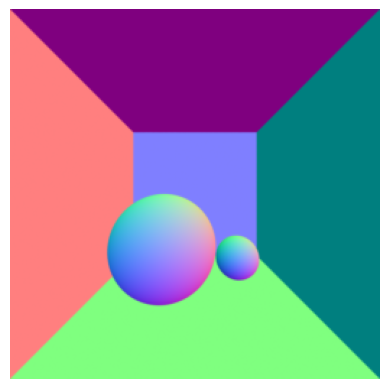

In [ ]:
plt.imshow((image[:,:,9:12].numpy()+1)/2)
plt.axis('off')

In [ ]:
build_mesh_pixel_face_cut(np.abs(image[:,:,5].numpy()-2), 'cbox_normal',albedo_1d_array=np.zeros([256,256,3]) , normal_array=image[:,:,9:12].numpy(), res=[256,256], fov=90, threshold_angle=1)

error num:0
angle error num:0


Mesh[
  name = "cbox_normal",
  bbox = BoundingBox3f[
    min = [-0.335351, -0.335359, -1],
    max = [0.335393, 0.335485, -0.333047]
  ],
  vertex_count = 262144,
  vertices = [6 MiB of vertex data],
  face_count = 131072,
  faces = [1.5 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_albedo: 3 floats
  ]
]

(-0.5, 255.5, 255.5, -0.5)

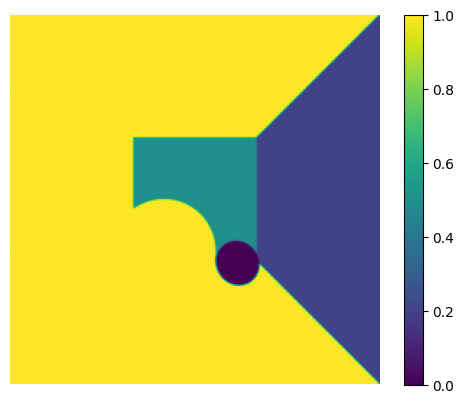

In [ ]:
scene_r = mi.load_file('scenes/cbox_depth_1230_roughness.xml')
plt.imshow(mi.render(scene_r, spp=100)[:,:,6])
plt.colorbar()
plt.axis('off')

(-0.5, 255.5, 255.5, -0.5)

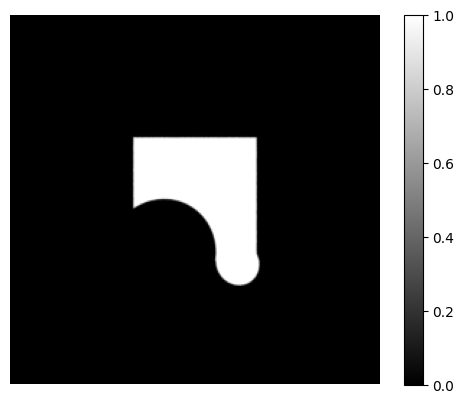

In [ ]:
scene_m = mi.load_file('scenes/cbox_depth_1230_metal.xml')
plt.imshow(mi.render(scene_m, spp=100)[:,:,6], cmap='grey')
plt.colorbar()
plt.axis('off')

(-0.5, 255.5, 255.5, -0.5)

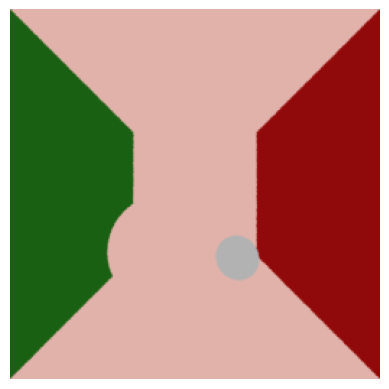

In [ ]:
scene = mi.load_file('scenes/cbox_depth_1230.xml')
image = mi.render(scene, spp=10)

plt.imshow(image[:,:,6:9]); plt.axis('off')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


Text(0.5, 1.0, 'Albedo')

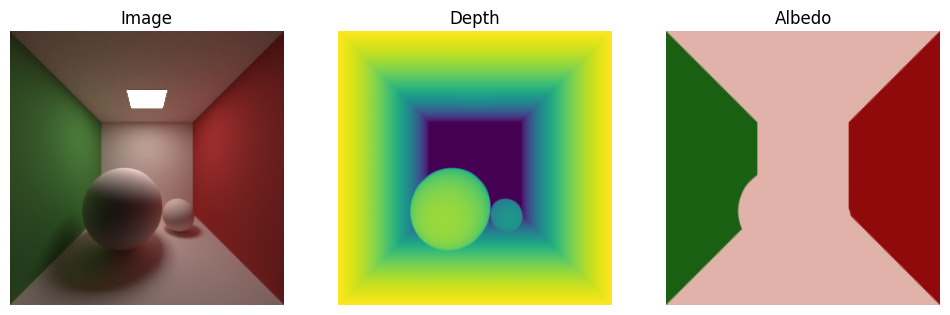

In [ ]:
scene = mi.load_file('scenes/cbox_depth_0110.xml')
image = mi.render(scene, spp=1024)

fig, axs = plt.subplots(1, 3, figsize=(12, 4))
axs[0].imshow(image[:,:,:3]**(1/2.2),cmap='gray');  axs[0].axis('off'); axs[0].set_title('Image')
axs[1].imshow(image[:,:,5]);  axs[1].axis('off'); axs[1].set_title('Depth')
axs[2].imshow(image[:,:,6:9]);  axs[2].axis('off'); axs[2].set_title('Albedo')

In [ ]:
gt_np = exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360)
print(gt_np[:,:,1].max())

0.86663985


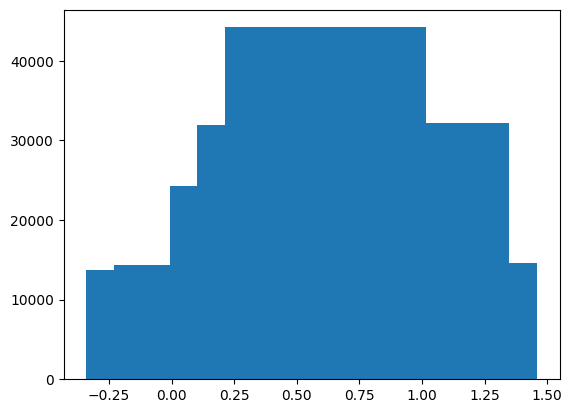

In [ ]:
hist, bin_edge = np.histogram(gt_np[:,:,0].reshape(-1))
bin_center = ((bin_edge + np.roll(bin_edge, -1))/2)[:-1]
 
fig, ax = plt.subplots()
ax.bar(bin_center, hist)
plt.show()

# check envmap

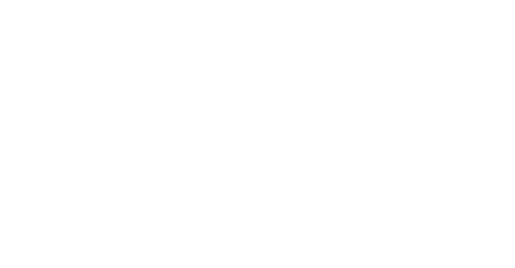

In [ ]:
scene_env = mi.load_dict({
    'type': 'scene',
    'integrator': {'type': 'path', 'max_depth': 6},
    'light': {'type': 'constant',
    'radiance': {
        'type': 'rgb',
        'value': 10.0,
    }},
    #'light' : {'type' :'constant'},
    'sensor': {
        'type': 'perspective',
        'fov': 50,
        'near_clip': 0.01,
        'to_world': mi.ScalarTransform4f.look_at(
            origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
        ),
        'film_id': {
        'type': 'hdrfilm',
        'width': 60,
        'height': 30,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
        },
    },
})

img_env = mi.render(scene_env, spp=5000)

#from matplotlib import pyplot as plt

plt.axis('off')
plt.imshow(mi.util.convert_to_bitmap(img_env))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


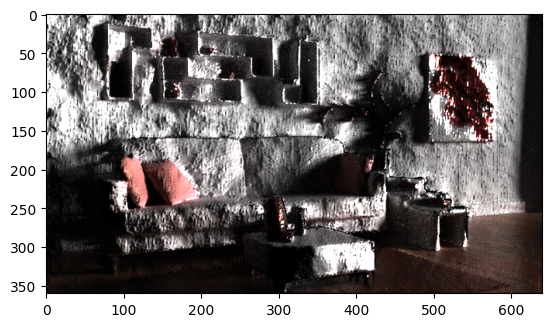

In [ ]:
import os
os.environ['OPENCV_IO_ENABLE_OPENEXR']='1'
import logging
import copy
import my_util_func
import math
import numpy as np
import cv2

mi.set_variant('cuda_ad_rgb')


env_np = np.zeros([60,120], dtype=np.float32)
env_np[24:30,24:30] = 50.0
env_bitmap = mi.Bitmap(env_np)



mesh_loaded = mi.load_dict({
    'type': 'ply',
    #'filename': 'ds_sample.ply',
    'filename': 'livingroom_3.ply',
    #'filename': name+'/'+name+'.ply',
    # 'bsdf': {
    #     'type': 'diffuse',
    #     'reflectance': {
    #         'type': 'mesh_attribute',
    #         'name': 'vertex_albedo',  # This will be used to visualize our attribute
    #     },
    # },
    'bsdf': {
        'type': 'principled',
        'base_color': {
            'type': 'mesh_attribute',
            'name': 'vertex_albedo',
        },
        'metallic': {
            'type': 'mesh_attribute',
            'name': 'vertex_metallic',
        },
        'roughness': {
            'type': 'mesh_attribute',
            'name': 'vertex_roughness',
        },
    },
})

scene_dict = {
    'type': 'scene',
    #'integrator': {'type': 'path', 'max_depth': 6},
    'integrator': { 
        'type': 'aov',
        'aovs': 'dd.y:depth,nn:sh_normal,al:albedo,pp:position',
        'my_image': {
            'type': 'path',
        },
    },
    #'light': {'type': 'point', 'position': [0, 0, 0.1], 'intensity': {'type': 'spectrum', 'value': 1.0,}},
    #'light' : {'type' :'constant'},
    'light' : {'type':'envmap', 'bitmap': env_bitmap},
    'sensor': {
        'type': 'perspective',
        'fov': 50,
        'near_clip': 0.01,
        'to_world': mi.ScalarTransform4f.look_at(
            origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
        ),
        'film_id': {
        'type': 'hdrfilm',
        'width': 640,
        'height': 360,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
        },
    },
    'wholescene': mesh_loaded,
}

#scene_dict['light'] = {'type':'envmap', 'filename': '/home/michael/yuma/ダウンロード/brown_photostudio_02_2k.exr'}

scene = mi.load_dict(scene_dict)
params = mi.traverse(scene)

#opt['light.data'] = params['light.data']

img = mi.render(scene, params, spp=256)
plt.imshow(img[:,:,:3])


In [ ]:
blur = cv2.bilateralFilter(img,9,75,75)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


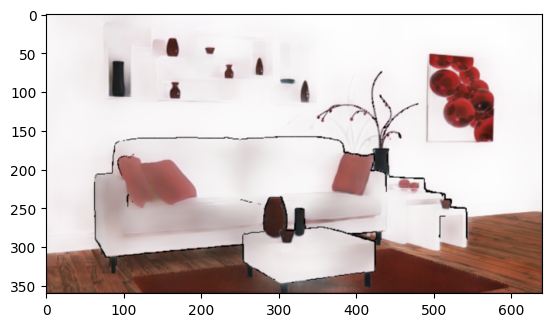

In [ ]:
plt.imshow(img[:,:,7:])

In [ ]:
bbox_min = mesh_loaded.bbox().min
#bbox_max = mesh_loaded.bbox().max

In [ ]:
scene = mi.load_file('living-room-3/living-room-3/scene_nolight.xml')
params = mi.traverse(scene)

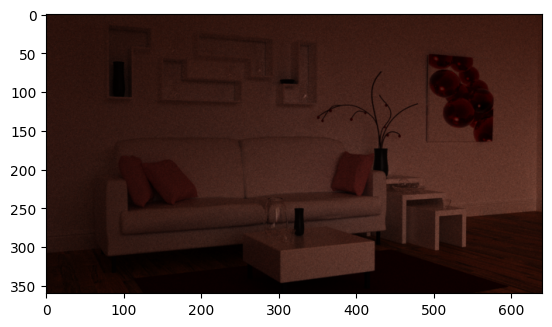

In [ ]:
scene = mi.load_file('living-room-3/living-room-3/scene_envmap.xml')
plt.imshow(mi.render(scene)[:,:,:3])

# Measure MSE

In [ ]:
from PIL import Image
def mse(img, gt_image):
    return np.mean(np.square(img - gt_image))

images_ile = [np.load('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example8/re_Rendering_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/rendered.npy'),
              np.load('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example8/Rendering_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/rendered.npy')]
images_ile = [images_ile[0].squeeze().transpose([1,2,0]).repeat(4,axis=0).repeat(4,axis=1)[::3,::3,:]**(1/2.2), images_ile[1].squeeze().transpose([1,2,0]).repeat(4,axis=0).repeat(4,axis=1)[::3,::3,:]**(1/2.2)]
images_iir = [(exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/lightnet/test/livingroom_2/result_00_output_re.exr',height=360).clip(0,1)**(1/2.2)), 
              (exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/lightnet/test/livingroom_2/result_00_output.exr',height=360).clip(0,1)**(1/2.2))]
images_iid = [np.array(Image.open('/home/michael/yuma/ドキュメント/IntrinsicImageDiffusion/data/livingroom/result/IID_re.png')).astype(np.float32)/255,
              np.array(Image.open('/home/michael/yuma/ドキュメント/IntrinsicImageDiffusion/data/livingroom/result_edited/IID_bl.png')).astype(np.float32)/255 ]
images_ours = [(img_002_two.numpy().clip(0,1))**(1/2.2),
               (img_bl.numpy().clip(0,1))**(1/2.2)]
images_gt = [(exr2np('livingroom_gt.exr', height=360)**(1/2.2)).clip(0,1),
             (exr2np('livingroom_gt_bl.exr', height=360)**(1/2.2)).clip(0,1)]

NameError: name 'exr2np' is not defined

In [ ]:
mi.util.write_bitmap('livingroom_ours_2_bl.exr',img_bl)

In [ ]:
exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/lightnet/test/livingroom_2/result_00_output.exr',height=360)[np.isnan(images_iir[1])]

array([], dtype=float32)

In [ ]:
images_iir[1][np.isnan(images_iir[1])]

array([nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan, nan,
       nan, nan, nan, nan, nan, nan, nan], dtype=float32)

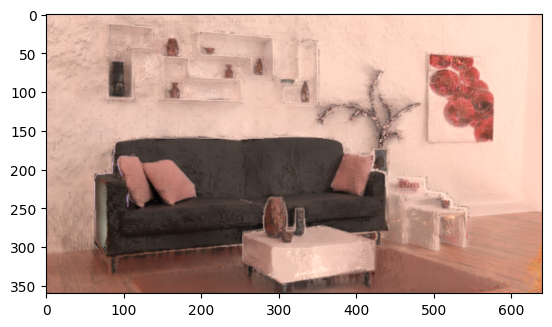

In [ ]:
plt.imshow(images_ours[1])

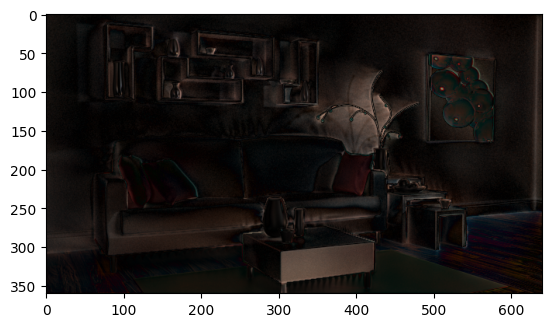

In [ ]:
plt.imshow(np.abs(image_l2[:,:,:3].numpy() - img_002_two.numpy()))

In [ ]:
images_gt_2 = [(image_l2[:,:,:3].numpy().clip(0,1))**(1/2.2),
               (image_l2_b[:,:,:3].numpy().clip(0,1))**(1/2.2)]
for i in range(2):
    print(mse(images_ours[i], images_gt_2[i]))


0.007908314
0.0109920055


In [ ]:
images_gt_2 = [(image_l2[:,:,:3].numpy().clip(0,1))**(1/2.2),
               (image_l2_b[:,:,:3].numpy().clip(0,1))**(1/2.2)]
images_area = [(img_area[:,:,:3].numpy().clip(0,1))**(1/2.2),
               (img_area_bl[:,:,:3].numpy().clip(0,1))**(1/2.2)]
for i in range(2):
    print(mse(images_area[i], images_gt_2[i]))


0.008331652
0.010479577


In [ ]:
for i in range(2):
    gt = images_gt[i] 
    print('ile: ',end=''); print(mse(images_ile[i], gt))
    print('iir: ',end=''); print(mse(images_iir[i], gt))
    print('iid: ',end=''), print(mse(images_iid[i], gt))
    print('ours: ',end=''); print(mse(images_ours[i], gt))

ile: 0.05400891
iir: 0.021388026
iid: 0.011858342
ours: 0.010248402
ile: 0.020030504
iir: 0.029301833
iid: 0.014076468
ours: 0.011574312


# Function to change albedo

In [ ]:
al_new = change_albedo('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example10/BRDFLight_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/albedo.npy', 'scene_2/albedo_mask.png', new_color=[0, 102, 10.455])


In [ ]:
np.load('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example10/BRDFLight_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/albedo.npy')[0,0,0]

array([0.60404956, 0.6081863 , 0.6121981 , 0.6198336 , 0.62800837,
       0.63286686, 0.6353274 , 0.63560224, 0.6355033 , 0.6366744 ,
       0.6373609 , 0.6353384 , 0.6321844 , 0.63034743, 0.62931055,
       0.6285708 , 0.6289064 , 0.62893265, 0.62727374, 0.62563187,
       0.6257157 , 0.6265688 , 0.62645507, 0.62560934, 0.6251737 ,
       0.6251953 , 0.62543476, 0.62577444, 0.62579733, 0.6254998 ,
       0.62538046, 0.6255942 , 0.62598765, 0.626299  , 0.6266084 ,
       0.6269636 , 0.62694085, 0.6268039 , 0.6274713 , 0.6289524 ,
       0.629268  , 0.6278112 , 0.6268361 , 0.6274188 , 0.6280474 ,
       0.62764156, 0.62757593, 0.6281464 , 0.627938  , 0.6276819 ,
       0.62798154, 0.6278302 , 0.6274029 , 0.6271596 , 0.6271266 ,
       0.6274436 , 0.6271453 , 0.6258647 , 0.6254443 , 0.6261839 ,
       0.62612545, 0.625265  , 0.6247712 , 0.62439024, 0.6238363 ,
       0.62311906, 0.62251645, 0.6226069 , 0.6231102 , 0.6232113 ,
       0.6227002 , 0.6223322 , 0.6224521 , 0.6221792 , 0.62172

In [ ]:
np.save('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example10/BRDFLight_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/albedo_changed.npy',(al_new.astype(np.float32)/255)[None,:,:,:].transpose(0,3,1,2))

In [ ]:
np.load('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example9_living/input/depth.npy').shape

(360, 640)

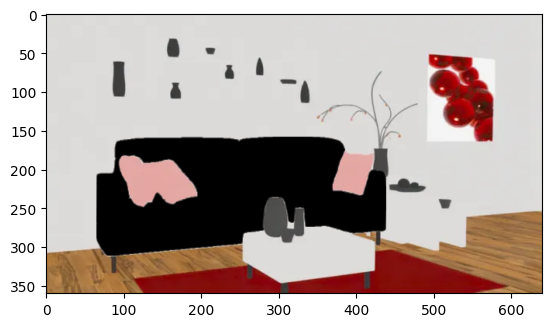

In [ ]:
albedo_bl = change_albedo('/home/michael/yuma/ダウンロード/albedo.png','living-room-3/living-room-3/living_mask2.png')
plt.imshow(albedo_bl)
Image.fromarray(albedo_bl).save('/home/michael/yuma/ダウンロード/albedo_bl.png')

In [ ]:
change_albedo('living-room-3/living-room-3/TungstenRender_360.png','living-room-3/living-room-3/living_mask2.png').dtype

1.0


dtype('float64')

In [ ]:
im = change_albedo('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example9/BRDFLight_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/albedo.png', 'living-room-3/living-room-3/living_mask2.png')
Image.fromarray(im).save('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example9/BRDFLight_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/albedo_changed.png')

In [ ]:
np.save('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example9/BRDFLight_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/albedo_changed.npy', (im[:,:,:,np.newaxis].transpose(3,2,0,1)).astype(np.float32)/255)

5585


Mesh[
  name = "livingroom_depthgt_2_bl",
  bbox = BoundingBox3f[
    min = [-0.295698, -0.123355, -1],
    max = [0.461457, 0.257751, -0.438188]
  ],
  vertex_count = 230400,
  vertices = [7.03 MiB of vertex data],
  face_count = 453217,
  faces = [5.19 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

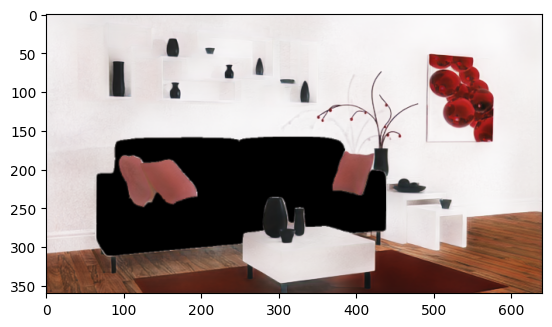

In [ ]:
albedo_bl_0910 = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png')
plt.imshow(albedo_bl_0910)
build_mesh_2d_metal(depth_gt, 'livingroom_depthgt_2_bl', (albedo_bl_0910.astype(np.float32)/255).reshape(-1), mat_l_2, res=[360,640],threshold=0.03, fov=50)

In [ ]:
import imageio
imageio.imwrite('best_env_minusz.exr', np.concatenate((env_np[:,60:,:],env_np[:,:60,:]), axis=1))

In [ ]:
scene = mi.load_dict({
    'type': 'scene',
    'myintegrator': {
        'type': 'aov',
        'aovs': 'dd:position,nn:sh_normal',
        'my_image': {
            'type': 'path',
        }
    },
    'mysensor': {
        'type': 'perspective',
        'fov': 50, 
        'to_world': mi.ScalarTransform4f.look_at(origin=[0, 0, 0],
                                                 target=[0, 0, -1],
                                                 up=[0, 1, 0]),
        'myfilm': {
            'type': 'hdrfilm',
            'rfilter': {
                'type': 'box'
            },
            'width': 60,
            'height': 40,
        }, 
        'mysampler': {
            'type': 'independent',
            'sample_count': 300,
        },
    },
    'myemitter': {
        'type': 'constant'
    },
    'myshape': {
        'type': 'rectangle',
        'material': {
            'type': 'diffuse',
            'reflectance': {
                'type':'rgb',
                'value':[0.8,0,0],
            },
        },
        'to_world': mi.ScalarTransform4f.translate([0, 0, -0.5]).rotate(axis=[0, 1, 0], angle=45)
    }
})

img = mi.render(scene)

In [ ]:
def calculate_angle(a,b,c):
    ab = np.array([b[0] - a[0], b[1] - a[1], b[2] - a[2]])
    ac = np.array([c[0] - a[0], c[1] - a[1], c[2] - a[2]])
    dot_product = ab @ ac
    norm_ab = np.linalg.norm(ab, ord=2)
    norm_ac = np.linalg.norm(ac, ord=2)
    cos = dot_product / (norm_ab*norm_ac)
    angle_rad = math.acos(max(min(cos, 1.0), -1.0))
    return math.degrees(angle_rad)

def min_triangle_angle(p1,p2,p3):
    return min(calculate_angle(p1,p2,p3),calculate_angle(p2,p3,p1),calculate_angle(p3,p1,p2))


def build_mesh_pixel_face_cut(z_depth_pos, name, albedo_1d_array, material_array=None, normal_array=None, res=[256,256], fov=90, write_ply=True, threshold_angle=5):
    # mesh : (4*H*W) * 3
    # modified xy

    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    if albedo_1d_array.ndim != 1:
        albedo_1d_array = albedo_1d_array.reshape([-1])
    
    if normal_array is not None and normal_array.ndim > 2:
        normal_array = normal_array.reshape([-1, 3])

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim
    pixel_length = 2 / x_dim # one side length of pixel face

    y_screen,x_screen = np.mgrid[y_dim/x_dim-pixel_length/2 :-y_dim/x_dim+pixel_length/2 :y_dim*1j, -1+pixel_length/2 :1-pixel_length/2:x_dim*1j]
    y_screen = y_screen.reshape([-1])
    x_screen = x_screen.reshape([-1])
    z_screen = -1/math.tan(math.radians(fov/2))*np.ones([N])

    
    y_modified = y_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))
    x_modified = x_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))

    center_pos_screen = np.stack([x_screen, y_screen, z_screen], axis=1)
    center_pos = np.stack([x_modified, y_modified, (-1*z_depth_pos).reshape([-1])], axis=1)
    vertex_pos = np.zeros([4*N, 3])
    error_num = 0
    angle_error_num = 0
    exception_index = []

    for i in range(y_dim): # from top to bottom
        for j in range(x_dim): # from left to right
            # p --- q
            # |  c  |
            # s --- r
            c_screen = center_pos_screen[i*x_dim+j,:]
            p_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            q_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            r_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            s_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            n = normal_array[i*x_dim+j,:]
            c = center_pos[i*x_dim+j,:]
            # if np.dot(n,p_screen) < 0.0000001 or np.dot(n,q_screen) < 0.0000001 or np.dot(n,r_screen) < 0.0000001 or np.dot(n,s_screen) < 0.0000001:
            #     print('Normal vector and view vector are nearly orthogonal. (i,j) = ('+str(i)+','+str(j)+')')
            #     return 
            k_p = np.dot(n,c) / np.dot(n,p_screen)
            k_q = np.dot(n,c) / np.dot(n,q_screen)
            k_r = np.dot(n,c) / np.dot(n,r_screen)
            k_s = np.dot(n,c) / np.dot(n,s_screen)

            if k_p < 0 or k_q < 0 or k_r < 0 or k_s < 0:
                error_num += 1
                p = 0.2
                q = 0.2
                r = 0.2
                s = 0.2
                exception_index.append(x_dim*i+j)
            else:
                p = k_p * p_screen
                q = k_q * q_screen
                r = k_r * r_screen
                s = k_s * s_screen
                if min_triangle_angle(p,q,s) < threshold_angle or min_triangle_angle(q,r,s) < threshold_angle:
                    angle_error_num += 1
                    p = 0.2
                    q = 0.2
                    r = 0.2
                    s = 0.2
                    exception_index.append(x_dim*i+j)
            
            vertex_pos[4*(i*x_dim+j),:] = p
            vertex_pos[4*(i*x_dim+j)+1,:] = q
            vertex_pos[4*(i*x_dim+j)+2,:] = r
            vertex_pos[4*(i*x_dim+j)+3,:] = s
            #print('p: ', end='')
            #print(vertex_pos[4*(i*x_dim+j),:])
    
    delete_vertex_index = np.array(list(np.arange(4*x,4*x+4) for x in exception_index)).reshape(-1)
    al = np.repeat(albedo_1d_array.reshape([-1,3]), 4, axis=0) # 4N x 3
    rough = np.repeat(material_array[:,:,0].reshape(-1),4) # 4N
    metal = np.repeat(material_array[:,:,1].reshape(-1),4)

    vertex_pos = np.delete(vertex_pos, delete_vertex_index, axis=0)
    al = np.delete(al, delete_vertex_index, axis=0)
    rough = np.delete(rough, delete_vertex_index)
    metal = np.delete(metal, delete_vertex_index)


    # face list : 
    # m--m+1           m+1
    # | /  x N,      /  |   x N
    # m+3          m+3-m+2
    face_ind = np.array(range(N-len(exception_index)))
    faces_1 = np.concatenate([4*face_ind+1, 4*face_ind+2])
    faces_2 = np.concatenate([4*face_ind, 4*face_ind+1])
    faces_3 = np.concatenate([4*face_ind+3, 4*face_ind+3])
    face_indices = mi.Vector3u(faces_1, faces_2, faces_3)
    
    #print(vertex_pos)
    #print(face_indices)
    
    mesh = mi.Mesh(
        name,
        vertex_count=4*(N-len(exception_index)),
        face_count=2*(N-len(exception_index)),
        has_vertex_normals=False,
        has_vertex_texcoords=False,
    )

    mesh_params = mi.traverse(mesh)
    mesh_params['vertex_positions'] = dr.ravel(mi.Point3f(vertex_pos.transpose(1,0)))
    mesh_params['faces'] = dr.ravel(face_indices)
    print('error num:'+str(error_num))
    print('angle error num:'+str(angle_error_num))
    
    # albedo_1d_array : N*3 -> 4*N*3
    mesh.add_attribute('vertex_albedo', 3, al.reshape([-1]))
    #mesh.add_attribute('vertex_albedo', 3, albedo_1d_array)
    if material_array is not None:
        mesh.add_attribute('vertex_roughness', 1, rough)
        mesh.add_attribute('vertex_metallic', 1, metal)
    mesh_params.update()
    if write_ply:
        mesh.write_ply(name+'.ply')
    return mesh


In [ ]:
#[283,67:69,:3]

z_depth_pos = depth_gt
if np.max(z_depth_pos) > 1:
    z_depth_pos /= np.max(z_depth_pos)
normal_array = living_stable_normal_new
normal_array = normal_array.reshape([-1, 3])
fov = 50
y_dim = 360; x_dim = 640 
N = y_dim*x_dim
pixel_length = 2 / x_dim # one side length of pixel face

y_screen,x_screen = np.mgrid[y_dim/x_dim-pixel_length/2 :-y_dim/x_dim+pixel_length/2 :y_dim*1j, -1+pixel_length/2 :1-pixel_length/2:x_dim*1j]
y_screen = y_screen.reshape([-1])
x_screen = x_screen.reshape([-1])
z_screen = -1/math.tan(math.radians(fov/2))*np.ones([N])


y_modified = y_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))
x_modified = x_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))

center_pos_screen = np.stack([x_screen, y_screen, z_screen], axis=1)
center_pos = np.stack([x_modified, y_modified, (-1*z_depth_pos).reshape([-1])], axis=1)
vertex_pos = np.zeros([4*N, 3])
error_num = 0
angle_error_num = 0

i = 283
j = 67
# p --- q
# |  c  |
# s --- r
c_screen = center_pos_screen[i*x_dim+j,:]
p_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
q_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
r_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
s_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
n = normal_array[i*x_dim+j,:]
c = center_pos[i*x_dim+j,:]
# if np.dot(n,p_screen) < 0.0000001 or np.dot(n,q_screen) < 0.0000001 or np.dot(n,r_screen) < 0.0000001 or np.dot(n,s_screen) < 0.0000001:
#     print('Normal vector and view vector are nearly orthogonal. (i,j) = ('+str(i)+','+str(j)+')')
#     return 
k_p = np.dot(n,c) / np.dot(n,p_screen)
k_q = np.dot(n,c) / np.dot(n,q_screen)
k_r = np.dot(n,c) / np.dot(n,r_screen)
k_s = np.dot(n,c) / np.dot(n,s_screen)

p = k_p * p_screen
q = k_q * q_screen
r = k_r * r_screen
s = k_s * s_screen

print('c_screen: ', end='')
print(c_screen)
print('p_screen: ', end='')
print(p_screen)
print('q_screen: ', end='')
print(q_screen)
print('r_screen: ', end='')
print(r_screen)
print('s_screen: ', end='')
print(s_screen)
print('n: ', end='')
print(n)
print('c: ', end='')
print(c)
print('k_p: '+str(k_p))
print('k_q: '+str(k_q))
print('k_r: '+str(k_r))
print('k_s: '+str(k_s))
print('p: ', end='')
print(p)
print('q: ', end='')
print(q)
print('r: ', end='')
print(r)
print('s: ', end='')
print(s)


c_screen: [-0.7890625  -0.3234375  -2.14450692]
p_screen: [-0.790625   -0.325      -2.14450692]
q_screen: [-0.790625   -0.321875   -2.14450692]
r_screen: [-0.7875     -0.321875   -2.14450692]
s_screen: [-0.7875     -0.325      -2.14450692]
n: [-0.92941177 -0.01176471  0.34901965]
c: [-0.21811496 -0.08940554 -0.59279086]
k_p: 0.31775390801233916
k_q: 0.316570560566974
k_r: 0.24460639383398128
k_s: 0.24531228533842428
p: [-0.25122418 -0.10327002 -0.68142545]
q: [-0.2502886  -0.10189615 -0.67888776]
r: [-0.19262754 -0.07873268 -0.5245601 ]
s: [-0.19318342 -0.07972649 -0.52607389]


In [ ]:
np.array([-0.92941177, -0.01176471,  0.34901965]) @ np.array([-0.21811496, -0.08940554, -0.59279086])

-0.003125217192826407

In [ ]:
vert_pos = np.array([[-0.25122418, -0.10327002, -0.68142545],
    [-0.2502886,  -0.10189615, -0.67888776],
    [-0.19262754, -0.07873268, -0.5245601 ],
    [-0.19318342, -0.07972649, -0.52607389]])

faces_1 = np.array([1, 2])
faces_2 = np.array([0, 1])
faces_3 = np.array([3, 3])
face_indices = mi.Vector3u(faces_1, faces_2, faces_3)

#print(vertex_pos)
#print(face_indices)

mesh = mi.Mesh(
    'test',
    vertex_count=4,
    face_count=2,
    has_vertex_normals=False,
    has_vertex_texcoords=False,
)

mesh_params = mi.traverse(mesh)
mesh_params['vertex_positions'] = dr.ravel(mi.Point3f(vert_pos.transpose(1,0)))
mesh_params['faces'] = dr.ravel(face_indices)

# albedo_1d_array : N*3 -> 4*N*3
mesh_params.update()
mesh.write_ply('test.ply')

##  normal check

In [ ]:
import numpy as np
normals_living = np.load('/home/michael/yuma/ダウンロード/livingroom_nograss_normal.npy')

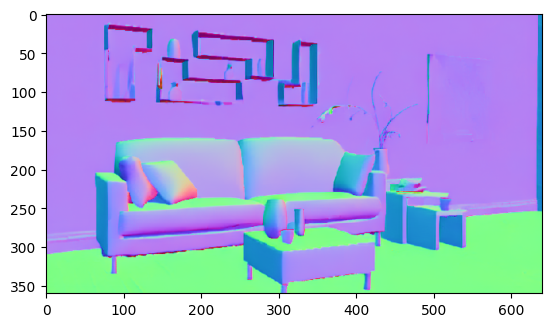

In [ ]:
plt.imshow(normals_living*0.5+0.5)

## end of normal

In [169]:
from PIL import Image
living_stable_normal = Image.open('/home/michael/yuma/ダウンロード/living_normal_image.png').resize((640, 360), Image.BICUBIC)
living_stable_normal_new = np.zeros([360, 640, 3])
living_stable_normal_new[:,:,0] = -1*(((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,0])*2-1)
living_stable_normal_new[:,:,1] = ((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,1])*2-1
living_stable_normal_new[:,:,2] = (((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,2])*2-1)


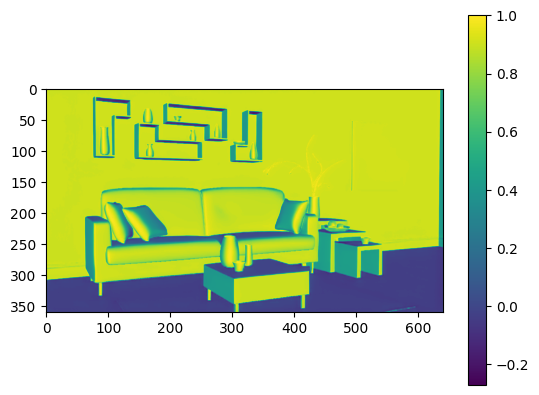

In [ ]:
plt.imshow(living_stable_normal_new[:,:,2])
plt.colorbar()

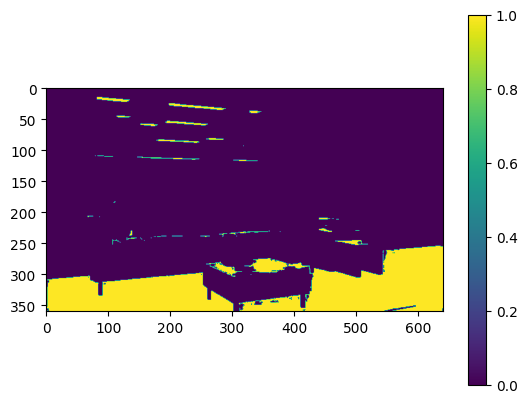

In [ ]:
lsn_z = living_stable_normal_new[:,:,2] 
plt.imshow(lsn_z < 0)
plt.colorbar()

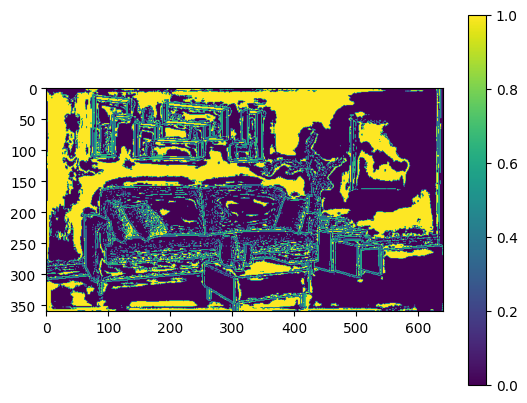

In [ ]:
plt.imshow(np.linalg.norm(living_stable_normal_new,ord=2, axis=2) > 1)
plt.colorbar()

In [ ]:
lsn_z[lsn_z < 0].shape

(36727,)

In [ ]:
build_mesh_pixel_face(depth_gt, 'livingroom_pixelface_12271603',  albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50)

Mesh[
  name = "livingroom_pixelface_12271603",
  bbox = BoundingBox3f[
    min = [-2.24324, -2.56434, -33.5739],
    max = [6.45801, 4.4895, 18.7209]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
build_mesh_pixel_face(depth_gt, 'livingroom_pixelface_01062027',  albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50)

error num:19


Mesh[
  name = "livingroom_pixelface_01062027",
  bbox = BoundingBox3f[
    min = [-0.833354, -1.51666, -33.574],
    max = [6.45803, 4.4895, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
def calculate_angle(a,b,c):
    ab = np.array([b[0] - a[0], b[1] - a[1], b[2] - a[2]])
    ac = np.array([c[0] - a[0], c[1] - a[1], c[2] - a[2]])
    dot_product = ab @ ac
    norm_ab = np.linalg.norm(ab, ord=2)
    norm_ac = np.linalg.norm(ac, ord=2)
    cos = dot_product / (norm_ab*norm_ac)
    angle_rad = math.acos(max(min(cos, 1.0), -1.0))
    return math.degrees(angle_rad)

def min_triangle_angle(p1,p2,p3):
    return min(calculate_angle(p1,p2,p3),calculate_angle(p2,p3,p1),calculate_angle(p3,p1,p2))


def check_normal_face_angle(z_depth_pos, normal_array=None, res=[256,256], fov=90):
    # mesh : (4*H*W) * 3
    # modified xy

    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    if normal_array is not None and normal_array.ndim > 2:
        normal_array = normal_array.reshape([-1, 3])

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim
    pixel_length = 2 / x_dim # one side length of pixel face

    y_screen,x_screen = np.mgrid[y_dim/x_dim-pixel_length/2 :-y_dim/x_dim+pixel_length/2 :y_dim*1j, -1+pixel_length/2 :1-pixel_length/2:x_dim*1j]
    y_screen = y_screen.reshape([-1])
    x_screen = x_screen.reshape([-1])
    z_screen = -1/math.tan(math.radians(fov/2))*np.ones([N])

    
    y_modified = y_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))
    x_modified = x_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))

    center_pos_screen = np.stack([x_screen, y_screen, z_screen], axis=1)
    center_pos = np.stack([x_modified, y_modified, (-1*z_depth_pos).reshape([-1])], axis=1)
    vertex_pos = np.zeros([4*N, 3])
    error_num = 0
    angles = []
    dot_prod = []

    for i in range(y_dim): # from top to bottom
        for j in range(x_dim): # from left to right
            # p --- q
            # |  c  |
            # s --- r
            c_screen = center_pos_screen[i*x_dim+j,:]
            p_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            q_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            r_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            s_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            n = normal_array[i*x_dim+j,:]
            c = center_pos[i*x_dim+j,:]
            dot_prod.append(np.dot(-1*n,c)/ (np.linalg.norm(c,ord=2)*np.linalg.norm(n,ord=2)))
            # if np.dot(n,p_screen) < 0.0000001 or np.dot(n,q_screen) < 0.0000001 or np.dot(n,r_screen) < 0.0000001 or np.dot(n,s_screen) < 0.0000001:
            #     print('Normal vector and view vector are nearly orthogonal. (i,j) = ('+str(i)+','+str(j)+')')
            #     return 
            k_p = np.dot(n,c) / np.dot(n,p_screen)
            k_q = np.dot(n,c) / np.dot(n,q_screen)
            k_r = np.dot(n,c) / np.dot(n,r_screen)
            k_s = np.dot(n,c) / np.dot(n,s_screen)

            if k_p < 0 or k_q < 0 or k_r < 0 or k_s < 0:
                error_num += 1
            else:
                p = k_p * p_screen
                q = k_q * q_screen
                r = k_r * r_screen
                s = k_s * s_screen
                angles.append(min(min_triangle_angle(p,q,s), min_triangle_angle(q,r,s)))
    return angles, dot_prod

In [ ]:
angles, dot_prod = check_normal_face_angle(depth_gt, normal_array=living_stable_normal_new, res=[360,640], fov=50) 

In [ ]:
def show_histogram(np_array, bin_num=10):
    hist, bin_edge = np.histogram(np_array, bins=bin_num)
    bin_center = ((bin_edge + np.roll(bin_edge, -1))/2)[:-1]    
    fig, ax = plt.subplots()
    ax.bar(bin_center, hist)
    plt.show()

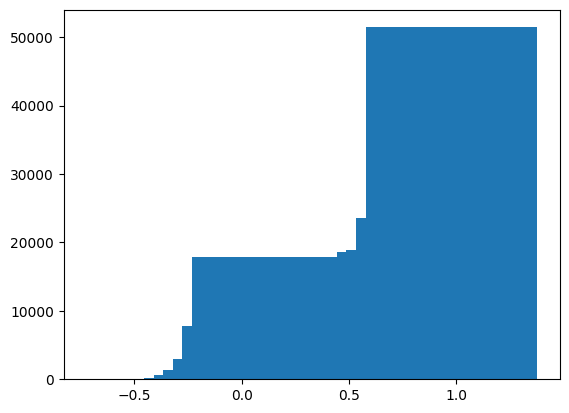

In [ ]:
show_histogram(dot_prod, bin_num=30)

In [ ]:
len(angles)

230381

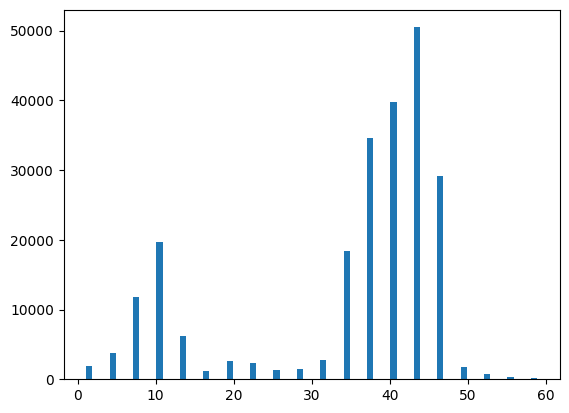

In [ ]:
show_histogram(angles, bin_num=20)

In [ ]:
build_mesh_pixel_face_cut(depth_gt, 'livingroom_pixelface_cut5',  albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50)

error num:19
angle error num:3614


Mesh[
  name = "livingroom_pixelface_cut5",
  bbox = BoundingBox3f[
    min = [-0.295631, -0.12343, -1.00023],
    max = [0.461126, 0.258242, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
build_mesh_pixel_face_cut(depth_gt, 'livingroom_pixelface_cut0_5',  albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=0.5)

error num:19
angle error num:273


Mesh[
  name = "livingroom_pixelface_cut0_5",
  bbox = BoundingBox3f[
    min = [-0.295631, -0.12343, -1.04739],
    max = [0.479629, 0.258242, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

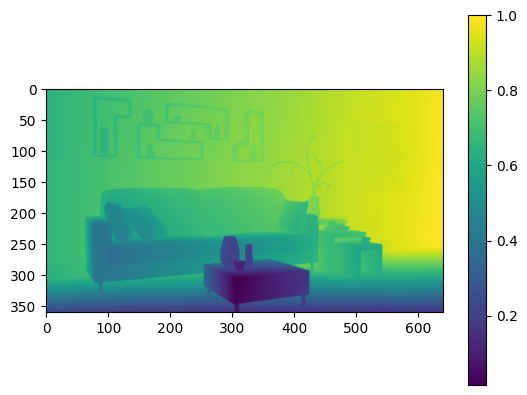

In [171]:
depth_anyv2_raw = (np.load('livingroom_depth.npy')/255)
depth_anyv2_raw = 1 - (depth_anyv2_raw - np.min(depth_anyv2_raw))/np.max(depth_anyv2_raw)

plt.imshow(depth_anyv2_raw)
plt.colorbar()

In [ ]:
np.min(depth_anyv2_raw)

0.03193193

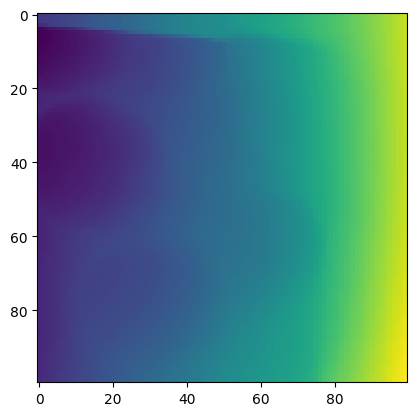

In [ ]:
plt.imshow(depth_anyv2_raw[50:150, 500:600])

In [168]:
depth_anyv2 = 1-(np.array(Image.open('/home/michael/yuma/ダウンロード/living_depthanyv2.png')).astype(np.float32)/255)

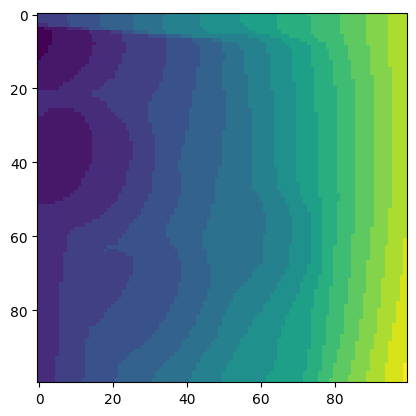

In [ ]:
plt.imshow(depth_anyv2[50:150, 500:600])

In [ ]:
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw',  albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_depthanyv2_raw",
  bbox = BoundingBox3f[
    min = [-0.386374, -0.161421, -1.02839],
    max = [0.473551, 0.260167, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
build_mesh_pixel_face_cut((depth_anyv2*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2',  albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_depthanyv2",
  bbox = BoundingBox3f[
    min = [-0.385759, -0.160716, -1.02868],
    max = [0.473685, 0.260441, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
from PIL import Image
living_stable_normal = Image.open('/home/michael/yuma/ダウンロード/living_normal_image.png').resize((640, 360), Image.BICUBIC)
living_stable_normal_new = np.zeros([360, 640, 3])
living_stable_normal_new[:,:,0] = -1*(((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,0])*2-1)
living_stable_normal_new[:,:,1] = ((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,1])*2-1
living_stable_normal_new[:,:,2] = (((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,2])*2-1)
depth_anyv2_raw = (np.load('livingroom_depth.npy')/255)
depth_anyv2_raw = 1 - (depth_anyv2_raw - np.min(depth_anyv2_raw))/np.max(depth_anyv2_raw)
albedo = exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr',height=360)**(1/2.2)
mat = exr2np('../IndoorInverseRendering/mgnet/livingroom_3/dense_v1/material/0000.exr', height=360)
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_gamma',  albedo.reshape(-1), material_array=mat, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_gamma",
  bbox = BoundingBox3f[
    min = [-0.386374, -0.161421, -1.02839],
    max = [0.473551, 0.260167, -0.507166]
  ],
  vertex_count = 918964,
  vertices = [28 MiB of vertex data],
  face_count = 459482,
  faces = [5.26 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

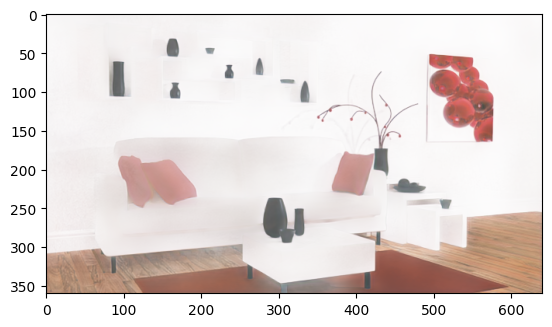

In [ ]:
plt.imshow(albedo)

In [ ]:
albedo_bl[0,0]

array([242, 238, 236], dtype=uint8)

In [ ]:
albedo_bl = (change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png').astype(np.float16)) /255
mat_l_2 = exr2np('../IndoorInverseRendering/mgnet/livingroom_3/dense_v1/material/0000.exr', height=360)
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_bl',  albedo_bl.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_depthanyv2_raw_bl",
  bbox = BoundingBox3f[
    min = [-0.386374, -0.161421, -1.02839],
    max = [0.473551, 0.260167, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
def bilateral_filter(image, size=(5, 5), space_sigma=1, pixel_sigma=0.2, boundary='edge'):
  pad_image = np.pad(image, ((int(size[0] / 2),), (int(size[1] / 2),)), boundary)
  areas = np.lib.stride_tricks.as_strided(pad_image, image.shape + size, pad_image.strides * 2)
  centers = np.tile(image.reshape(image.shape + (1, 1)), (1, 1) + size)
  dists = np.fromfunction(lambda y, x: (x - int(size[1] / 2)) ** 2 + (y - int(size[0] / 2)) ** 2, size)
  weights = np.exp(-dists / (2.0 * space_sigma * space_sigma)) * np.exp(-((centers - areas) ** 2) / (2.0 * pixel_sigma * pixel_sigma * 2.0))
  weight_sum = np.sum(weights, axis=(2, 3))
  return np.einsum('ijkl,ijkl->ij', weights, areas) / weight_sum

depth_anyv2_filtered = bilateral_filter(depth_anyv2)

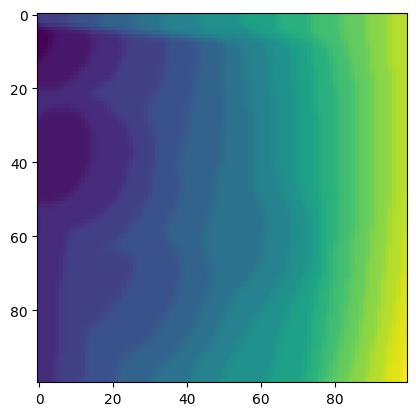

In [ ]:
plt.imshow(depth_anyv2_filtered[50:150, 500:600])

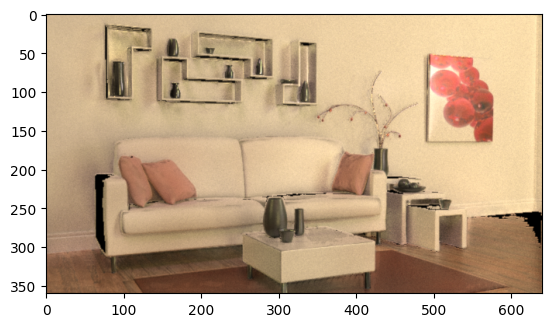

In [ ]:
plt.imshow(mi.util.convert_to_bitmap(render_livingroom_disk('livingroom_pixelface_cut5.ply', spp=500)[:,:,:3]))

In [ ]:
mi.util.write_bitmap('living_env_ours.png',render_livingroom_env('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_light_opt_results/0126_09:20:56',spp=500)[:,:,:3])
mi.util.write_bitmap('living_env_ours_red.png',render_livingroom_env('livingroom_pixelface_cut1_depthanyv2_raw_red.ply', 'livingroom_light_opt_results/0126_09:20:56',spp=500)[:,:,:3])
x = render_livingroom_env('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_light_opt_results/0126_09:20:56',spp=500)[:,:,:3].numpy()
y = render_livingroom_env('livingroom_pixelface_cut1_depthanyv2_raw_red.ply', 'livingroom_light_opt_results/0126_09:20:56',spp=500)[:,:,:3].numpy()

Image.fromarray(((np.clip(np.abs(x-y),0,1) **(1/2.2))*255).astype(np.uint8)).save('env_diff.png')
z = exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360)
Image.fromarray(((np.clip(z+(y-x),0,1) **(1/2.2))*255).astype(np.uint8)).save('env_finalimage.png')

In [ ]:
mi.util.write_bitmap('cornell_env_ours.png',render_livingroom_env('cornell_01112135_albedo_changed.ply', 'cornell_light_opt_results/0126_10:30:05',spp=500,res=[512,512],fov=19.5)[:,:,:3])
mi.util.write_bitmap('cornell_env_ours_red.png',render_livingroom_env('cornell_01112135.ply', 'cornell_light_opt_results/0126_10:30:05',spp=500,res=[512,512],fov=19.5)[:,:,:3])
x = render_livingroom_env('cornell_01112135.ply', 'cornell_light_opt_results/0126_10:30:05',spp=500,res=[512,512],fov=19.5)[:,:,:3].numpy()
y = render_livingroom_env('cornell_01112135_albedo_changed.ply', 'cornell_light_opt_results/0126_10:30:05',spp=500,res=[512,512],fov=19.5)[:,:,:3].numpy()

Image.fromarray(((np.clip(np.abs(x-y),0,1) **(1/2.2))*255).astype(np.uint8)).save('env_cornell_diff.png')
z = exr2np('cornell-box/cornellbox.exr', height=512)
Image.fromarray(((np.clip(z+(y-x),0,1) **(1/2.2))*255).astype(np.uint8)).save('env_cornell_finalimage.png')

In [ ]:
x = render_livingroom_disk('cornell_01112135.ply', 'cornell_arealight_opt_disk_results/bestvalue_0112_02:31:19',spp=500,res=[512,512],fov=19.5)[:,:,:3].numpy()
y = render_livingroom_disk('cornell_01112135_albedo_changed.ply', 'cornell_arealight_opt_disk_results/bestvalue_0112_02:31:19',spp=500,res=[512,512],fov=19.5)[:,:,:3].numpy()

Image.fromarray(((np.clip(np.abs(x-y),0,1) **(1/2.2))*255).astype(np.uint8)).save('cornell_diff_ours.png')

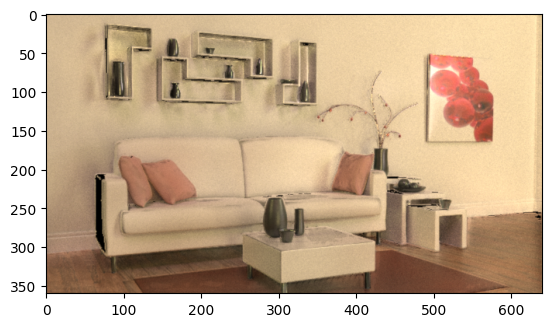

In [ ]:
plt.imshow(mi.util.convert_to_bitmap(render_livingroom_disk('livingroom_pixelface_cut3.ply', spp=500)[:,:,:3]))

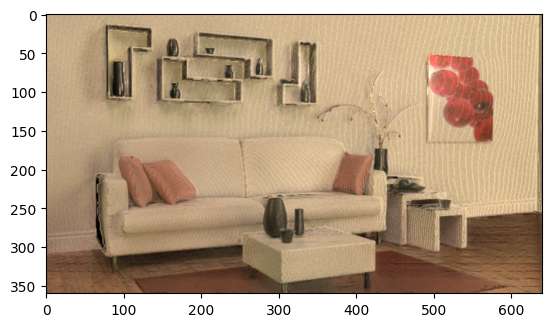

In [ ]:
plt.imshow(mi.util.convert_to_bitmap(render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2.ply', spp=500)[:,:,:3]))

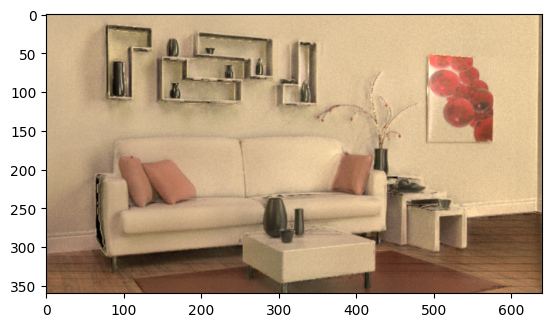

In [ ]:
plt.imshow(mi.util.convert_to_bitmap(render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', spp=500)[:,:,:3]))

In [ ]:
plt.imshow(mi.util.convert_to_bitmap(render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', spp=500)[:,:,:3]))

In [ ]:
params = mi.traverse(scene)

In [ ]:
mesh_loaded.vertex_normal

<bound method PyCapsule.vertex_normal of PLYMesh[
  name = "livingroom_3.ply",
  bbox = BoundingBox3f[
    min = [-0.246383, -0.101543, -0.9],
    max = [0.419677, 0.235781, -0.3]
  ],
  vertex_count = 230400,
  vertices = [9.67 MiB of vertex data],
  face_count = 453958,
  faces = [5.2 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_albedo: 3 floats,
    vertex_roughness: 1 float,
    vertex_metallic: 1 float
  ]
]>

(-0.5, 639.5, 359.5, -0.5)

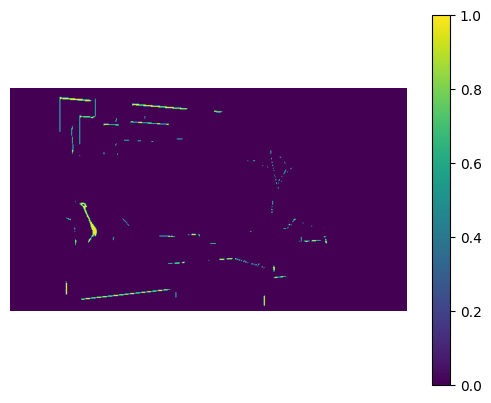

In [ ]:
plt.imshow(img[:,:,6] < 0)
plt.colorbar()
plt.axis('off')

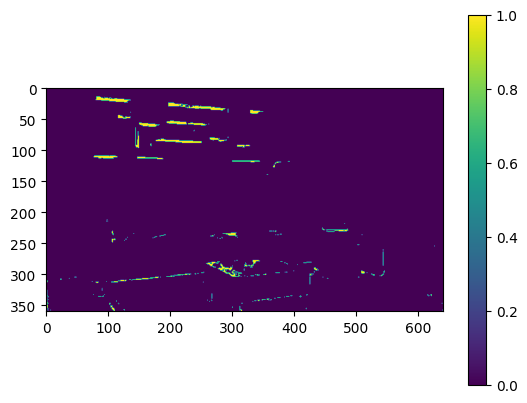

In [ ]:
#normals_living[:,:,0] = normals_living[:,:,0] 
plt.imshow(normals_living[:,:,2] < 0)
plt.colorbar()

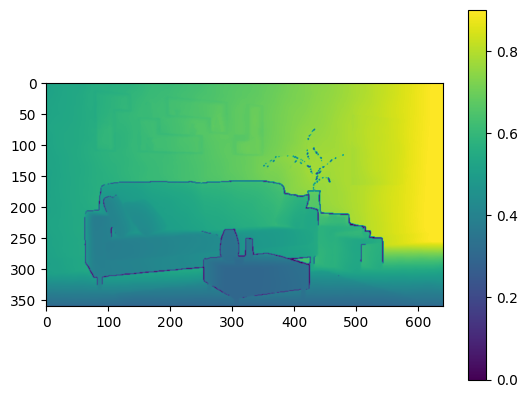

In [ ]:
plt.imshow(-1*img[:,:,9])
plt.colorbar()

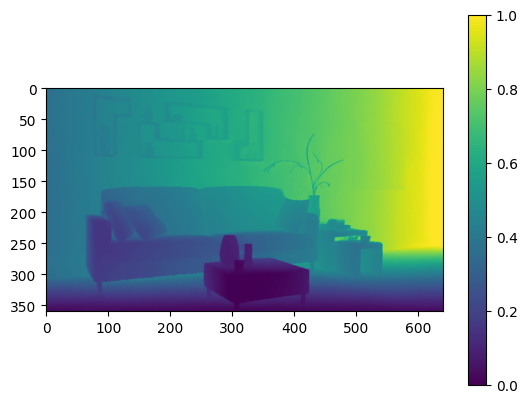

In [ ]:
plt.imshow(depth_living)
plt.colorbar()

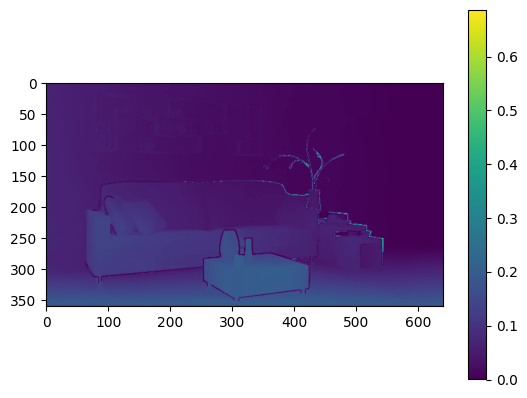

In [ ]:
plt.imshow((depth_living - (-1*img[:,:,9].numpy()))**2)
plt.colorbar()

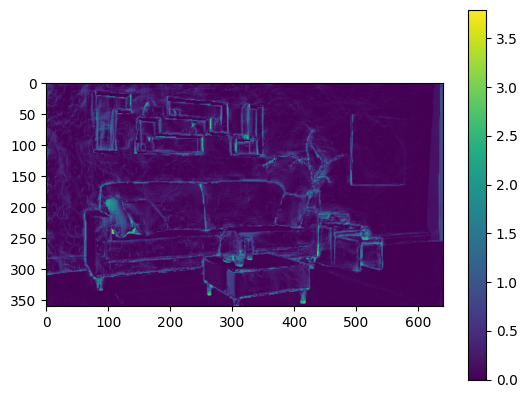

In [ ]:
plt.imshow(np.sum((((normals_living[:,:,2] > 0).reshape([360,640,1]))*(normals_living - img[:,:,4:7].numpy()) )**2, axis=2))
plt.colorbar()

In [ ]:
plt.imshow((((normals_living[:,:,2] > 0).reshape([360,640,1])*normals_living) - ((img[:,:,6].numpy() > 0).reshape([360,640,1])*img[:,:,4:].numpy()))**2)

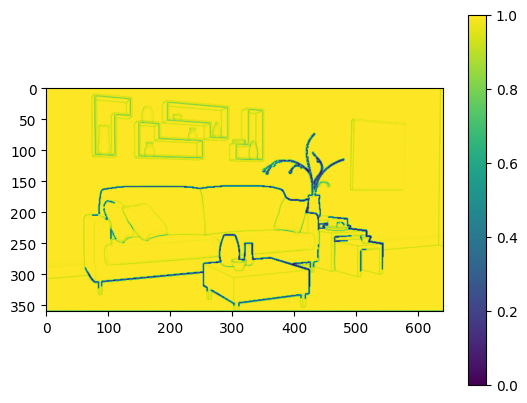

In [ ]:
normal_norm = (img[:,:,4].numpy())**2+(img[:,:,5].numpy())**2+(img[:,:,6].numpy())**2
plt.imshow(normal_norm)
plt.colorbar()

In [ ]:
plt.imshow((mi.render(scene, params, spp=128)[:,:,:3])**(1/2.2))

In [ ]:
mesh_result = [m for m in scene.shapes() if m.id() == 'wholescene'][0]
mesh_result.write_ply('livingroom_3_normal_optimised.ply')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


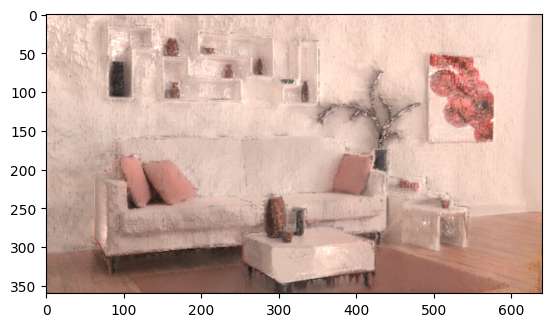

In [ ]:
plt.imshow(render_livingroom('livingroom_3.ply',env_path='livingroom_light_opt_results/0910_00:26:04/best_env.exr',scale=1.4620638)**(1/2.2))

# Rendering scene 2

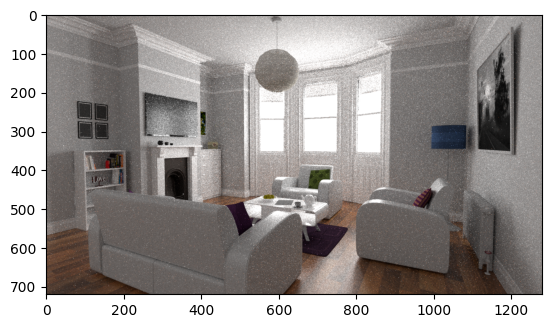

In [ ]:
scene = mi.load_file('living-room-2/scene.xml')
image = mi.render(scene, spp=50)
plt.imshow(mi.util.convert_to_bitmap(image[:,:,:3]))

In [ ]:
from mitsuba import ScalarTransform4f as T
T_default = T([[-0.900688, -0.0159147, -0.434176, 2.25009], 
[0, 0.999329, -0.0366305, 1.31171], 
[0.434467, -0.0329926, -0.900083, 6.17872], 
[0, 0, 0, 1]])
 

def render_2(trans):
    sensor_2 = mi.load_dict({
        'type':'perspective',
        'fov':60,
        #'to_world': trans @ T_default,
        'sampler':{
            'type':'independent',
            'sample_count':50,
        },
        'film':{
            'type':'hdrfilm',
            'width':1280,
            'height':720,
            'rfilter':{
                'type':'tent',
            },
            'pixel_format':'rgb',
        }
    })
    return mi.render(scene, sensor=sensor_2)

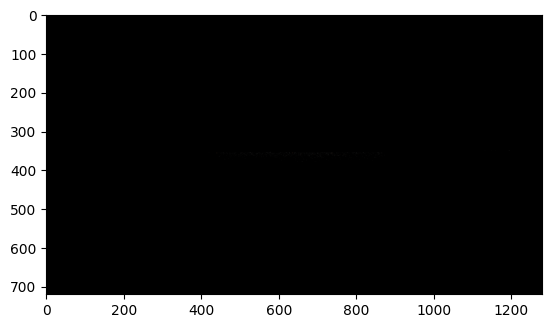

In [ ]:
plt.imshow(mi.util.convert_to_bitmap(render_2(T().translate([-1.5,-0.5,-1.9]))[:,:,:3]))

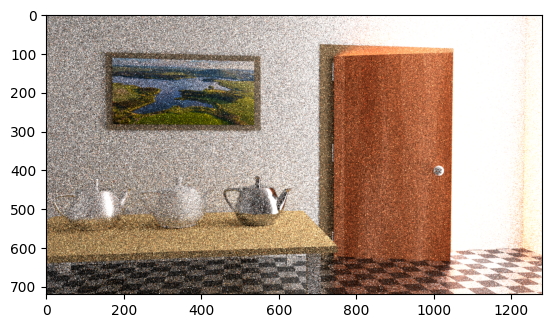

In [ ]:
scene = mi.load_file('veach-ajar/scene.xml')
image = mi.render(scene, spp=50)
plt.imshow(mi.util.convert_to_bitmap(image[:,:,:3]))

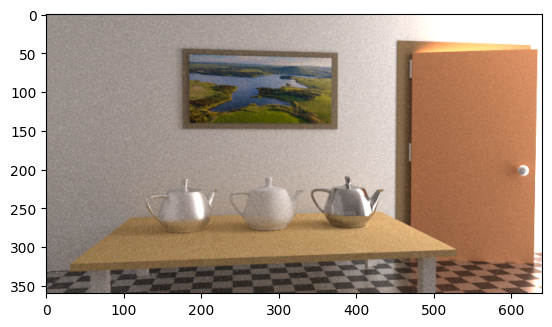

In [ ]:
scene = mi.load_file('veach-ajar/scene.xml')
image = mi.render(scene, spp=7000)
plt.imshow(mi.util.convert_to_bitmap(image[:,:,:3]))

In [ ]:
mi.util.write_bitmap('veach-ajar/veach-ajar.png', image[:,:,:3])

In [ ]:
mi.Transform4f().translate([0,0,-1]) @ mi.Transform4f([[-0.137283, -0.0319925, -0.990015, 4.05402], [2.71355e-008, 0.999478, -0.0322983, 1.61647], [0.990532, -0.00443408, -h0.137213, -2.30652], [0, 0, 0, 1]])

Transform[
  matrix=[[[-0.137283, -0.0319925, -0.990015, 4.05402],
           [2.71355e-08, 0.999478, -0.0322983, 1.61647],
           [0.990532, -0.00443408, -0.137213, -3.30652],
           [0, 0, 0, 1]]],
  inverse_transpose=[[[-0.137285, -0.0319925, -0.990015, 0],
                      [1.83061e-08, 0.999479, -0.0322983, 0],
                      [0.990532, -0.00443404, -0.137211, 0],
                      [3.83177, -1.50059, 3.61206, 1]]]
]

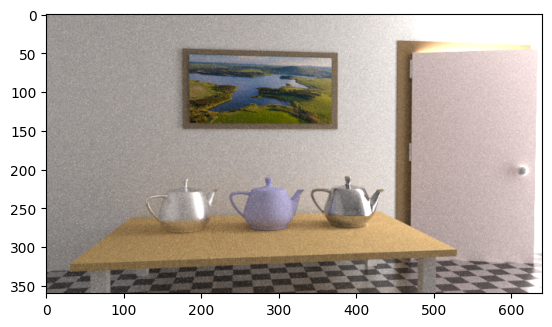

In [ ]:
scene = mi.load_file('veach-ajar/scene_edited.xml')
image = mi.render(scene, spp=6000)
plt.imshow(mi.util.convert_to_bitmap(image[:,:,:3]))

# scene2_2

In [ ]:
al_scene2 = exr2np('../IndoorInverseRendering/mgnet/scene2/dense_v1/albedo/0000.exr', height=360)
mat_scene2 = exr2np('../IndoorInverseRendering/mgnet/scene2/dense_v1/material/0000.exr', height=360)
depth_scene2 = np.load('/home/michael/yuma/ダウンロード/scene_depth.npy')
from PIL import Image
scene2_normal = Image.open('/home/michael/yuma/ダウンロード/scene2_2_normal.png').resize((640, 360), Image.BICUBIC)
scene2_normal_new = np.zeros([360, 640, 3])
scene2_normal_new[:,:,0] = -1*(((np.array(scene2_normal).astype(np.float32) / 255)[:,:,0])*2-1)
scene2_normal_new[:,:,1] = ((np.array(scene2_normal).astype(np.float32) / 255)[:,:,1])*2-1
scene2_normal_new[:,:,2] = (((np.array(scene2_normal).astype(np.float32) / 255)[:,:,2])*2-1)

build_mesh_pixel_face_cut(depth_scene2*0.5+0.5, 'scene2_2_01101708',  al_scene2.reshape(-1), material_array=mat_scene2, normal_array=scene2_normal_new, res=[360,640], fov=40, threshold_angle=1)

error num:0
angle error num:2


Mesh[
  name = "scene2_2_01101708",
  bbox = BoundingBox3f[
    min = [-0.36405, -0.105346, -1.00022],
    max = [0.335662, 0.2, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
al_scene2 = exr2np('../IndoorInverseRendering/mgnet/scene2/dense_v1/albedo/0000.exr', height=360)
mat_scene2 = exr2np('../IndoorInverseRendering/mgnet/scene2/dense_v1/material/0000.exr', height=360)
depth_scene2 = np.load('/home/michael/yuma/ダウンロード/scene_depth.npy')
from PIL import Image
scene2_normal = Image.open('/home/michael/yuma/ダウンロード/scene2_2_normal.png').resize((640, 360), Image.BICUBIC)
scene2_normal_new = np.zeros([360, 640, 3])
scene2_normal_new[:,:,0] = -1*(((np.array(scene2_normal).astype(np.float32) / 255)[:,:,0])*2-1)
scene2_normal_new[:,:,1] = ((np.array(scene2_normal).astype(np.float32) / 255)[:,:,1])*2-1
scene2_normal_new[:,:,2] = (((np.array(scene2_normal).astype(np.float32) / 255)[:,:,2])*2-1)

build_mesh_pixel_face_cut(depth_scene2*0.5+0.5, 'scene2_2_01101708',  al_scene2.reshape(-1), material_array=mat_scene2, normal_array=scene2_normal_new, res=[360,640], fov=40, threshold_angle=1)

# IPSJ measure

In [ ]:
img_ours = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()
img_ours_bl = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_bl.ply', 'livingroom_arealight_opt_disk_results/0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()

In [ ]:
render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/0109_23:15:50', twosided=True, spp=2000)[:,:,:3]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


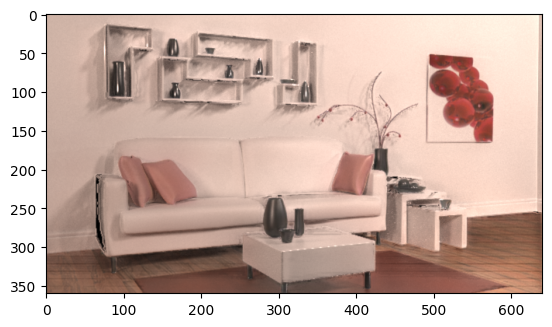

In [ ]:
plt.imshow(img_ours**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


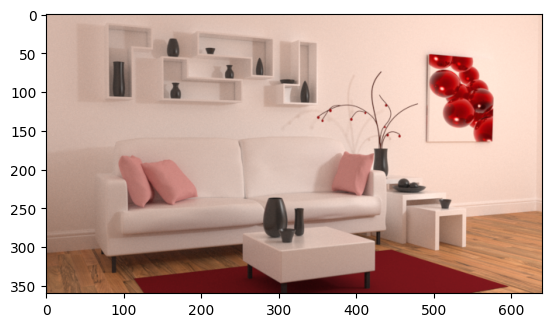

In [ ]:
plt.imshow(exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360)**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


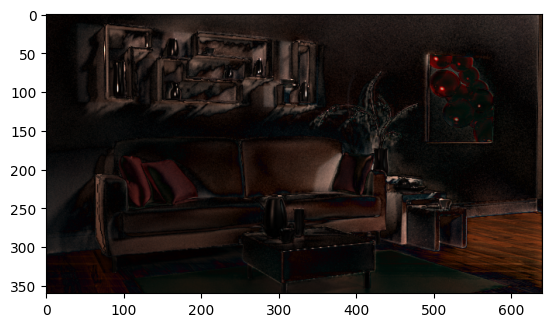

In [ ]:
plt.imshow(np.abs(img_ours-exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360) ))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


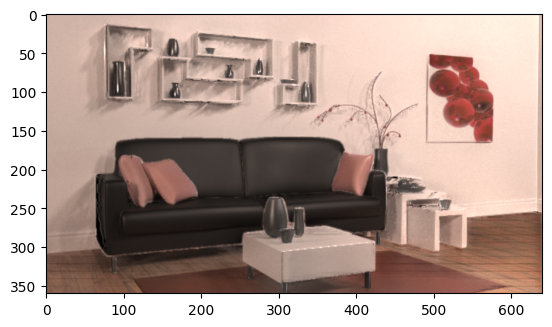

In [ ]:
plt.imshow(img_ours_bl**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


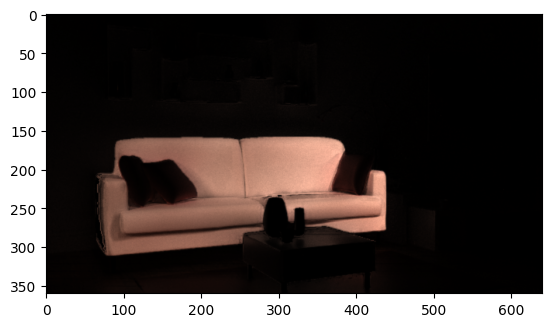

In [ ]:
plt.imshow(np.abs(img_ours_bl - img_ours))

In [ ]:
image = exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360)
image_edited = image+(img_ours_bl - img_ours)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


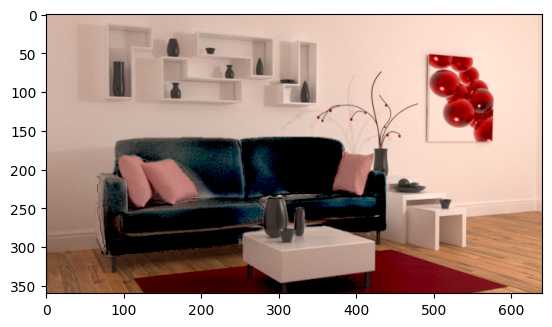

In [ ]:
plt.imshow(np.clip(image_edited, 0, None)**(1/2.2))

In [ ]:
plt.imshow(np.clip(image_edited, 0, None)**(1/2.2)[150:200, 200:300, :])

In [ ]:
import numpy as np
np.load('/home/michael/yuma/ドキュメント/IndoorLightEditing/Example9_living2/BRDFLight_size0.200_int0.001_dir1.000_lam0.001_ren1.000_visWin120000_visLamp119540_invWin200000_invLamp150000_optimize/albedo.npy')

array([[[[0.81788844, 0.8298532 , 0.8444977 , ..., 0.87574846,
          0.8700074 , 0.8629316 ],
         [0.8364623 , 0.84542406, 0.8549745 , ..., 0.88526285,
          0.87965864, 0.8741033 ],
         [0.8522641 , 0.85850966, 0.863534  , ..., 0.89242125,
          0.88792723, 0.88440454],
         ...,
         [0.29805648, 0.31804556, 0.35219264, ..., 0.3440534 ,
          0.3591753 , 0.36667818],
         [0.27861607, 0.30814132, 0.3521128 , ..., 0.31058577,
          0.32651797, 0.3385974 ],
         [0.27395755, 0.30416155, 0.34957656, ..., 0.30085042,
          0.31408796, 0.3257978 ]],

        [[0.75115275, 0.76514834, 0.78458524, ..., 0.7821006 ,
          0.7672075 , 0.75242114],
         [0.7687281 , 0.7793029 , 0.79344136, ..., 0.79893404,
          0.78571945, 0.77396685],
         [0.78478914, 0.79200184, 0.80068344, ..., 0.8163191 ,
          0.8073026 , 0.80057925],
         ...,
         [0.15385586, 0.16079807, 0.18339084, ..., 0.15764192,
          0.1615107 , 0.1

In [ ]:
Image.fromarray(change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', (200,0,0))).save('albedo_living_ours_red.png')

NameError: name 'change_albedo' is not defined

In [ ]:
albedo_red = (change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', (200,0,0)).astype(np.float16)) /255
mat_l_2 = exr2np('../IndoorInverseRendering/mgnet/livingroom_3/dense_v1/material/0000.exr', height=360)
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_red',  albedo_red.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_depthanyv2_raw_red",
  bbox = BoundingBox3f[
    min = [-0.386374, -0.161421, -1.02839],
    max = [0.473551, 0.260167, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
x = np.array([[1,2,3],[1,2,3],[1,2,3]])
x[np.array([5,4,5]) == 4]

array([[1, 2, 3]])

In [ ]:
mat_np = exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/material/0000.exr',height=360)
mask_np = np.array(Image.open('living-room-3/living-room-3/living_mask2.png').convert('L')).astype(np.float32)/255
print(np.sum(mask_np == 1))
mat_np[mask_np == 1.0, 0]

36355


array([0.4821557 , 0.47965434, 0.47831586, ..., 0.49395582, 0.4946127 ,
       0.49428895], dtype=float32)

In [ ]:
indices = np.where(mask_np==1)
mat_np[indices[0],indices[1],0] = 1.0

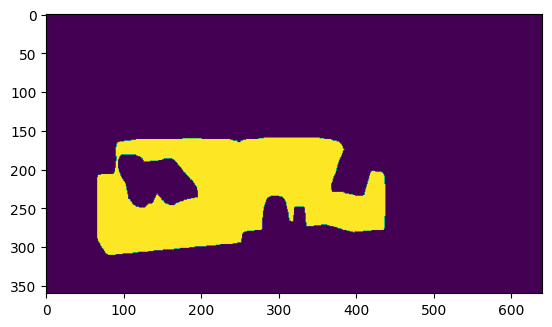

In [ ]:
plt.imshow(mask_np == 1)

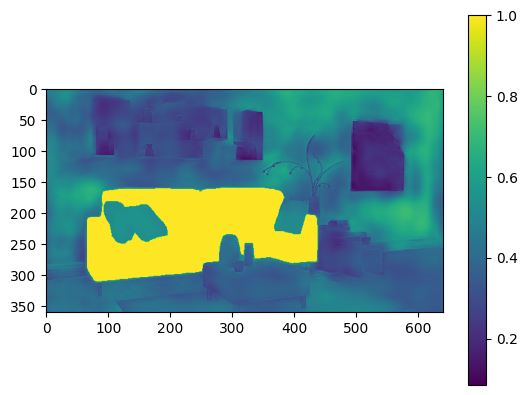

In [ ]:
plt.imshow(mat_np[:,:,0])
plt.colorbar()

In [ ]:
albedo_bl = (change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png').astype(np.float16)) /255
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_rough0',  albedo_bl.reshape(-1), material_array=mat_np, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_depthanyv2_raw_rough0",
  bbox = BoundingBox3f[
    min = [-0.386374, -0.161421, -1.02839],
    max = [0.473551, 0.260167, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


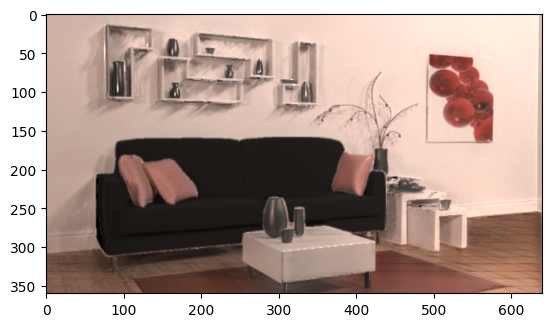

In [ ]:
plt.imshow(((render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_rough0.ply', 'livingroom_arealight_opt_disk_results/0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy())**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


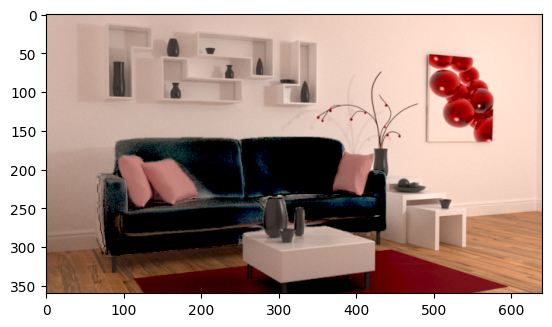

In [ ]:
img_rough1 = ((render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_rough0.ply', 'livingroom_arealight_opt_disk_results/0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy())
plt.imshow(np.clip(image+(img_rough1 - img_ours), 0, None)**(1/2.2))
livingroom_pixelface_cut1_depthanyv2_raw.ply

In [ ]:
image_red = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_red.ply', 'livingroom_arealight_opt_disk_results/0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()
plt.imshow(image_red**(1/2.2))

In [ ]:
mi.util.write_bitmap('rendered_ours_edited.png', render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_red.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3])

In [ ]:
mi.util.write_bitmap('rendered_ours.png', render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3])

In [ ]:
img_ours = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()
image_red = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_red.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()
image = exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360)
#Image.fromarray(((np.clip(img_ours,0,1)**(1/2.2))*255).astype(np.uint8)).save('rendered_ours.png')

In [ ]:
from PIL import Image
image_final = np.clip(image+(image_red-img_ours),0,1)
Image.fromarray((image_final**(1/2.2)*255).astype(np.uint8)).save('finalimage_ours.png')

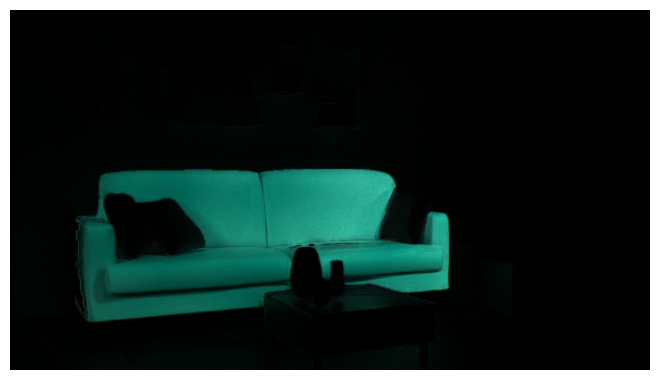

In [ ]:
plt.imshow(np.abs(image_red-img_ours))
plt.axis('off')
plt.subplots_adjust(left=0,right=1,top=1,bottom=0)
plt.savefig('diff_living_ours.png')

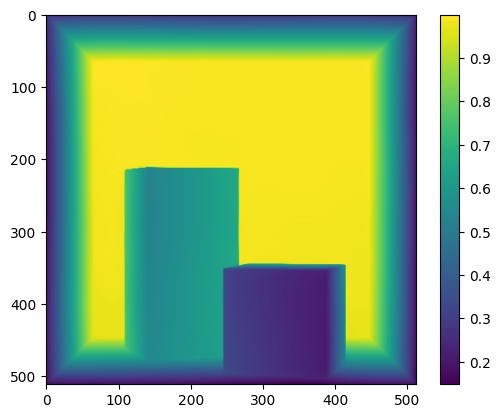

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
depth = np.load('cornell_depth.npy')[::2,::2]
plt.imshow(depth)
plt.colorbar()

In [ ]:
np.max(depth)


0.9999978

/tmp/ipykernel_2006105/2319724726.py:1: RuntimeWarning: invalid value encountered in power
  plt.imshow((image+(image_red-img_ours))**(1/2.2))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 359.5, -0.5)

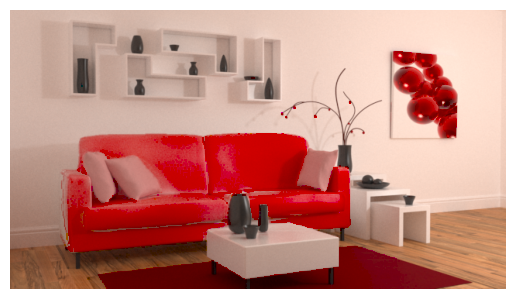

In [ ]:
plt.imshow((image+(image_red-img_ours))**(1/2.2))
plt.axis('off')

In [ ]:
np.clip(image+(image_red-img_ours), 0, None)[200,350,0]

0.5253306

In [ ]:
img_ours[200,350,0]

0.9790245

In [ ]:
plt.imshow(image_edited[:,:,1] < 0)

In [ ]:
plt.imshow(image_edited[:,:,2] < 0)

# cornell box(ipsj)

In [ ]:
mi.ScalarTransform4f().look_at(origin=[-4, -3, 8], target=[0, 1, 0], up=[0.57735, 0.57735, 0.57735])

Transform[
  matrix=[[-0.707107, 0.57735, 0.408248, -4],
          [0.707107, 0.57735, 0.408248, -3],
          [0, 0.57735, -0.816497, 8],
          [0, 0, 0, 1]],
  inverse_transpose=[[-0.707107, 0.57735, 0.408248, 0],
                     [0.707107, 0.57735, 0.408248, 0],
                     [0, 0.57735, -0.816497, 0],
                     [-0.707107, -0.57735, 9.38971, 1]]
]

In [ ]:
mi.ScalarTransform4f().look_at(origin=[4, -3, 8], target=[0, 1, 0], up=[-0.57735, 0.57735, 0.57735])

Transform[
  matrix=[[-0.707107, -0.57735, -0.408248, 4],
          [-0.707107, 0.57735, 0.408248, -3],
          [0, 0.57735, -0.816497, 8],
          [0, 0, 0, 1]],
  inverse_transpose=[[-0.707107, -0.57735, -0.408248, 0],
                     [-0.707107, 0.57735, 0.408248, 0],
                     [0, 0.57735, -0.816497, 0],
                     [0.707107, -0.57735, 9.38971, 1]]
]

In [ ]:
scene = mi.load_file('cornell-box/scene.xml')
img_c = mi.render(scene, spp=1000)

#mi.util.write_bitmap('cornell_albedo.png', img[:,:,6:9])

In [ ]:
Image.fromarray(((img[:,:,6:9].numpy())*255).astype(np.uint8)).save('cornell_albedo_1.png')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


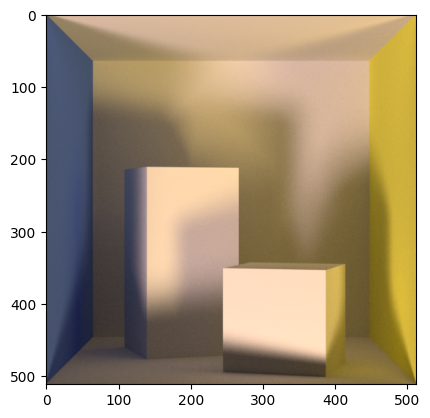

In [ ]:
scene = mi.load_file('cornell-box/scene_changed.xml')
img = mi.render(scene, spp=1000)

#mi.util.write_bitmap('cornell_albedo_changed.png', img[:,:,6:9])
plt.imshow(img[:,:,:3]**(1/2.2))


In [ ]:
c = np.clip((np.abs(img[:,:,:3].numpy()-img_c[:,:,:3].numpy()))**(1/2.2),0,1)
Image.fromarray((c*255).astype(np.uint8)).save('cornell-box/cornell_diff.png')

In [ ]:
Image.fromarray(((img[:,:,6:9].numpy())*255).astype(np.uint8)).save('cornell-box/cornell_albedo_changed.png')

In [ ]:
Image.fromarray(((img[:,:,6:9].numpy())*255).astype(np.uint8)).save('cornell-box/cornell_albedo_changed.png')

In [ ]:
x = exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/cornell_2/dense_v1/albedo/0000.exr', height=512)
Image.fromarray((x*255).astype(np.uint8)).save('cornell_albedo_ours.png')

In [ ]:
mi.util.write_bitmap('cornellbox_changed.png', img[:,:,:3])

In [ ]:
mi.util.write_bitmap('cornellbox.exr',img)
mi.util.write_bitmap('cornellbox.png',img)
mi.util.write_bitmap('cornellbox2.exr',img)

In [112]:
al = np.array(Image.open('cornell-box/cornell_albedo.png')).astype(np.float32)/255
mat = np.zeros([512,512,3])
mat[:,:,0] = 1.0
depth = np.load('cornell_depth.npy')[::2,::2]
from PIL import Image
scene2_normal = Image.open('cornell_normal.png').resize((512, 512), Image.BICUBIC)
scene2_normal_new = np.zeros([512, 512, 3])
scene2_normal_new[:,:,0] = -1*(((np.array(scene2_normal).astype(np.float32) / 255)[:,:,0])*2-1)
scene2_normal_new[:,:,1] = ((np.array(scene2_normal).astype(np.float32) / 255)[:,:,1])*2-1
scene2_normal_new[:,:,2] = (((np.array(scene2_normal).astype(np.float32) / 255)[:,:,2])*2-1)

build_mesh_pixel_face_cut(depth*0.3+0.7, 'cornell_gt_material',  al.reshape(-1), material_array=mat, normal_array=scene2_normal_new, res=[512,512], fov=19.5, threshold_angle=1)

error num:8
angle error num:166


Mesh[
  name = "cornell_gt_material",
  bbox = BoundingBox3f[
    min = [-0.135613, -0.135147, -1.01555],
    max = [0.13532, 0.136145, -0.741718]
  ],
  vertex_count = 1047880,
  vertices = [32 MiB of vertex data],
  face_count = 523940,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
al = (exr2np('../IndoorInverseRendering/mgnet/cornell_2/dense_v1/albedo/0000.exr', height=512))**(1/2.2)
mat = exr2np('../IndoorInverseRendering/mgnet/cornell_2/dense_v1/material/0000.exr', height=512)
depth = np.load('cornell_depth.npy')[::2,::2]
from PIL import Image
scene2_normal = Image.open('cornell_normal.png').resize((512, 512), Image.BICUBIC)
scene2_normal_new = np.zeros([512, 512, 3])
scene2_normal_new[:,:,0] = -1*(((np.array(scene2_normal).astype(np.float32) / 255)[:,:,0])*2-1)
scene2_normal_new[:,:,1] = ((np.array(scene2_normal).astype(np.float32) / 255)[:,:,1])*2-1
scene2_normal_new[:,:,2] = (((np.array(scene2_normal).astype(np.float32) / 255)[:,:,2])*2-1)

build_mesh_pixel_face_cut(depth*0.3+0.7, 'cornell_01112135_albedo_gamma',  al.reshape(-1), material_array=mat, normal_array=scene2_normal_new, res=[512,512], fov=19.5, threshold_angle=1)

error num:8
angle error num:166


Mesh[
  name = "cornell_01112135_albedo_gamma",
  bbox = BoundingBox3f[
    min = [-0.135613, -0.135147, -1.01555],
    max = [0.13532, 0.136145, -0.741718]
  ],
  vertex_count = 1047880,
  vertices = [32 MiB of vertex data],
  face_count = 523940,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
albedo_edited = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/cornell_2/dense_v1/albedo/0000.exr','cornell-box/cornell_mask_left.png',[255*0.1,255*0.2,255*0.9], height=512, gamma_bedore)
Image.fromarray(albedo_edited).save('cornell_albedo_ours_edited.png')
albedo_edited = change_albedo('cornell_albedo_ours_edited.png','cornell-box/cornell_mask_right.png',[255*0.9,255*0.9,255*0.1], height=512).astype(np.float32)/255

mat = exr2np('../IndoorInverseRendering/mgnet/cornell_2/dense_v1/material/0000.exr', height=512)
depth = np.load('cornell_depth.npy')[::2,::2]
from PIL import Image
normal = Image.open('cornell_normal.png').resize((512, 512), Image.BICUBIC)
normal_new = np.zeros([512, 512, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)
build_mesh_pixel_face_cut(depth*0.3+0.7, 'cornell_01112135_albedo_changed',  albedo_edited.reshape(-1), material_array=mat, normal_array=normal_new, res=[512,512], fov=19.5, threshold_angle=1)

error num:8
angle error num:166


Mesh[
  name = "cornell_01112135_albedo_changed",
  bbox = BoundingBox3f[
    min = [-0.135613, -0.135147, -1.01555],
    max = [0.2, 0.2, 0.2]
  ],
  vertex_count = 1048576,
  vertices = [32 MiB of vertex data],
  face_count = 524288,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
albedo_edited = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/cornell_2/dense_v1/albedo/0000.exr','cornell-box/cornell_mask_left.png',[255*0.1,255*0.2,255*0.9], height=512)
Image.fromarray(albedo_edited).save('cornell_albedo_ours_edited_true.png')
albedo_edited = change_albedo('cornell_albedo_ours_edited_true.png','cornell-box/cornell_mask_right.png',[255*0.9,255*0.9,255*0.1], height=512).astype(np.float32)/255

mat = exr2np('../IndoorInverseRendering/mgnet/cornell_2/dense_v1/material/0000.exr', height=512)
depth = np.load('cornell_depth.npy')[::2,::2]
from PIL import Image
normal = Image.open('cornell_normal.png').resize((512, 512), Image.BICUBIC)
normal_new = np.zeros([512, 512, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)
build_mesh_pixel_face_cut(depth*0.3+0.7, 'cornell_01112135_albedo_gamma_changed',  albedo_edited.reshape(-1), material_array=mat, normal_array=normal_new, res=[512,512], fov=19.5, threshold_angle=1)

error num:8
angle error num:166


Mesh[
  name = "cornell_01112135_albedo_gamma_changed",
  bbox = BoundingBox3f[
    min = [-0.135613, -0.135147, -1.01555],
    max = [0.13532, 0.136145, -0.741718]
  ],
  vertex_count = 1047880,
  vertices = [32 MiB of vertex data],
  face_count = 523940,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
Image.fromarray((albedo_edited*255).astype(np.uint8)).save('cornell_albedo_ours_edited_true.png')

In [ ]:
albedo_edited = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/cornell_2/dense_v1/albedo/0000.exr',['cornell-box/cornell_mask_left.png','cornell-box/cornell_mask_right.png'], [[255*0.1,255*0.2,255*0.9],[255*0.9,255*0.9,255*0.1]], height=512).astype(np.float32)/255


In [ ]:
from PIL import Image
Image.fromarray((al*255).astype(np.uint8)).save('cornell_albedo_ours.png')

In [ ]:
Image.fromarray((albedo_edited*255).astype(np.uint8)).save('cornell_albedo_ours_edited.png')

In [ ]:
img_ours = (render_livingroom_disk('cornell_01112135_albedo_gamma.ply', 'cornell_arealight_opt_disk_results/0126_01:57:15_circle_pos', twosided=True, spp=2000, fov=19.5, res=[512,512])[:,:,:3])
img_edited = (render_livingroom_disk('cornell_01112135_albedo_gamma_changed.ply', 'cornell_arealight_opt_disk_results/0126_01:57:15_circle_pos', twosided=True, spp=2000, fov=19.5, res=[512,512])[:,:,:3])
#img_edited = (render_livingroom_disk('cornell_01112135_albedo_changed.ply', 'cornell_arealight_opt_disk_results/bestvalue_0112_02:31:19', twosided=True, spp=1500, fov=19.5, res=[512,512])[:,:,:3])
#mi.util.write_bitmap('cornell_ours_gamma.png', img_ours)
mi.util.write_bitmap('cornell_ours_edited_gamma.png', img_edited)
image = exr2np('cornell-box/cornellbox.exr', height=512)

In [ ]:
mi.util.write_bitmap('cornell_ours_gamma.png', img_ours)
Image.fromarray(((np.clip(image+img_edited.numpy()-img_ours.numpy() ,0,1)**(1/2.2))*255).astype(np.uint8)).save('cornell_ours_finalimage_gamma.png')

In [ ]:
y = np.abs(img_edited.numpy()-img_ours.numpy()) **(1/2.2)
Image.fromarray((255*y).astype(np.uint8)).save('cornell_ours_diff.png')

In [ ]:
np.max(img_edited.numpy())

2.8681316

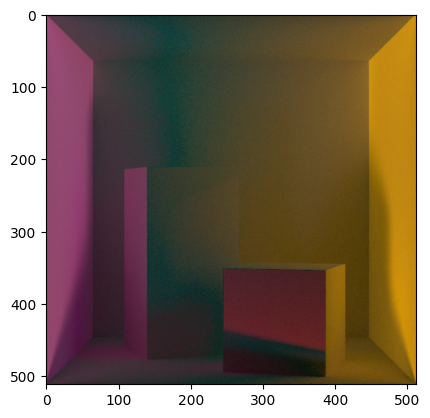

In [ ]:
plt.imshow(np.abs((np.array(Image.open('cornell-box/cornellbox_changed.png')).astype(np.float32)/255)**(2.2) - image)**(1/2.2))

In [118]:
im = render_livingroom_disk('cornell_gt_material.ply', 'cornell_arealight_opt_disk_results/0129_16:52:57', twosided=True, spp=2000, fov=19.5, res=[512,512])[:,:,:3]

In [115]:
al = np.array(Image.open('cornell-box/cornell_albedo_changed.png')).astype(np.float32)/255
mat = np.zeros([512,512,3])
mat[:,:,0] = 1.0
depth = np.load('cornell_depth.npy')[::2,::2]
from PIL import Image
scene2_normal = Image.open('cornell_normal.png').resize((512, 512), Image.BICUBIC)
scene2_normal_new = np.zeros([512, 512, 3])
scene2_normal_new[:,:,0] = -1*(((np.array(scene2_normal).astype(np.float32) / 255)[:,:,0])*2-1)
scene2_normal_new[:,:,1] = ((np.array(scene2_normal).astype(np.float32) / 255)[:,:,1])*2-1
scene2_normal_new[:,:,2] = (((np.array(scene2_normal).astype(np.float32) / 255)[:,:,2])*2-1)

build_mesh_pixel_face_cut(depth*0.3+0.7, 'cornell_gt_material_albedo_changed',  al.reshape(-1), material_array=mat, normal_array=scene2_normal_new, res=[512,512], fov=19.5, threshold_angle=1)

error num:8
angle error num:166


Mesh[
  name = "cornell_gt_material_albedo_changed",
  bbox = BoundingBox3f[
    min = [-0.135613, -0.135147, -1.01555],
    max = [0.13532, 0.136145, -0.741718]
  ],
  vertex_count = 1047880,
  vertices = [32 MiB of vertex data],
  face_count = 523940,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [121]:
al[200,10,:]

array([0.09803922, 0.2       , 0.8980392 ], dtype=float32)

In [117]:
im_changed = render_livingroom_disk('cornell_gt_material_albedo_changed.ply', 'cornell_arealight_opt_disk_results/0129_16:52:57', twosided=True, spp=2000, fov=19.5, res=[512,512])[:,:,:3]

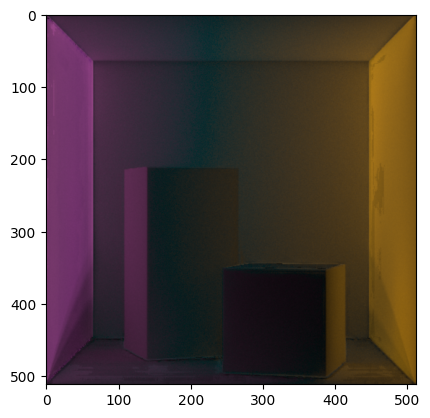

In [119]:
plt.imshow(np.clip(np.abs(im-im_changed),0,1) **(1/2.2))

In [120]:
mi.util.write_bitmap('cornell_ours_material_gt/rendered.png', im)
mi.util.write_bitmap('cornell_ours_material_gt/rendered_changed.png', im_changed)
mi.util.write_bitmap('cornell_ours_material_gt/diff.png', np.clip(np.abs(im-im_changed),0,1))
im_input = (np.array(Image.open('cornell-box/cornellbox.png')).astype(np.float32)/255)**(2.2)
Image.fromarray(((np.clip(im_input+im_changed.numpy()-im.numpy(),0,1))**(1/2.2)*255).astype(np.uint8)).save('cornell_ours_material_gt/finalimage.png')

In [122]:
al = np.ones([512,512,3])

build_mesh_pixel_face_cut(depth*0.3+0.7, 'cornell_white',  al.reshape(-1), material_array=mat, normal_array=scene2_normal_new, res=[512,512], fov=19.5, threshold_angle=1)

error num:8
angle error num:166


Mesh[
  name = "cornell_white",
  bbox = BoundingBox3f[
    min = [-0.135613, -0.135147, -1.01555],
    max = [0.13532, 0.136145, -0.741718]
  ],
  vertex_count = 1047880,
  vertices = [32 MiB of vertex data],
  face_count = 523940,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


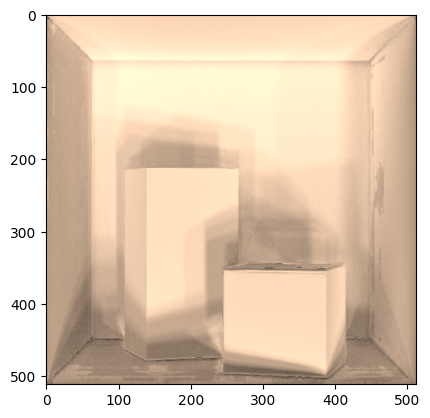

In [125]:
plt.imshow((render_livingroom_disk('cornell_white.ply', 'cornell_arealight_opt_disk_results/0129_16:52:57', twosided=True, spp=2000, fov=19.5, res=[512,512])[:,:,:3])**(1/2.2))

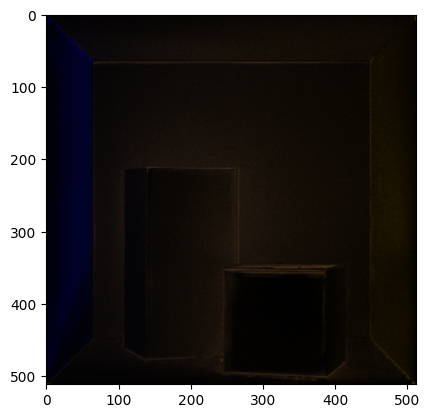

In [129]:
im_changed_one = (render_livingroom_disk('cornell_gt_material_albedo_changed.ply', 'cornell_arealight_opt_disk_results/0129_16:52:57', twosided=False, spp=2000, fov=19.5, res=[512,512])[:,:,:3])


In [130]:
mi.util.write_bitmap('cornell_ours_material_gt/rendered_changed_onesided.png', im_changed_one)

In [131]:
im_one = render_livingroom_disk('cornell_gt_material.ply', 'cornell_arealight_opt_disk_results/0129_16:52:57', twosided=False, spp=2000, fov=19.5, res=[512,512])[:,:,:3]
Image.fromarray(((np.clip(im_input+im_changed_one.numpy()-im_one.numpy(),0,1))**(1/2.2)*255).astype(np.uint8)).save('cornell_ours_material_gt/finalimage_onesided.png')

In [132]:
al = np.array(Image.open('cornell-box/cornell_albedo_changed_blue.png')).astype(np.float32)/255
mat = np.zeros([512,512,3])
mat[:,:,0] = 1.0
depth = np.load('cornell_depth.npy')[::2,::2]
from PIL import Image
scene2_normal = Image.open('cornell_normal.png').resize((512, 512), Image.BICUBIC)
scene2_normal_new = np.zeros([512, 512, 3])
scene2_normal_new[:,:,0] = -1*(((np.array(scene2_normal).astype(np.float32) / 255)[:,:,0])*2-1)
scene2_normal_new[:,:,1] = ((np.array(scene2_normal).astype(np.float32) / 255)[:,:,1])*2-1
scene2_normal_new[:,:,2] = (((np.array(scene2_normal).astype(np.float32) / 255)[:,:,2])*2-1)

build_mesh_pixel_face_cut(depth*0.3+0.7, 'cornell_gt_material_albedo_changed_max_blue',  al.reshape(-1), material_array=mat, normal_array=scene2_normal_new, res=[512,512], fov=19.5, threshold_angle=1)

error num:8
angle error num:166


Mesh[
  name = "cornell_gt_material_albedo_changed_max_blue",
  bbox = BoundingBox3f[
    min = [-0.135613, -0.135147, -1.01555],
    max = [0.13532, 0.136145, -0.741718]
  ],
  vertex_count = 1047880,
  vertices = [32 MiB of vertex data],
  face_count = 523940,
  faces = [6 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [133]:
im_changed_max_blue = (render_livingroom_disk('cornell_gt_material_albedo_changed_max_blue.ply', 'cornell_arealight_opt_disk_results/0129_16:52:57', twosided=False, spp=2000, fov=19.5, res=[512,512])[:,:,:3])
Image.fromarray(((np.clip(im_input+im_changed_max_blue.numpy()-im.numpy(),0,1))**(1/2.2)*255).astype(np.uint8)).save('cornell_ours_material_gt/finalimage_max_blue.png')

# Geometry modify

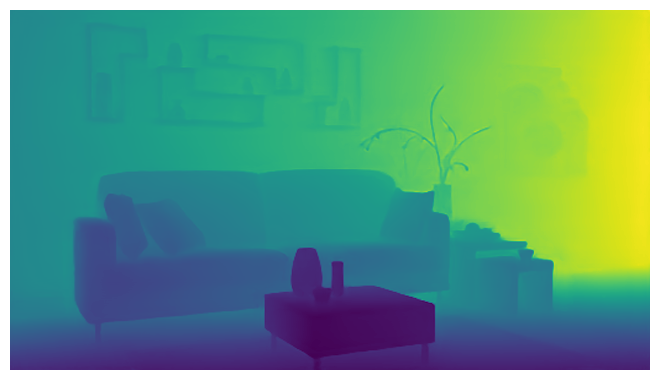

In [ ]:
depth = prediction.to('cpu').detach().numpy().copy().squeeze()

plt.imshow(depth)
plt.axis('off')
plt.subplots_adjust(left=0,right=1,top=1,bottom=0)
plt.savefig('metric_depth.png')

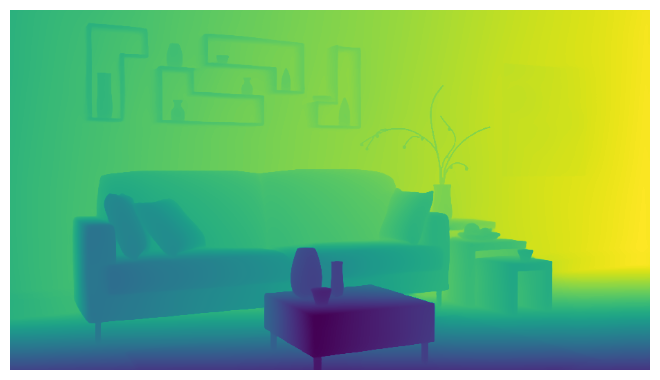

In [ ]:
depth_re = np.load('livingroom_depth.npy')
plt.imshow( 1-  (depth_re - np.min(depth_re))/(np.max(depth_re) - np.min(depth_re)))
plt.axis('off')
plt.subplots_adjust(left=0,right=1,top=1,bottom=0)
plt.savefig('relative_depth.png')

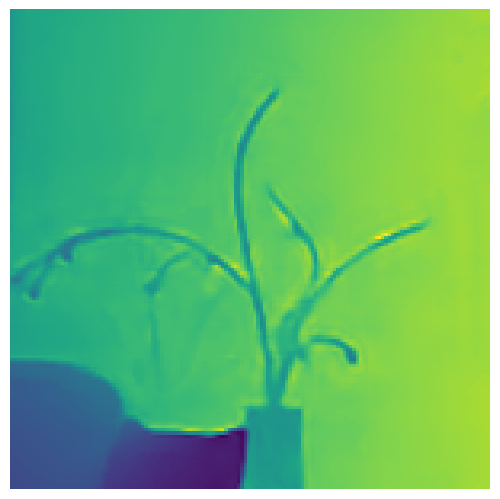

In [ ]:
plt.imshow( ((depth-np.min(depth))/(np.max(depth)-np.min(depth))) [50:200,350:500])
plt.axis('off')
plt.subplots_adjust(left=0,right=1,top=1,bottom=0)
plt.savefig('metric_depth_zoom.png')

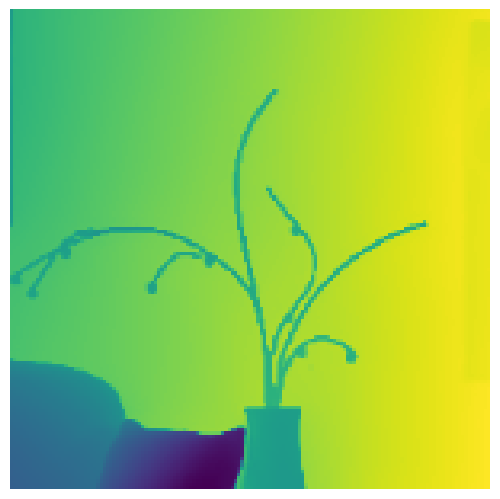

In [ ]:
plt.imshow((1-  (depth_re - np.min(depth_re))/(np.max(depth_re) - np.min(depth_re)))[50:200,350:500])
plt.axis('off')
plt.subplots_adjust(left=0,right=1,top=1,bottom=0)
plt.savefig('relative_depth_zoom.png')

In [ ]:
def calculate_angle(a,b,c):
    ab = np.array([b[0] - a[0], b[1] - a[1], b[2] - a[2]])
    ac = np.array([c[0] - a[0], c[1] - a[1], c[2] - a[2]])
    dot_product = ab @ ac
    norm_ab = np.linalg.norm(ab, ord=2)
    norm_ac = np.linalg.norm(ac, ord=2)
    cos = dot_product / (norm_ab*norm_ac)
    angle_rad = math.acos(max(min(cos, 1.0), -1.0))
    return math.degrees(angle_rad)

def min_triangle_angle(p1,p2,p3):
    return min(calculate_angle(p1,p2,p3),calculate_angle(p2,p3,p1),calculate_angle(p3,p1,p2))


def build_mesh_pixel_face_cut_refinement(z_depth_pos, name, albedo_1d_array, material_array=None, normal_array=None, res=[256,256], fov=90, write_ply=True, threshold_angle=5, threshold=0.03):
    # mesh : (4*H*W) * 3
    # modified xy

    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    if albedo_1d_array.ndim != 1:
        albedo_1d_array = albedo_1d_array.reshape([-1])
    
    if normal_array is not None and normal_array.ndim > 2:
        normal_array = normal_array.reshape([-1, 3])

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim
    pixel_length = 2 / x_dim # one side length of pixel face

    y_screen,x_screen = np.mgrid[y_dim/x_dim-pixel_length/2 :-y_dim/x_dim+pixel_length/2 :y_dim*1j, -1+pixel_length/2 :1-pixel_length/2:x_dim*1j]
    y_screen = y_screen.reshape([-1])
    x_screen = x_screen.reshape([-1])
    z_screen = -1/math.tan(math.radians(fov/2))*np.ones([N])

    
    y_modified = y_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))
    x_modified = x_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))

    center_pos_screen = np.stack([x_screen, y_screen, z_screen], axis=1)
    center_pos = np.stack([x_modified, y_modified, (-1*z_depth_pos).reshape([-1])], axis=1)
    vertex_pos = np.zeros([4*N, 3])
    error_num = 0
    angle_error_num = 0
    exception_index = []

    for i in range(y_dim): # from top to bottom
        for j in range(x_dim): # from left to right
            # p --- q
            # |  c  |
            # s --- r
            c_screen = center_pos_screen[i*x_dim+j,:]
            p_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            q_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            r_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            s_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            n = normal_array[i*x_dim+j,:]
            c = center_pos[i*x_dim+j,:]
            # if np.dot(n,p_screen) < 0.0000001 or np.dot(n,q_screen) < 0.0000001 or np.dot(n,r_screen) < 0.0000001 or np.dot(n,s_screen) < 0.0000001:
            #     print('Normal vector and view vector are nearly orthogonal. (i,j) = ('+str(i)+','+str(j)+')')
            #     return 
            k_p = np.dot(n,c) / np.dot(n,p_screen)
            k_q = np.dot(n,c) / np.dot(n,q_screen)
            k_r = np.dot(n,c) / np.dot(n,r_screen)
            k_s = np.dot(n,c) / np.dot(n,s_screen)

            if k_p < 0 or k_q < 0 or k_r < 0 or k_s < 0:
                error_num += 1
                exception_index.append(x_dim*i+j)
            else:
                p = k_p * p_screen
                q = k_q * q_screen
                r = k_r * r_screen
                s = k_s * s_screen
                if min_triangle_angle(p,q,s) < threshold_angle or min_triangle_angle(q,r,s) < threshold_angle:
                    angle_error_num += 1
                    exception_index.append(x_dim*i+j)

            
            vertex_pos[4*(i*x_dim+j),:] = p
            vertex_pos[4*(i*x_dim+j)+1,:] = q
            vertex_pos[4*(i*x_dim+j)+2,:] = r
            vertex_pos[4*(i*x_dim+j)+3,:] = s
            #print('p: ', end='')
            #print(vertex_pos[4*(i*x_dim+j),:])

    delete_vertex_index = np.array(list(np.arange(4*x,4*x+4) for x in exception_index)).reshape(-1)
    al = np.repeat(albedo_1d_array.reshape([-1,3]), 4, axis=0) # 4N x 3
    rough = np.repeat(material_array[:,:,0].reshape(-1),4) # 4N
    metal = np.repeat(material_array[:,:,1].reshape(-1),4)

    vertex_pos = np.delete(vertex_pos, delete_vertex_index, axis=0)
    al = np.delete(al, delete_vertex_index, axis=0)
    rough = np.delete(rough, delete_vertex_index)
    metal = np.delete(metal, delete_vertex_index)

    
    # face list : 
    # m--m+1           m+1
    # | /  x N,      /  |   x N
    # m+3          m+3-m+2
    face_ind = np.array(range(N-len(exception_index)))
    faces_1 = np.concatenate([4*face_ind+1, 4*face_ind+2])
    faces_2 = np.concatenate([4*face_ind, 4*face_ind+1])
    faces_3 = np.concatenate([4*face_ind+3, 4*face_ind+3])
    face_indices = mi.Vector3u(faces_1, faces_2, faces_3)
    
    
    mesh = mi.Mesh(
        name,
        vertex_count=4*(N-len(exception_index)),
        face_count=2*(N-len(exception_index)),
        has_vertex_normals=False,
        has_vertex_texcoords=False,
    )

    mesh_params = mi.traverse(mesh)
    mesh_params['vertex_positions'] = dr.ravel(mi.Point3f(vertex_pos.transpose(1,0)))
    mesh_params['faces'] = dr.ravel(face_indices)
    print('error num:'+str(error_num))
    print('angle error num:'+str(angle_error_num))
    
    # albedo_1d_array : N*3 -> 4*N*3
    mesh.add_attribute('vertex_albedo', 3, al.reshape(-1))
    #mesh.add_attribute('vertex_albedo', 3, albedo_1d_array)
    if material_array is not None:
        mesh.add_attribute('vertex_roughness', 1, rough)
        mesh.add_attribute('vertex_metallic', 1, metal)
    mesh_params.update()
    mesh.write_ply(name+'.ply')

    mesh_loaded = mi.load_dict({
        'type': 'ply',
        'filename': name+'.ply',
        'bsdf': {
            'type': 'principled',
            'base_color': {
                'type': 'mesh_attribute',
                'name': 'vertex_albedo',
            },
            'metallic': {
                'type': 'mesh_attribute',
                'name': 'vertex_metallic',
            },
            'roughness': {
                'type': 'mesh_attribute',
                'name': 'vertex_roughness',
            },
        },
    })

    scene_dict = {
        'type': 'scene',
        'integrator': {
            'type':'aov',
            'aovs':'al:albedo,dd:depth',
            'my_integrator':{'type': 'path', 'max_depth': max_depth, 'hide_emitters':True},
        },
        'sensor': {
            'type': 'perspective',
            'fov': fov,
            'near_clip': 0.01,
            'to_world': mi.ScalarTransform4f().look_at(
                origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
            ),
            'film_id': {
            'type': 'hdrfilm',
            'width': res[1],
            'height': res[0],
            'pixel_format': 'rgb',
            'component_format': 'float32',
            'filter': { 'type': 'tent' }
            },
        },
        'wholescene': mesh_loaded,
    }

    scene = mi.load_dict(scene_dict)


    return  mi.render(scene, spp=spp)



In [ ]:
def calculate_angle(a,b,c):
    ab = np.array([b[0] - a[0], b[1] - a[1], b[2] - a[2]])
    ac = np.array([c[0] - a[0], c[1] - a[1], c[2] - a[2]])
    dot_product = ab @ ac
    norm_ab = np.linalg.norm(ab, ord=2)
    norm_ac = np.linalg.norm(ac, ord=2)
    cos = dot_product / (norm_ab*norm_ac)
    angle_rad = math.acos(max(min(cos, 1.0), -1.0))
    return math.degrees(angle_rad)

def min_triangle_angle(p1,p2,p3):
    return min(calculate_angle(p1,p2,p3),calculate_angle(p2,p3,p1),calculate_angle(p3,p1,p2))


def build_mesh_pixel_face_cut_hybrid(z_depth_pos, name, albedo_1d_array, material_array=None, normal_array=None, res=[256,256], fov=90, write_ply=True, threshold_angle=5, threshold=0.03):
    # mesh : (4*H*W) * 3
    # modified xy

    if np.max(z_depth_pos) > 1:
        z_depth_pos /= np.max(z_depth_pos)

    if albedo_1d_array.ndim != 1:
        albedo_1d_array = albedo_1d_array.reshape([-1])
    
    if normal_array is not None and normal_array.ndim > 2:
        normal_array = normal_array.reshape([-1, 3])

    y_dim = res[0]; x_dim = res[1] 
    N = y_dim*x_dim
    pixel_length = 2 / x_dim # one side length of pixel face

    y_screen,x_screen = np.mgrid[y_dim/x_dim-pixel_length/2 :-y_dim/x_dim+pixel_length/2 :y_dim*1j, -1+pixel_length/2 :1-pixel_length/2:x_dim*1j]
    y_screen = y_screen.reshape([-1])
    x_screen = x_screen.reshape([-1])
    z_screen = -1/math.tan(math.radians(fov/2))*np.ones([N])

    
    y_modified = y_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))
    x_modified = x_screen * np.abs(z_depth_pos.reshape([-1]))*math.tan(math.radians(fov/2))

    center_pos_screen = np.stack([x_screen, y_screen, z_screen], axis=1)
    center_pos = np.stack([x_modified, y_modified, (-1*z_depth_pos).reshape([-1])], axis=1)
    vertex_pos = np.zeros([4*N, 3])
    error_num = 0
    angle_error_num = 0
    exception_index = []

    for i in range(y_dim): # from top to bottom
        for j in range(x_dim): # from left to right
            # p --- q
            # |  c  |
            # s --- r
            c_screen = center_pos_screen[i*x_dim+j,:]
            p_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            q_screen = np.array([c_screen[0]-pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            r_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]+pixel_length/2, c_screen[2]])
            s_screen = np.array([c_screen[0]+pixel_length/2, c_screen[1]-pixel_length/2, c_screen[2]])
            n = normal_array[i*x_dim+j,:]
            c = center_pos[i*x_dim+j,:]
            # if np.dot(n,p_screen) < 0.0000001 or np.dot(n,q_screen) < 0.0000001 or np.dot(n,r_screen) < 0.0000001 or np.dot(n,s_screen) < 0.0000001:
            #     print('Normal vector and view vector are nearly orthogonal. (i,j) = ('+str(i)+','+str(j)+')')
            #     return 
            k_p = np.dot(n,c) / np.dot(n,p_screen)
            k_q = np.dot(n,c) / np.dot(n,q_screen)
            k_r = np.dot(n,c) / np.dot(n,r_screen)
            k_s = np.dot(n,c) / np.dot(n,s_screen)

            if k_p < 0 or k_q < 0 or k_r < 0 or k_s < 0:
                error_num += 1
                exception_index.append(x_dim*i+j)
            else:
                p = k_p * p_screen
                q = k_q * q_screen
                r = k_r * r_screen
                s = k_s * s_screen
                if min_triangle_angle(p,q,s) < threshold_angle or min_triangle_angle(q,r,s) < threshold_angle:
                    angle_error_num += 1
                    exception_index.append(x_dim*i+j)

            
            vertex_pos[4*(i*x_dim+j),:] = p
            vertex_pos[4*(i*x_dim+j)+1,:] = q
            vertex_pos[4*(i*x_dim+j)+2,:] = r
            vertex_pos[4*(i*x_dim+j)+3,:] = s
            #print('p: ', end='')
            #print(vertex_pos[4*(i*x_dim+j),:])

    extra_vert_pos = []
    extra_face1 = []
    extra_face2 = []
    extra_face3 = []
    extra_al = []
    extra_rough = []
    extra_metal = []
    extra_cnt = 0

    for i, index in enumerate(exception_index):
        if index%x_dim == 0 or index%x_dim == x_dim-1 or index//x_dim == 0 or index//x_dim == x_dim-1:
            continue

        extra_vert_pos.append(center_pos[index,:])
        extra_al.append((albedo_1d_array.reshape(-1))[3*index:3*index+3])
        extra_rough.append((material_array[:,:,0].reshape(-1))[index])
        extra_metal.append((material_array[:,:,1].reshape(-1))[index])

        extra_vert_pos.append(center_pos[index-1,:])
        extra_al.append((albedo_1d_array.reshape(-1))[3*(index-1):3*(index-1)+3])
        extra_rough.append((material_array[:,:,0].reshape(-1))[index-1])
        extra_metal.append((material_array[:,:,1].reshape(-1))[index-1])

        extra_vert_pos.append(center_pos[index+x_dim,:])
        extra_al.append((albedo_1d_array.reshape(-1))[3*(index-x_dim):3*(index-x_dim)+3])
        extra_rough.append((material_array[:,:,0].reshape(-1))[index-x_dim])
        extra_metal.append((material_array[:,:,1].reshape(-1))[index-x_dim])

        extra_vert_pos.append(center_pos[index+1,:])
        extra_al.append((albedo_1d_array.reshape(-1))[3*(index+1):3*(index+1)+3])
        extra_rough.append((material_array[:,:,0].reshape(-1))[index+1])
        extra_metal.append((material_array[:,:,1].reshape(-1))[index+1])

        extra_vert_pos.append(center_pos[index,:])
        extra_al.append((albedo_1d_array.reshape(-1))[3*(index+x_dim):3*(index+x_dim)+3])
        extra_rough.append((material_array[:,:,0].reshape(-1))[index+x_dim])
        extra_metal.append((material_array[:,:,1].reshape(-1))[index+x_dim])

        if np.max([np.linalg.norm(center_pos[index,:] - center_pos[index-1,:]), np.linalg.norm(center_pos[index,:] - center_pos[index-x_dim,:])]) < threshold:
            extra_face1.append(5*extra_cnt)
            extra_face2.append(5*extra_cnt+2)
            extra_face3.append(5*extra_cnt+1)

        if np.max([np.linalg.norm(center_pos[index,:] - center_pos[index+1,:]), np.linalg.norm(center_pos[index,:] - center_pos[index-x_dim,:])]) < threshold:
            extra_face1.append(5*extra_cnt)
            extra_face2.append(5*extra_cnt+3)
            extra_face3.append(5*extra_cnt+2)

        if np.max([np.linalg.norm(center_pos[index,:] - center_pos[index+1,:]), np.linalg.norm(center_pos[index,:] - center_pos[index+x_dim,:])]) < threshold:
            extra_face1.append(5*extra_cnt)
            extra_face2.append(5*extra_cnt+4)
            extra_face3.append(5*extra_cnt+3)

        if np.max([np.linalg.norm(center_pos[index,:] - center_pos[index-1,:]), np.linalg.norm(center_pos[index,:] - center_pos[index+x_dim,:])]) < threshold:
            extra_face1.append(5*extra_cnt)
            extra_face2.append(5*extra_cnt+1)
            extra_face3.append(5*extra_cnt+4)
        extra_cnt += 1

    delete_vertex_index = np.array(list(np.arange(4*x,4*x+4) for x in exception_index)).reshape(-1)
    al = np.repeat(albedo_1d_array.reshape([-1,3]), 4, axis=0) # 4N x 3
    rough = np.repeat(material_array[:,:,0].reshape(-1),4) # 4N
    metal = np.repeat(material_array[:,:,1].reshape(-1),4)

    vertex_pos = np.delete(vertex_pos, delete_vertex_index, axis=0)
    al = np.delete(al, delete_vertex_index, axis=0)
    rough = np.delete(rough, delete_vertex_index)
    metal = np.delete(metal, delete_vertex_index)

    vertex_pos = np.concatenate([vertex_pos, np.array(extra_vert_pos)], axis=0)
    al = np.concatenate([al, np.array(extra_al)], axis=0)
    rough = np.concatenate([rough, np.array(extra_rough)])
    metal = np.concatenate([metal, np.array(extra_metal)])

    # face list : 
    # m--m+1           m+1
    # | /  x N,      /  |   x N
    # m+3          m+3-m+2
    face_ind = np.array(range(N-len(exception_index)))
    faces_1 = np.concatenate([4*face_ind+1, 4*face_ind+2, np.array(extra_face1)+4*(N-len(exception_index))])
    faces_2 = np.concatenate([4*face_ind, 4*face_ind+1, np.array(extra_face2)+4*(N-len(exception_index))])
    faces_3 = np.concatenate([4*face_ind+3, 4*face_ind+3, np.array(extra_face3)+4*(N-len(exception_index))])
    face_indices = mi.Vector3u(faces_1, faces_2, faces_3)
    # print(4*(N-len(exception_index))+5*len(exception_index))
    # for x in faces_1:
    #     if x >= 4*(N-len(exception_index))+5*len(exception_index):
    #         print('error: '+str(x))
    # for x in faces_2:
    #     if x >= 4*(N-len(exception_index))+5*len(exception_index):
    #         print('error: '+str(x))
    # for x in faces_3:
    #     if x >= 4*(N-len(exception_index))+5*len(exception_index):
    #         print('error: '+str(x))

    #print(vertex_pos)
    #print(face_indices)
    
    mesh = mi.Mesh(
        name,
        vertex_count=4*(N-len(exception_index))+5*extra_cnt,
        face_count=2*(N-len(exception_index))+len(extra_face1),
        has_vertex_normals=False,
        has_vertex_texcoords=False,
    )

    mesh_params = mi.traverse(mesh)
    mesh_params['vertex_positions'] = dr.ravel(mi.Point3f(vertex_pos.transpose(1,0)))
    mesh_params['faces'] = dr.ravel(face_indices)
    print('error num:'+str(error_num))
    print('angle error num:'+str(angle_error_num))
    
    # albedo_1d_array : N*3 -> 4*N*3
    mesh.add_attribute('vertex_albedo', 3, al.reshape(-1))
    #mesh.add_attribute('vertex_albedo', 3, albedo_1d_array)
    if material_array is not None:
        mesh.add_attribute('vertex_roughness', 1, rough)
        mesh.add_attribute('vertex_metallic', 1, metal)
    mesh_params.update()
    if write_ply:
        mesh.write_ply(name+'.ply')
    return mesh


In [ ]:
build_mesh_pixel_face_cut_hybrid(depth, 'test_urgent_1_0_05', albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1, threshold=0.1)

error num:19
angle error num:640


Mesh[
  name = "test_urgent_1_0_05",
  bbox = BoundingBox3f[
    min = [-0.329451, -0.134156, -1.00077],
    max = [0.465953, 0.2625, -0.438517]
  ],
  vertex_count = 922259,
  vertices = [28.1 MiB of vertex data],
  face_count = 462110,
  faces = [5.29 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
albedo_red = (change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', (200,0,0)).astype(np.float16)) /255
build_mesh_pixel_face_cut_hybrid(depth, 'test_urgent_1_0_05_red', albedo_red.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1, threshold=0.1)

error num:19
angle error num:640


Mesh[
  name = "test_urgent_1_0_05_red",
  bbox = BoundingBox3f[
    min = [-0.329451, -0.134156, -1.00077],
    max = [0.465953, 0.2625, -0.438517]
  ],
  vertex_count = 922259,
  vertices = [28.1 MiB of vertex data],
  face_count = 462110,
  faces = [5.29 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
build_mesh_pixel_face_cut(depth, 'livingroom_pixelface_cut1_metricdepth', albedo_l_2.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_metricdepth",
  bbox = BoundingBox3f[
    min = [-0.329451, -0.134156, -1.00077],
    max = [0.465953, 0.2625, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
build_mesh_pixel_face_cut(depth, 'livingroom_pixelface_cut1_metricdepth_red', albedo_red.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)

error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_metricdepth_red",
  bbox = BoundingBox3f[
    min = [-0.329451, -0.134156, -1.00077],
    max = [0.465953, 0.2625, 0.2]
  ],
  vertex_count = 921600,
  vertices = [28.1 MiB of vertex data],
  face_count = 460800,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
plt.imshow(render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3] **(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


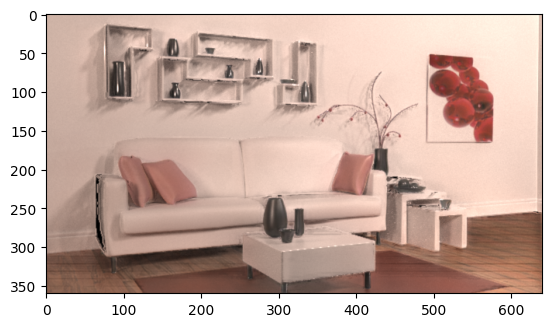

In [ ]:
image_norm = render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3].numpy()
plt.imshow(image_norm**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


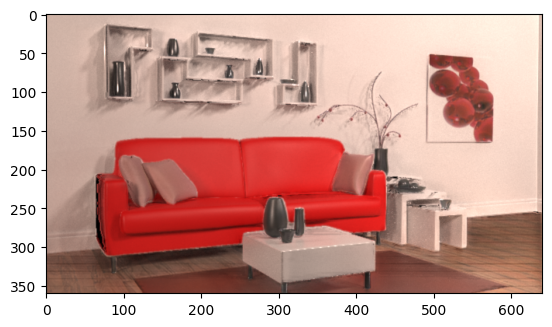

In [ ]:
image_norm_red = render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_red.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3].numpy()
plt.imshow(image_norm_red**(1/2.2))

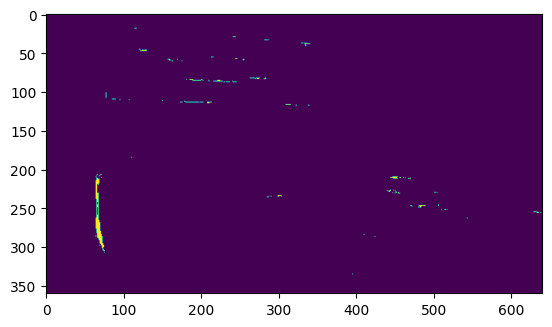

In [ ]:
damage_mask = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=20)[:,:,8] > -0.5).numpy()
plt.imshow(damage_mask)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


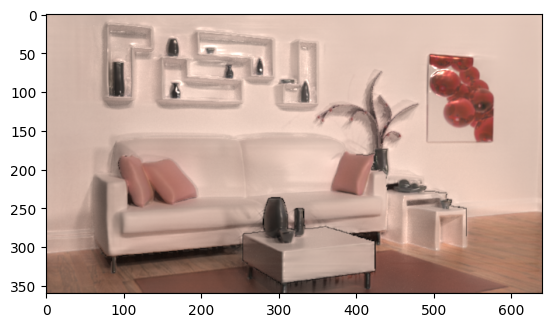

In [ ]:
image_default = render_livingroom_disk('livingroom_default.ply', 'livingroom_default_arealight_opt_disk_results/0123_23:58:20', twosided=True, spp=2000)[:,:,:3].numpy()
plt.imshow(image_default**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


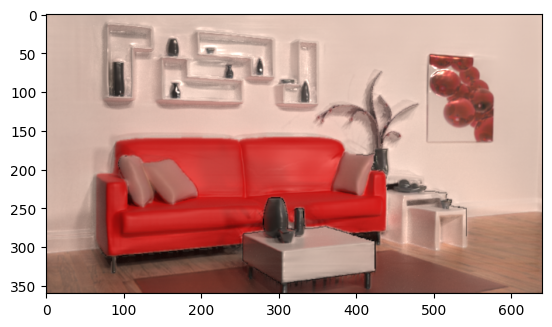

In [ ]:
image_default_red = render_livingroom_disk('livingroom_default_red.ply', 'livingroom_default_arealight_opt_disk_results/0123_23:58:20', twosided=True, spp=2000)[:,:,:3].numpy()
plt.imshow(image_default_red**(1/2.2))

In [ ]:
image = exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360)

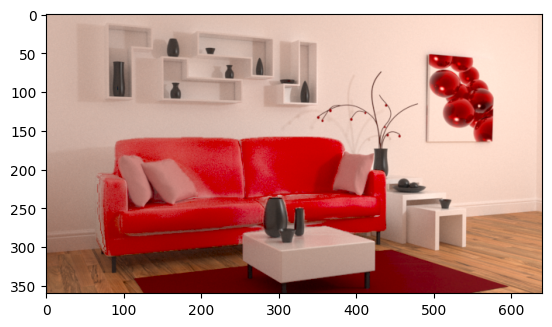

In [ ]:
plt.imshow(np.clip(image-(image_norm -image_norm_red), 0,1)**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


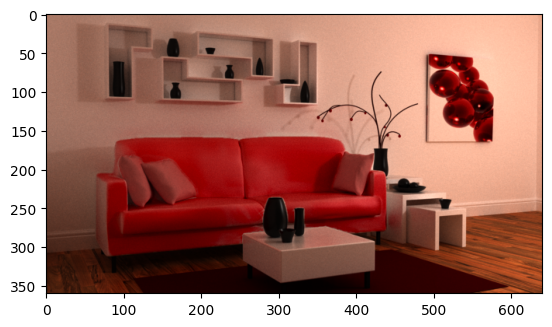

In [ ]:
plt.imshow(image-(image_default -image_default_red))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


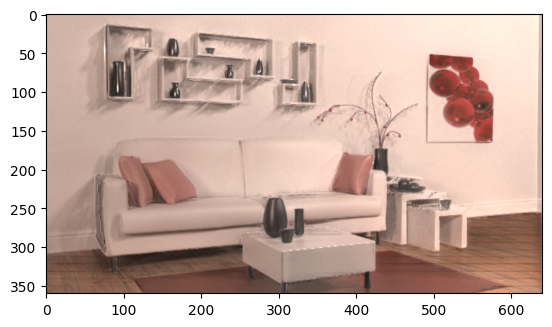

In [ ]:
plt.imshow(((1-damage_mask[:,:,np.newaxis])*image_norm+(damage_mask[:,:,np.newaxis])*image_default)**(1/2.2))

In [ ]:
def render_livingroom_disk_double(mesh_path, dir_path, twosided=False, spp=1000, max_depth=8, fov=50, res=[360,640]):
    if twosided:
        mesh_loaded = mi.load_dict({
            'type': 'ply',
            #'filename': 'ds_sample.ply',
            'filename': mesh_path,
            'bsdf': {
                'type':'twosided',
                'material':{        
                    'type': 'principled',
                    'base_color': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_albedo',
                    },
                    'metallic': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_metallic',
                    },
                    'roughness': {
                        'type': 'mesh_attribute',
                        'name': 'vertex_roughness',
                    },
                }
            },
        })
    else:    
        mesh_loaded = mi.load_dict({
            'type': 'ply',
            #'filename': 'ds_sample.ply',
            'filename': mesh_path,
            'bsdf': {
                'type': 'principled',
                'base_color': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_albedo',
                },
                'metallic': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_metallic',
                },
                'roughness': {
                    'type': 'mesh_attribute',
                    'name': 'vertex_roughness',
                },
            },
        })
    

    scene_dict = {
        'type': 'scene',
        'integrator': {
            'type':'aov',
            'aovs':'al:albedo,pos:position',
            'my_integrator':{'type': 'path', 'max_depth': max_depth, 'hide_emitters':True},
        },
        #'light': {'type': 'point', 'position': [0, 0, 0.1], 'intensity': {'type': 'spectrum', 'value': 1.0,}},
        #'light' : {'type' :'constant'},
        'sensor': {
            'type': 'perspective',
            'fov': fov,
            'near_clip': 0.01,
            'to_world': mi.ScalarTransform4f().look_at(
                origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
            ),
            'film_id': {
            'type': 'hdrfilm',
            'width': res[1],
            'height': res[0],
            'pixel_format': 'rgb',
            'component_format': 'float32',
            'filter': { 'type': 'tent' }
            },
        },
        'wholescene': mesh_loaded,
    }

    scene = mi.load_dict(scene_dict)

    params = mi.traverse(scene)
    print(params['wholescene'])


In [ ]:
render_livingroom_disk_double('livingroom_default_red.ply','1')

SceneParameters[
  --------------------------------------------------------------------------------------------------------
  Name                                                 Flags    Type           Parent
  --------------------------------------------------------------------------------------------------------
  sensor.near_clip                                              float          PerspectiveCamera
  sensor.far_clip                                               float          PerspectiveCamera
  sensor.shutter_open                                           float          PerspectiveCamera
  sensor.shutter_open_time                                      float          PerspectiveCamera
  sensor.film.size                                              ScalarVector2u HDRFilm
  sensor.film.crop_size                                         ScalarVector2u HDRFilm
  sensor.film.crop_offset                                       ScalarPoint2u  HDRFilm
  sensor.x_fov                    

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


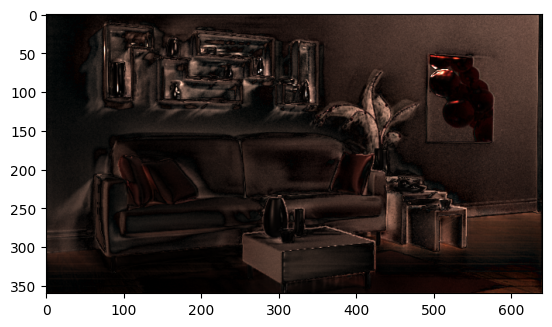

In [ ]:
plt.imshow(np.abs(image_norm - image_default))

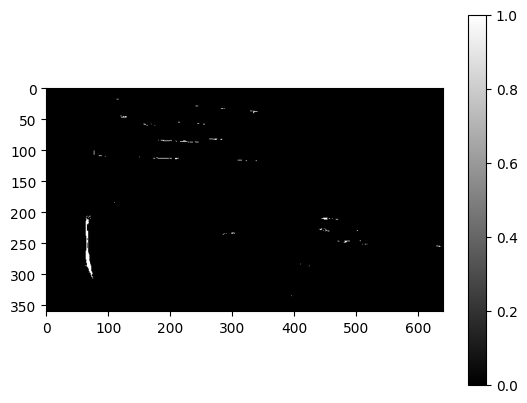

In [ ]:
mesh_loaded = mi.load_dict({
    'type': 'ply',
    'filename': 'livingroom_pixelface_cut1_depthanyv2_raw.ply',
    'bsdf': {
        'type': 'principled',
        'base_color': {
            'type': 'mesh_attribute',
            'name': 'vertex_albedo',
        },
        'metallic': {
            'type': 'mesh_attribute',
            'name': 'vertex_metallic',
        },
        'roughness': {
            'type': 'mesh_attribute',
            'name': 'vertex_roughness',
        },
    },
})

scene_dict = {
    'type': 'scene',
    'integrator': {
        'type':'aov',
        'aovs':'al:albedo,dd:depth',
        'my_integrator':{'type': 'path', 'max_depth': 3, 'hide_emitters':True},
    },
    'sensor': {
        'type': 'perspective',
        'fov': 50,
        'near_clip': 0.01,
        'to_world': mi.ScalarTransform4f().look_at(
            origin=[0, 0, 0], target=[0, 0, -1], up=[0, 1, 0]
        ),
        'film_id': {
        'type': 'hdrfilm',
        'width': 640,
        'height': 360,
        'pixel_format': 'rgb',
        'component_format': 'float32',
        'filter': { 'type': 'tent' }
        },
    },
    'wholescene': mesh_loaded,
}

scene = mi.load_dict(scene_dict)


#plt.imshow(mi.render(scene, spp=50)[:,:,6])
damage_mask = (mi.render(scene, spp=50)[:,:,6]).numpy() < 0.4
plt.imshow(damage_mask, cmap='grey')
plt.colorbar()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


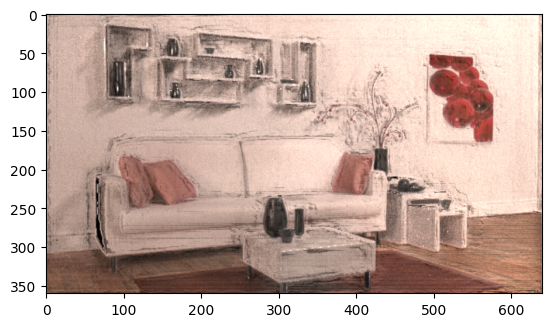

In [ ]:
plt.imshow(render_livingroom_disk('livingroom_pixelface_cut1_metricdepth.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=200)[:,:,:3] **(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


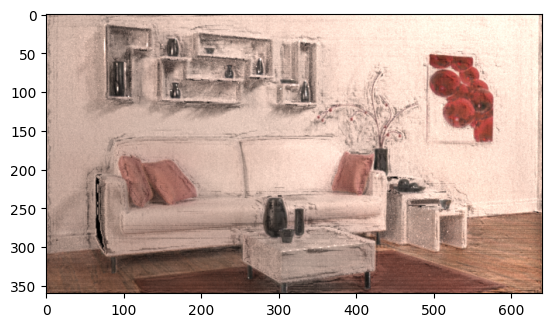

In [ ]:
plt.imshow(render_livingroom_disk('test_urgent_1_0_05.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=200)[:,:,:3] **(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


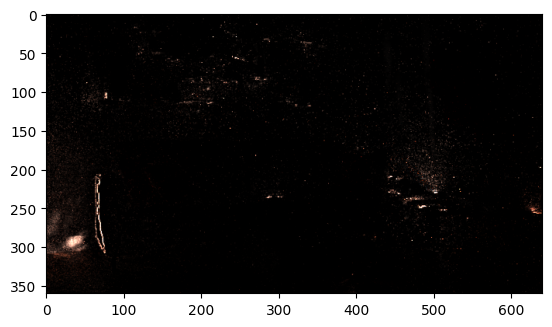

In [ ]:
plt.imshow(10*np.abs((render_livingroom_disk('test_urgent_1_0_05.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=200)[:,:,:3]).numpy() - (render_livingroom_disk('livingroom_pixelface_cut1_metricdepth.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=200)[:,:,:3]).numpy()))

In [ ]:
img_ours = (render_livingroom_disk('test_urgent_1_0_05.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()
image_red = (render_livingroom_disk('test_urgent_1_0_05_red.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()
image = exr2np('living-room-3/living-room-3/livingroom_nograss.exr', height=360)
#plt.imshow((image+(image_red-img_ours))**(1/2.2))
#plt.axis('off')

(-0.5, 639.5, 359.5, -0.5)

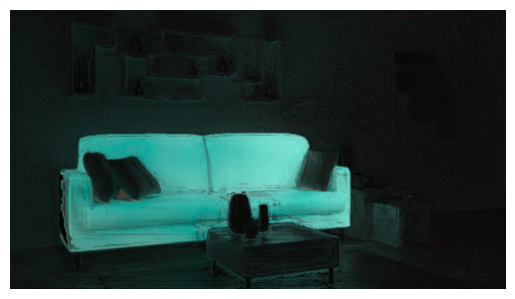

In [ ]:
plt.imshow((np.abs(image_red-img_ours))**(1/2.2))
plt.axis('off')

/tmp/ipykernel_2006105/2319724726.py:1: RuntimeWarning: invalid value encountered in power
  plt.imshow((image+(image_red-img_ours))**(1/2.2))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 359.5, -0.5)

/home/michael/yuma/anaconda3/envs/mitsuba3/lib/python3.11/site-packages/matplotlib/cm.py:494: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


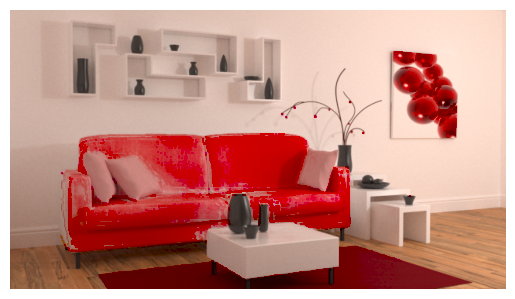

In [ ]:
plt.imshow((image+(image_red-img_ours))**(1/2.2))
plt.axis('off')

In [ ]:
noadd_ours = (render_livingroom_disk('livingroom_pixelface_cut1_metricdepth.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()
noadd_red = (render_livingroom_disk('livingroom_pixelface_cut1_metricdepth_red.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=2000)[:,:,:3]).numpy()


(-0.5, 639.5, 359.5, -0.5)

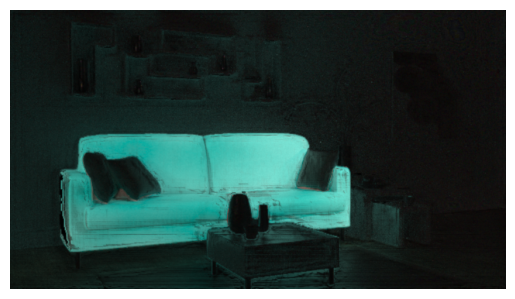

In [ ]:
plt.imshow((np.abs(noadd_red-noadd_ours))**(1/2.2))
plt.axis('off')

/tmp/ipykernel_2006105/1962004255.py:1: RuntimeWarning: invalid value encountered in power
  plt.imshow((image+(noadd_red-noadd_ours))**(1/2.2))
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


(-0.5, 639.5, 359.5, -0.5)

/home/michael/yuma/anaconda3/envs/mitsuba3/lib/python3.11/site-packages/matplotlib/cm.py:494: RuntimeWarning: invalid value encountered in cast
  xx = (xx * 255).astype(np.uint8)


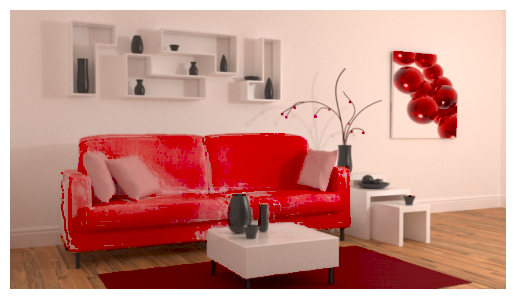

In [ ]:
plt.imshow((image+(noadd_red-noadd_ours))**(1/2.2))
plt.axis('off')

In [ ]:
from PIL import Image
living_stable_normal = Image.open('/home/michael/yuma/ダウンロード/living_normal_image.png').resize((640, 360), Image.BICUBIC)
living_stable_normal_new = np.zeros([360, 640, 3])
living_stable_normal_new[:,:,0] = -1*(((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,0])*2-1)
living_stable_normal_new[:,:,1] = ((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,1])*2-1
living_stable_normal_new[:,:,2] = (((np.array(living_stable_normal).astype(np.float32) / 255)[:,:,2])*2-1)
depth_anyv2_raw = (np.load('livingroom_depth.npy')/255)
depth_anyv2_raw = 1 - (depth_anyv2_raw - np.min(depth_anyv2_raw))/np.max(depth_anyv2_raw)
albedo = exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr',height=360)
mat = exr2np('../IndoorInverseRendering/mgnet/livingroom_3/dense_v1/material/0000.exr', height=360)
build_mesh_2d_metal((depth_anyv2_raw*0.5+0.5), 'livingroom_default',  albedo.reshape(-1), material_array=mat, res=[360,640], fov=50, threshold=0.05)

2100


Mesh[
  name = "livingroom_default",
  bbox = BoundingBox3f[
    min = [-0.386464, -0.161615, -1],
    max = [0.464956, 0.259651, -0.507435]
  ],
  vertex_count = 230400,
  vertices = [7.03 MiB of vertex data],
  face_count = 456702,
  faces = [5.23 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
albedo_red = (change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', (200,0,0)).astype(np.float16)) /255
build_mesh_2d_metal((depth_anyv2_raw*0.5+0.5), 'livingroom_default_red',  albedo_red.reshape(-1), material_array=mat, res=[360,640], fov=50, threshold=0.05)

2100


Mesh[
  name = "livingroom_default_red",
  bbox = BoundingBox3f[
    min = [-0.386464, -0.161615, -1],
    max = [0.464956, 0.259651, -0.507435]
  ],
  vertex_count = 230400,
  vertices = [7.03 MiB of vertex data],
  face_count = 456702,
  faces = [5.23 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
Image.fromarray((exr2np('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr',height=360)*255).astype(np.uint8)).save('livingroom_albedo_ours.png')

# Metric Depth Estimation

In [ ]:
from transformers import AutoImageProcessor, AutoModelForDepthEstimation
import torch
import numpy as np
from PIL import Image
import requests


image = Image.open('/home/michael/yuma/ダウンロード/real_images_for_exp_400x640/0.png')

image_processor = AutoImageProcessor.from_pretrained("depth-anything/Depth-Anything-V2-Metric-Indoor-Large-hf")
model = AutoModelForDepthEstimation.from_pretrained("depth-anything/Depth-Anything-V2-Metric-Indoor-Large-hf")

# prepare image for the model
inputs = image_processor(images=image, return_tensors="pt")

with torch.no_grad():
    outputs = model(**inputs)
    predicted_depth = outputs.predicted_depth

# interpolate to original size
prediction = torch.nn.functional.interpolate(
    predicted_depth.unsqueeze(1),
    size=image.size[::-1],
    mode="bicubic",
    align_corners=False,
)

In [ ]:
prediction

tensor([[[[3.2090, 3.1767, 3.2067,  ..., 2.1345, 2.1245, 2.1340],
          [3.1772, 3.1691, 3.1898,  ..., 2.1411, 2.1350, 2.1255],
          [3.1534, 3.1628, 3.1859,  ..., 2.1347, 2.1263, 2.1179],
          ...,
          [2.0777, 2.0706, 2.0950,  ..., 2.0592, 2.0611, 2.0583],
          [2.0656, 2.0732, 2.0794,  ..., 2.0481, 2.0557, 2.0628],
          [2.0649, 2.0673, 2.0683,  ..., 2.0388, 2.0412, 2.0591]]]])

In [ ]:
metric_depth = prediction.to('cpu').detach().numpy().copy().squeeze()
d_min = np.min(metric_depth)
d_max = np.max(metric_depth)

# Scene5 Bed

In [ ]:
# python arealight_opt_disk.py --num 6

# render_livingroom_disk(mesh_path, dir_path, twosided=False, spp=1000, max_depth=8, fov=50, res=[360,640])

normal = Image.open('bed_ours/bed_normal_image.png').resize((600, 400), Image.BICUBIC)
normal_new = np.zeros([400, 600, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 35.82
depth = np.load('bed_ours/depth_bed.npy')
depth = 0.2523+depth*0.7506
normal = normal_new
albedo = exr2np('/home/michael/yuma/ダウンロード/bed_scene5/0/dense_v1/albedo/0000.exr',height=400)**(1/2.2)
material = exr2np('/home/michael/yuma/ダウンロード/bed_scene5/0/dense_v1/material/0000.exr',height=400)
build_mesh_pixel_face_cut(depth, 'bed_gamma', albedo.reshape(-1), material_array=material, normal_array=normal, res=[400,600], fov=35.82, threshold_angle=1)

error num:7
angle error num:83


Mesh[
  name = "bed_gamma",
  bbox = BoundingBox3f[
    min = [-0.307154, -0.112152, -1.00288],
    max = [0.27902, 0.207722, -0.251321]
  ],
  vertex_count = 959640,
  vertices = [29.3 MiB of vertex data],
  face_count = 479820,
  faces = [5.49 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

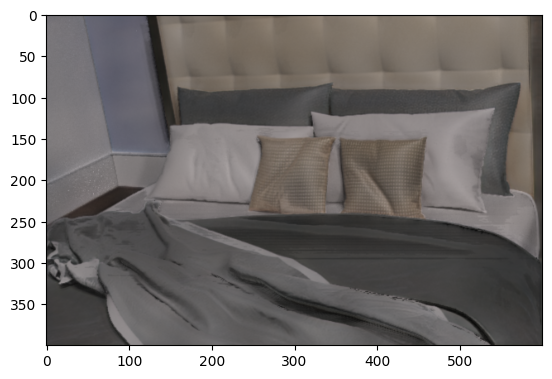

In [ ]:
#78 78 78
im = (render_livingroom_disk('bed_ours/bed.ply', 'bed_arealight_opt_disk_results/0124_09:56:31', twosided=True, spp=1000, fov=35.82, res=[400,600])[:,:,:3]).numpy()
plt.imshow(im**(1/2.2))

In [ ]:
#bed_ours/bed_changed.ply

In [ ]:
mi.util.write_bitmap('bed_ours.exr', render_livingroom_disk('bed_ours/bed.ply', 'bed_arealight_opt_disk_results/0124_09:56:31', twosided=True, spp=1000, fov=35.82, res=[400,600])[:,:,:3])

In [ ]:
Image.fromarray(((np.clip(np.abs(bed_ours-bed_changed)**(1/2.2),0,1) )*255).astype(np.uint8)).save('scene3_diff.png')

In [ ]:
def save_sRGB_np(img_np, name):
    if img_np.dtype is np.uint8:
        Image.fromarray(img_np).save(name)
    else:
        Image.fromarray((img_np*255).astype(np.uint8)).save(name)

In [ ]:
Image.fromarray((exr2np('/home/michael/yuma/ダウンロード/bed_scene5/0/dense_v1/albedo/0000.exr' ,height=400)*255).astype(np.uint8)).save('bed_ours/bed_albedo_ours.png')

In [ ]:
bed_ours = (render_livingroom_disk('bed_ours/bed.ply', 'bed_arealight_opt_disk_results/0124_09:56:31', twosided=True, spp=1000, fov=35.82, res=[400,600])[:,:,:3]).numpy()
bed_changed = (render_livingroom_disk('bed_ours/bed_changed.ply', 'bed_arealight_opt_disk_results/0124_09:56:31', twosided=True, spp=1000, fov=35.82, res=[400,600])[:,:,:3]).numpy()
#bed = (np.array(Image.open('/home/michael/yuma/ダウンロード/bed_scene5/bed.png')).astype(np.float32) / 255 )**(2.2)
bed_exr =exr2np('/home/michael/yuma/ダウンロード/bed_scene5/bed_png2exr.exr',height=400)
#save_sRGB_np(np.clip((bed+(bed_changed - bed_ours))**(1/2.2),0,1), 'bed_ours_finalimage.png')
save_sRGB_np(np.clip((bed_exr+(bed_changed - bed_ours)),0,1)**(1/2.2), 'bed_ours_finalimage_png2exr.png')

In [ ]:
new_al = change_albedo('/home/michael/yuma/ダウンロード/bed_scene5/0/dense_v1/albedo/0000.exr', '/home/michael/yuma/ダウンロード/bed_scene5/bed_mask.png', [50,50,50], height=400)
build_mesh_pixel_face_cut(depth, 'bed_ours/bed_changed', ((new_al.astype(np.float32))/255).reshape(-1), material_array=material, normal_array=normal, res=[400,600], fov=35.82, threshold_angle=1)

error num:7
angle error num:83


Mesh[
  name = "bed_ours/bed_changed",
  bbox = BoundingBox3f[
    min = [-0.307177, -0.112287, -1.00288],
    max = [0.279078, 0.207733, -0.252304]
  ],
  vertex_count = 959640,
  vertices = [29.3 MiB of vertex data],
  face_count = 479820,
  faces = [5.49 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

error num:7
angle error num:83


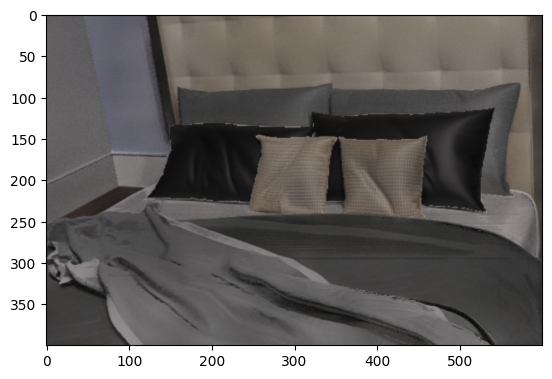

In [ ]:
new_al = change_albedo('/home/michael/yuma/ダウンロード/bed_scene5/0/dense_v1/albedo/0000.exr', '/home/michael/yuma/ダウンロード/bed_scene5/bed_mask.png', [0,0,0], height=400)
build_mesh_pixel_face_cut(depth, 'bed_ours/bed_changed', ((new_al.astype(np.float32))/255).reshape(-1), material_array=material, normal_array=normal, res=[400,600], fov=35.82, threshold_angle=1)
im_edited = (render_livingroom_disk('bed_ours/bed_changed.ply', 'bed_arealight_opt_disk_results/0124_09:56:31', spp=100, fov=35.82, res=[400,600])[:,:,:3]).numpy()
plt.imshow(im_edited**(1/2.2))

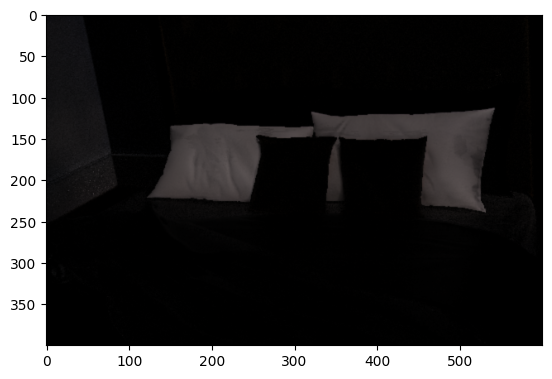

In [ ]:
plt.imshow(np.abs(im-im_edited))

In [ ]:
tmp1 = (np.array(Image.open('/home/michael/yuma/ダウンロード/bed_scene5/bed_edited.png')).astype(np.float32)/255)**(2.2)
tmp2 = (np.array(Image.open('/home/michael/yuma/ダウンロード/bed_scene5/bed.png')).astype(np.float32)/255)**(2.2)
Image.fromarray((np.clip(np.abs(tmp1-tmp2), 0,1)**(1/2.2)*255).astype(np.uint8)).save('bed_diff.png')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


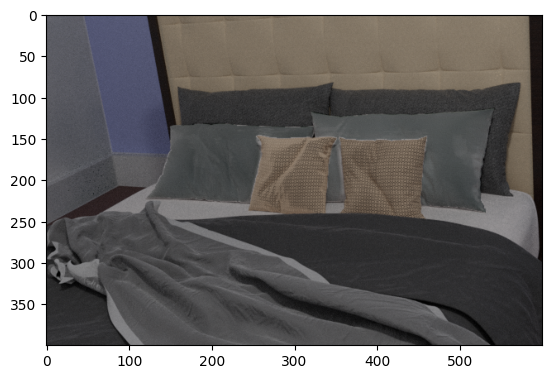

In [ ]:
plt.imshow((np.array(Image.open('/home/michael/yuma/ダウンロード/bed_scene5/bed.png')).astype(np.float32))/255  - (im-im_edited))

In [ ]:
np.load('bed_arealight_opt_disk_results/0124_14:09:08/rough_best.npy')

(959640,)

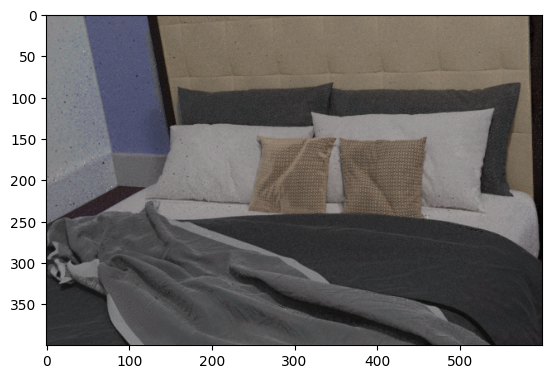

In [ ]:
im_mat = (render_livingroom_disk('bed_ours/bed.ply', 'bed_material_opt_disk_results/0124_20:17:59', mat=True, twosided=True, spp=1000, fov=35.82, res=[400,600])[:,:,:3]).numpy()
plt.imshow(im_mat**(1/2.2))

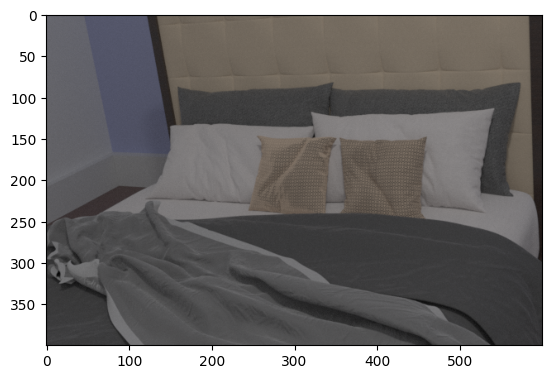

In [ ]:
plt.imshow(exr2np('/home/michael/yuma/ダウンロード/bed_scene5/bed.exr',height=400)**(1/3))

# Real image #400x640

In [ ]:

normal = Image.open('real_images_for_exp_400x640_ours/0_normal.png').resize((640, 400), Image.BICUBIC)
normal_new = np.zeros([400, 640, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load('real_images_for_exp_400x640_ours/depth_400x640_0.npy')
normal = normal_new
albedo = exr2np('real_images_for_exp_400x640_ours/dense_v1/albedo/0000.exr',height=400)
material = exr2np('real_images_for_exp_400x640_ours/dense_v1/material/0000.exr',height=400)
build_mesh_pixel_face_cut(depth, 'real_images_for_exp_400x640_ours/0', albedo.reshape(-1), material_array=material, normal_array=normal, res=[400,640], fov=fov, threshold_angle=1)

error num:3
angle error num:116


Mesh[
  name = "real_images_for_exp_400x640_ours/0",
  bbox = BoundingBox3f[
    min = [-0.412639, -0.15467, -1.01364],
    max = [0.292411, 0.253394, -0.561972]
  ],
  vertex_count = 1023524,
  vertices = [31.2 MiB of vertex data],
  face_count = 511762,
  faces = [5.86 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:

normal = Image.open('real_images_for_exp_400x640_ours/0_normal.png').resize((640, 400), Image.BICUBIC)
normal_new = np.zeros([400, 640, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load('real_images_for_exp_400x640_ours/depth_400x640_0.npy')
normal = normal_new
albedo = exr2np('real_images_for_exp_400x640_ours/dense_v1/albedo/0000.exr',height=400)
material = exr2np('real_images_for_exp_400x640_ours/dense_v1/material/0000.exr',height=400)
build_mesh_pixel_face_cut(depth, 'real_images_for_exp_400x640_ours/0', albedo.reshape(-1), material_array=material, normal_array=normal, res=[400,640], fov=fov, threshold_angle=1)

In [ ]:
normal = Image.open('real_images_for_exp_400x640_ours/1_normal.png').resize((640, 400), Image.BICUBIC)
normal_new = np.zeros([400, 640, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load('real_images_for_exp_400x640_ours/depth_400x640_1.npy')
normal = normal_new
albedo = exr2np('real_images_for_exp_400x640_ours/dense_v1/albedo/0001.exr',height=400)
material = exr2np('real_images_for_exp_400x640_ours/dense_v1/material/0001.exr',height=400)
build_mesh_pixel_face_cut(depth, 'real_images_for_exp_400x640_ours/1', albedo.reshape(-1), material_array=material, normal_array=normal, res=[400,640], fov=fov, threshold_angle=0.5)

error num:497
angle error num:6030


Mesh[
  name = "real_images_for_exp_400x640_ours/1",
  bbox = BoundingBox3f[
    min = [-0.26206, -0.0737321, -1.07476],
    max = [0.328635, 0.254237, -0.207646]
  ],
  vertex_count = 997892,
  vertices = [30.5 MiB of vertex data],
  face_count = 498946,
  faces = [5.71 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [ ]:
Image.fromarray(((exr2np('real_images_for_exp_400x640_ours/dense_v1/albedo/0000.exr',height=400))*255).astype(np.uint8)).save('real_images_for_exp_400x640_ours/0_albedo_ours.png')

In [75]:
im = (render_livingroom_disk('real_images_for_exp_400x640_ours/0.ply', '400x640_0_arealight_opt_disk_results/0125_14:55:04', twosided=True, spp=1000, fov=45, res=[400,640])[:,:,:3]).numpy()
Image.fromarray(((np.clip(im, 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_images_for_exp_400x640_ours/0_ours.png')

In [36]:
normal = Image.open('real_images_for_exp_400x640_ours/0_normal.png').resize((640, 400), Image.BICUBIC)
normal_new = np.zeros([400, 640, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load('real_images_for_exp_400x640_ours/depth_400x640_0.npy')
normal = normal_new
albedo_yellow = change_albedo('real_images_for_exp_400x640_ours/dense_v1/albedo/0000.exr', 'real_images_for_exp_400x640_ours/0_mask.png',height=400, new_color=[200,200,60]).astype(np.float32)/255

material = exr2np('real_images_for_exp_400x640_ours/dense_v1/material/0000.exr',height=400)
build_mesh_pixel_face_cut(depth, 'real_images_for_exp_400x640_ours/0_yellow', albedo_yellow.reshape(-1), material_array=material, normal_array=normal, res=[400,640], fov=fov, threshold_angle=1)

error num:3
angle error num:116


Mesh[
  name = "real_images_for_exp_400x640_ours/0_yellow",
  bbox = BoundingBox3f[
    min = [-0.412639, -0.15467, -1.01364],
    max = [0.292411, 0.253394, -0.561972]
  ],
  vertex_count = 1023524,
  vertices = [31.2 MiB of vertex data],
  face_count = 511762,
  faces = [5.86 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


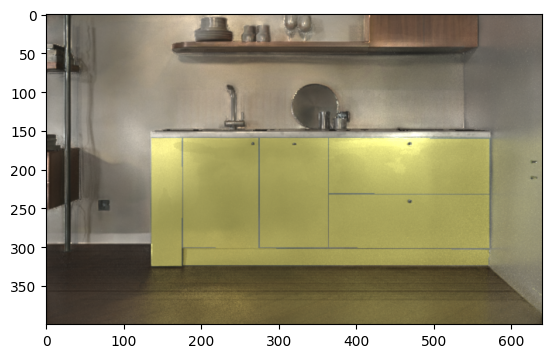

In [37]:
im_y = (render_livingroom_disk('real_images_for_exp_400x640_ours/0_yellow.ply', '400x640_0_arealight_opt_disk_results/0125_14:55:04', twosided=True, spp=1000, fov=45, res=[400,640])[:,:,:3]).numpy()
plt.imshow(im_y**(1/2.2))

In [74]:
im_y = (render_livingroom_disk('real_images_for_exp_400x640_ours/0_yellow.ply', '400x640_0_arealight_opt_disk_results/0125_14:55:04', twosided=True, spp=1000, fov=45, res=[400,640])[:,:,:3]).numpy()
Image.fromarray(((np.clip(im_y, 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_images_for_exp_400x640_ours/0_ours_changed.png')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


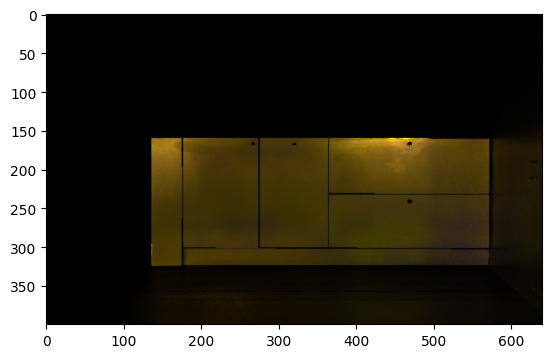

In [56]:
plt.imshow(np.abs(im-im_y))

In [70]:
Image.fromarray(((np.clip(np.abs(im-im_y), 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_images_for_exp_400x640_ours/0_ours_diff.png')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


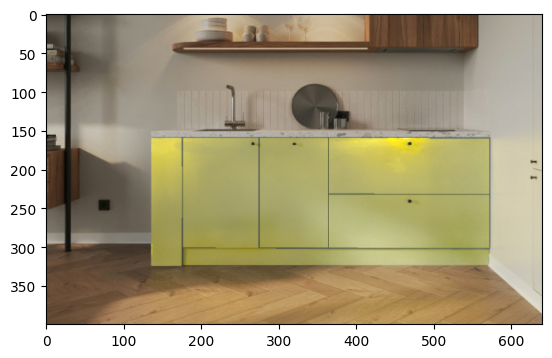

In [71]:
im_input = (np.array(Image.open('real_images_for_exp_400x640_ours/0.png')).astype(np.float32)/255)**(2.2)
plt.imshow(np.abs(im_input+(im_y-im))**(1/2.2))

In [72]:
Image.fromarray(((np.clip(np.abs(im_input+(im_y-im)), 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_images_for_exp_400x640_ours/0_ours_finalimage.png')

In [64]:
normal = Image.open('real_images_for_exp_400x640_ours/0_normal.png').resize((640, 400), Image.BICUBIC)
normal_new = np.zeros([400, 640, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load('real_images_for_exp_400x640_ours/depth_400x640_0.npy')
normal = normal_new
albedo = change_albedo('real_images_for_exp_400x640_ours/dense_v1/albedo/0000.exr', 'real_images_for_exp_400x640_ours/0_mask.png',height=400, new_color=[200,0,100]).astype(np.float32)/255

material = exr2np('real_images_for_exp_400x640_ours/dense_v1/material/0000.exr',height=400)
build_mesh_pixel_face_cut(depth, 'real_images_for_exp_400x640_ours/0_pink', albedo.reshape(-1), material_array=material, normal_array=normal, res=[400,640], fov=fov, threshold_angle=1)

error num:3
angle error num:116


Mesh[
  name = "real_images_for_exp_400x640_ours/0_pink",
  bbox = BoundingBox3f[
    min = [-0.412639, -0.15467, -1.01364],
    max = [0.292411, 0.253394, -0.561972]
  ],
  vertex_count = 1023524,
  vertices = [31.2 MiB of vertex data],
  face_count = 511762,
  faces = [5.86 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

# scene3

In [49]:
normal = Image.open('scene3_ours/scene3_normal_image.png').resize((512, 512), Image.BICUBIC)
normal_new = np.zeros([512, 512, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 35.82
depth = np.load('scene3_ours/depth_simpleroom.npy')
normal = normal_new
albedo = exr2np('scene3_ours/dense_v1/albedo/0000.exr',height=512)
material = exr2np('scene3_ours/dense_v1/material/0000.exr',height=512)
build_mesh_pixel_face_cut(depth, 'scene3_ours/0', albedo.reshape(-1), material_array=material, normal_array=normal, res=[512,512], fov=fov, threshold_angle=1)

error num:7
angle error num:242


Mesh[
  name = "scene3_ours/0",
  bbox = BoundingBox3f[
    min = [-0.264591, -0.187722, -1.02989],
    max = [0.221334, 0.23381, -0.499601]
  ],
  vertex_count = 1047580,
  vertices = [32 MiB of vertex data],
  face_count = 523790,
  faces = [5.99 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [45]:
material_nometal = material
material_nometal[:,:,1] = 0
build_mesh_pixel_face_cut(depth, 'scene3_ours/0_nometal', albedo.reshape(-1), material_array=material_nometal, normal_array=normal, res=[512,512], fov=fov, threshold_angle=1)

error num:7
angle error num:242


Mesh[
  name = "scene3_ours/0_nometal",
  bbox = BoundingBox3f[
    min = [-0.264591, -0.187722, -1.02989],
    max = [0.221334, 0.23381, -0.499601]
  ],
  vertex_count = 1047580,
  vertices = [32 MiB of vertex data],
  face_count = 523790,
  faces = [5.99 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

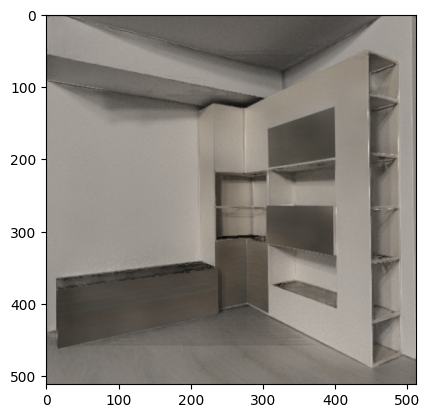

In [140]:
im_mat = (render_livingroom_disk('scene3_ours/0.ply', 'scene3_arealight_opt_disk_results/0126_06:46:00_bestvalue', twosided=False, spp=1000, fov=35.82, res=[512,512])[:,:,:3]).numpy()
plt.imshow(im_mat**(1/2.2))

In [64]:
mi.util.write_bitmap('scene3_ours.png', (render_livingroom_disk('scene3_ours/0.ply', 'scene3_arealight_opt_disk_results/0126_06:46:00_bestvalue', twosided=True, spp=1000, fov=35.82, res=[512,512])[:,:,:3]))

In [26]:
normal = Image.open('scene3_ours/scene3_normal_image.png').resize((512, 512), Image.BICUBIC)
normal_new = np.zeros([512, 512, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 35.82
depth = np.load('scene3_ours/depth_simpleroom.npy')
normal = normal_new
albedo = change_albedo('scene3_ours/dense_v1/albedo/0000.exr', '/home/michael/yuma/ダウンロード/simple-living-room_scene3/scene3_mask.png',height=512, new_color=[75,26,26]).astype(np.float32)/255
material = exr2np('scene3_ours/dense_v1/material/0000.exr',height=512)
build_mesh_pixel_face_cut(depth, 'scene3_ours/0_blown', albedo.reshape(-1), material_array=material, normal_array=normal, res=[512,512], fov=fov, threshold_angle=1)

error num:7
angle error num:242


Mesh[
  name = "scene3_ours/0_blown",
  bbox = BoundingBox3f[
    min = [-0.264591, -0.187722, -1.02989],
    max = [0.221334, 0.23381, -0.499601]
  ],
  vertex_count = 1047580,
  vertices = [32 MiB of vertex data],
  face_count = 523790,
  faces = [5.99 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

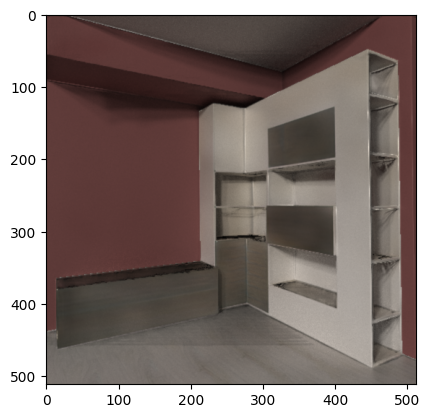

In [141]:
im_mat_changed = (render_livingroom_disk('scene3_ours/0_blown.ply', 'scene3_arealight_opt_disk_results/0126_06:46:00_bestvalue', twosided=False, spp=1000, fov=35.82, res=[512,512])[:,:,:3])
#mi.util.write_bitmap('scene3_ours_changed.png', im_mat_changed)
plt.imshow(im_mat_changed**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


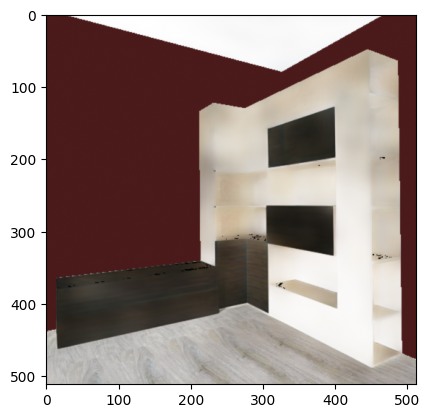

In [75]:
plt.imshow(render_livingroom_disk('scene3_ours/0_blown.ply', 'scene3_arealight_opt_disk_results/0126_06:46:00_bestvalue', twosided=True, spp=1000, fov=35.82, res=[512,512])[:,:,3:6])

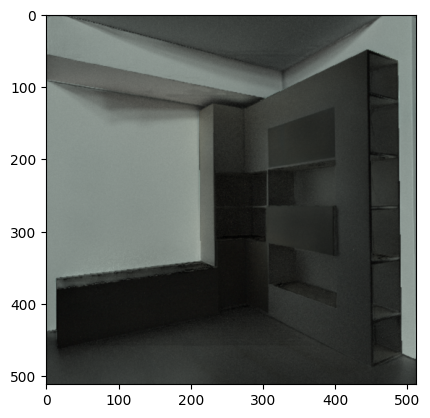

In [142]:
plt.imshow(np.clip(np.abs(im_mat_changed - im_mat),0,1)**(1/2.2))

In [79]:
Image.fromarray(((np.clip(np.abs(im_mat_changed - im_mat),0,1)**(1/2.2))*255).astype(np.uint8)).save('scene3_diff_ours.png')

In [80]:
im_scene3 = exr2np('/home/michael/yuma/ダウンロード/simple-living-room_scene3/simpleroom.exr', height=512)
Image.fromarray(((np.clip(im_scene3+(im_mat_changed - im_mat), 0,1)**(1/2.2))*255).astype(np.uint8)).save('scene3_finalimage.png')

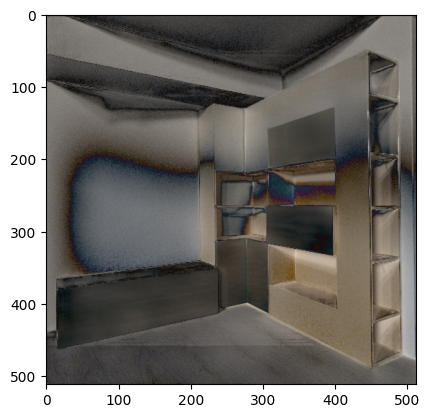

In [148]:
im_scene3 = exr2np('/home/michael/yuma/ダウンロード/simple-living-room_scene3/simpleroom.exr', height=512)
plt.imshow(np.abs(im_scene3 - im_mat)**(1/2.2))

In [81]:
im_scene3_edited = exr2np('/home/michael/yuma/ダウンロード/simple-living-room_scene3/simpleroom_edited.exr',height=512)
Image.fromarray(((np.clip(np.abs(im_scene3_edited  - im_scene3),0,1)**(1/2.2))*255).astype(np.uint8)).save('scene3_diff.png')

# Real image (flower)

In [39]:
dir_path = 'real_images_for_exp_600x400_ours'
normal = Image.open(dir_path + '/0_normal.png').resize((400, 600), Image.BICUBIC) # (W,H)
normal_new = np.zeros([600, 400, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load(dir_path + '/depth_0.npy')
normal = normal_new
albedo = exr2np(dir_path +'/dense_v1/albedo/0000.exr',height=600)
material = exr2np(dir_path + '/dense_v1/material/0000.exr',height=600)
build_mesh_pixel_face_cut(depth, dir_path + '/0', albedo.reshape(-1), material_array=material, normal_array=normal, res=[600,400], fov=fov, threshold_angle=1)

error num:5
angle error num:26


Mesh[
  name = "real_images_for_exp_600x400_ours/0",
  bbox = BoundingBox3f[
    min = [-0.413991, -0.600098, -1.08815],
    max = [0.365656, 0.621357, -0.460188]
  ],
  vertex_count = 959876,
  vertices = [29.3 MiB of vertex data],
  face_count = 479938,
  faces = [5.49 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


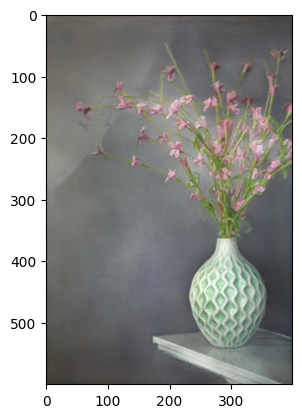

In [42]:
im = (render_livingroom_disk('real_images_for_exp_600x400_ours/0.ply', 'flower_arealight_opt_disk_results/0127_15:53:08', twosided=True, spp=1000, fov=45, res=[600,400])[:,:,:3]).numpy()
plt.imshow(im**(1/2.2))

In [43]:
dir_path = 'real_images_for_exp_600x400_ours'
normal = Image.open(dir_path + '/0_normal.png').resize((400, 600), Image.BICUBIC) # (W,H)
normal_new = np.zeros([600, 400, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load(dir_path + '/depth_0.npy')
normal = normal_new
albedo = exr2np(dir_path +'/dense_v1/albedo/0000_blue.exr',height=600)
material = exr2np(dir_path + '/dense_v1/material/0000.exr',height=600)
build_mesh_pixel_face_cut(depth, dir_path + '/0_blue', albedo.reshape(-1), material_array=material, normal_array=normal, res=[600,400], fov=fov, threshold_angle=1)

error num:5
angle error num:26


Mesh[
  name = "real_images_for_exp_600x400_ours/0_blue",
  bbox = BoundingBox3f[
    min = [-0.413991, -0.600098, -1.08815],
    max = [0.365656, 0.621357, -0.460188]
  ],
  vertex_count = 959876,
  vertices = [29.3 MiB of vertex data],
  face_count = 479938,
  faces = [5.49 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


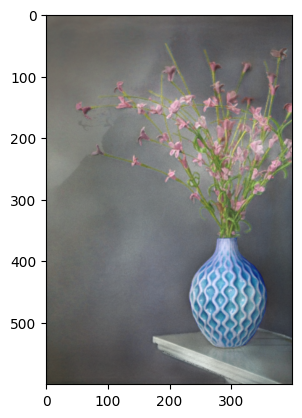

In [44]:
im_blue = (render_livingroom_disk('real_images_for_exp_600x400_ours/0_blue.ply', 'flower_arealight_opt_disk_results/0127_15:53:08', twosided=True, spp=1000, fov=45, res=[600,400])[:,:,:3]).numpy()
plt.imshow(im_blue**(1/2.2))

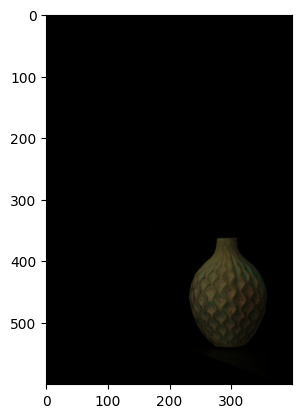

In [45]:
plt.imshow(np.abs(im - im_blue))

In [46]:
dir_path = 'real_images_for_exp_600x400_ours'
normal = Image.open(dir_path + '/0_normal.png').resize((400, 600), Image.BICUBIC) # (W,H)
normal_new = np.zeros([600, 400, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load(dir_path + '/depth_0.npy')
normal = normal_new
albedo = exr2np(dir_path +'/dense_v1/albedo/0000_navy.exr',height=600)
material = exr2np(dir_path + '/dense_v1/material/0000.exr',height=600)
build_mesh_pixel_face_cut(depth, dir_path + '/0_navy', albedo.reshape(-1), material_array=material, normal_array=normal, res=[600,400], fov=fov, threshold_angle=1)

error num:5
angle error num:26


Mesh[
  name = "real_images_for_exp_600x400_ours/0_navy",
  bbox = BoundingBox3f[
    min = [-0.413991, -0.600098, -1.08815],
    max = [0.365656, 0.621357, -0.460188]
  ],
  vertex_count = 959876,
  vertices = [29.3 MiB of vertex data],
  face_count = 479938,
  faces = [5.49 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


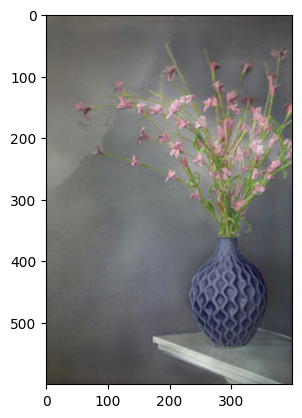

In [47]:
im_na = (render_livingroom_disk('real_images_for_exp_600x400_ours/0_navy.ply', 'flower_arealight_opt_disk_results/0127_15:53:08', twosided=True, spp=1000, fov=45, res=[600,400])[:,:,:3]).numpy()
plt.imshow(im_na**(1/2.2))

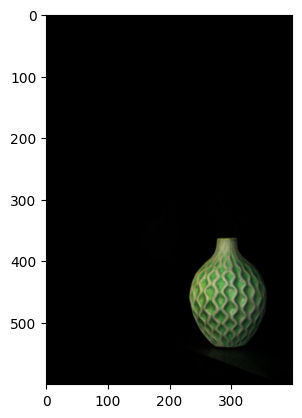

In [48]:
plt.imshow(np.abs(im - im_na))

# Real image 360x640 Kitchen

In [54]:
def build_mesh_from_estimation(dir_path, res=[360,640], fov=45):
    normal = Image.open(dir_path + '/0_normal.png').resize((res[1],res[0]), Image.BICUBIC) # (W,H)
    normal_new = np.zeros([res[0], res[1], 3])
    normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
    normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
    normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

    depth = np.load(dir_path + '/depth_0.npy')
    normal = normal_new
    albedo = exr2np(dir_path +'/dense_v1/albedo/0000.exr',height=res[0])
    material = exr2np(dir_path + '/dense_v1/material/0000.exr',height=res[0])
    return build_mesh_pixel_face_cut(depth, dir_path + '/0', albedo.reshape(-1), material_array=material, normal_array=normal, res=res, fov=fov, threshold_angle=1)

In [53]:
build_mesh_from_estimation('real_images_for_exp_360x640_ours',res=[360,640])

error num:121
angle error num:3152


In [73]:
build_mesh_from_estimation('real_image_ex_ours',res=[360,640])

error num:1
angle error num:47


Mesh[
  name = "real_image_ex_ours/0",
  bbox = BoundingBox3f[
    min = [-0.4101, -0.0605449, -1.0245],
    max = [0.40816, 0.228687, -0.170084]
  ],
  vertex_count = 921408,
  vertices = [28.1 MiB of vertex data],
  face_count = 460704,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [76]:
normal = Image.open('real_image_ex_ours/0_normal.png').resize((640, 360), Image.BICUBIC)
normal_new = np.zeros([360, 640, 3])
normal_new[:,:,0] = -1*(((np.array(normal).astype(np.float32) / 255)[:,:,0])*2-1)
normal_new[:,:,1] = ((np.array(normal).astype(np.float32) / 255)[:,:,1])*2-1
normal_new[:,:,2] = (((np.array(normal).astype(np.float32) / 255)[:,:,2])*2-1)

fov = 45
depth = np.load('real_image_ex_ours/depth_0.npy')
normal = normal_new
albedo_yellow = change_albedo('real_image_ex_ours/dense_v1/albedo/0000.exr', 'real_image_ex_ours/mask.png',height=360, new_color=[42,140,46]).astype(np.float32)/255

material = exr2np('real_image_ex_ours/dense_v1/material/0000.exr',height=360)
build_mesh_pixel_face_cut(depth, 'real_image_ex_ours/0_green', albedo_yellow.reshape(-1), material_array=material, normal_array=normal, res=[360,640], fov=fov, threshold_angle=1)

error num:1
angle error num:47


Mesh[
  name = "real_image_ex_ours/0_green",
  bbox = BoundingBox3f[
    min = [-0.4101, -0.0605449, -1.0245],
    max = [0.40816, 0.228687, -0.170084]
  ],
  vertex_count = 921408,
  vertices = [28.1 MiB of vertex data],
  face_count = 460704,
  faces = [5.27 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


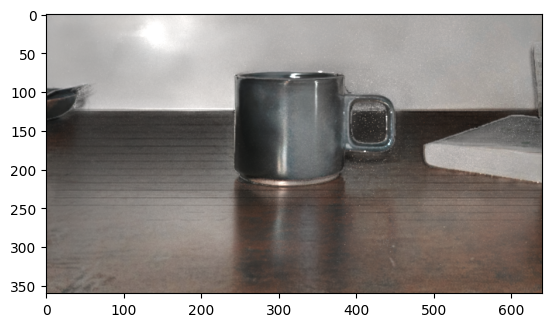

In [77]:
im = (render_livingroom_disk('real_image_ex_ours/0.ply', '360x600_2ex_arealight_opt_disk_results/0127_19:20:09', twosided=True, spp=1000, fov=45, res=[360,640])[:,:,:3]).numpy()
plt.imshow(im**(1/2.2))

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


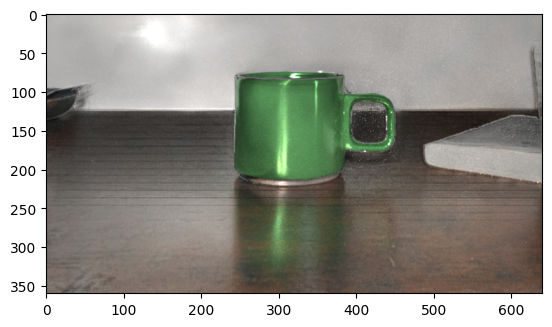

In [78]:
im_g = (render_livingroom_disk('real_image_ex_ours/0_green.ply', '360x600_2ex_arealight_opt_disk_results/0127_19:20:09', twosided=True, spp=1000, fov=45, res=[360,640])[:,:,:3]).numpy()
plt.imshow(im_g**(1/2.2))

In [80]:
Image.fromarray(((np.clip(np.abs(im), 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_images_ex_ours/0_ours.png')
Image.fromarray(((np.clip(np.abs(im_g), 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_images_ex_ours/0_ours_changed.png')
im_input = ((np.array(Image.open('real_image_ex_ours/0.png')).astype(np.float32)/255)**(2.2))[:,:,:3]
Image.fromarray(((np.clip(np.abs(im_g-im), 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_image_ex_ours/0_ours_diff.png')
Image.fromarray(((np.clip(im_input+(im_g-im), 0, 1)**(1/2.2))*255).astype(np.uint8)).save('real_image_ex_ours/0_ours_finalimage.png')

# living default mesh

In [82]:
scene = mi.load_file('living-room-3/living-room-3/scene.xml')
scene_red = mi.load_file('living-room-3/living-room-3/scene_red.xml')
Image.fromarray((np.clip(np.abs(mi.render(scene_red,spp=2000)[:,:,:3].numpy() - mi.render(scene,spp=2000)[:,:,:3].numpy()),0,1)**(1/2.2)*255).astype(np.uint8)).save('living_diff.png')


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


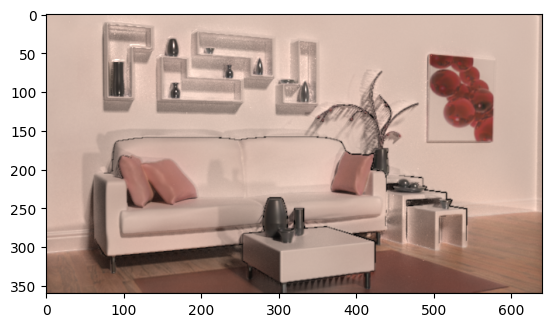

In [149]:
im = (render_livingroom_disk('livingroom_depthgt_2.ply', 'livingroom_arealight_opt_disk_results/0203_18:07:21', twosided=True, spp=1000, fov=50, res=[360,640])[:,:,:3]).numpy()
plt.imshow(im**(1/2.2))

In [160]:
Image.fromarray((im**(1/2.2)*255).astype(np.uint8)).save('living_default_mesh.png')

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


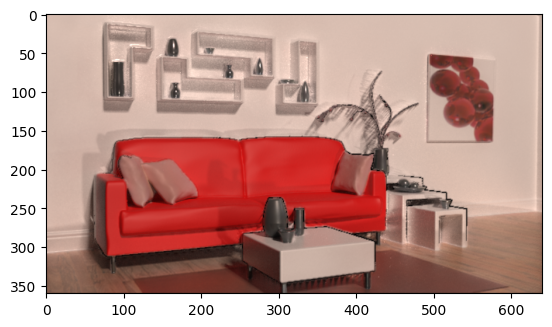

In [157]:
im_red = (render_livingroom_disk('livingroom_depthgt_2_red.ply', 'livingroom_arealight_opt_disk_results/0203_18:07:21', twosided=True, spp=1000, fov=50, res=[360,640])[:,:,:3]).numpy()
plt.imshow(im_red**(1/2.2))

In [161]:
Image.fromarray((im_red**(1/2.2)*255).astype(np.uint8)).save('living_default_mesh_red.png')

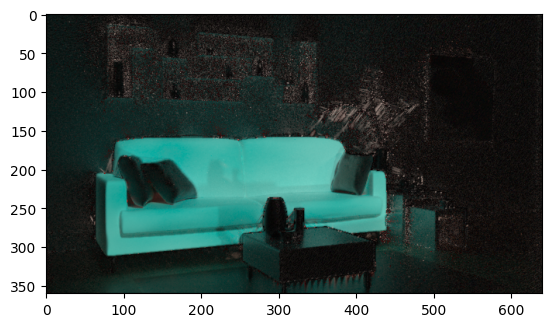

In [158]:
plt.imshow(np.abs(im-im_red)**(1/2.2))

In [162]:
Image.fromarray(((np.abs(im-im_red)**(1/2.2))*255).astype(np.uint8)).save('living_default_mesh_diff.png')

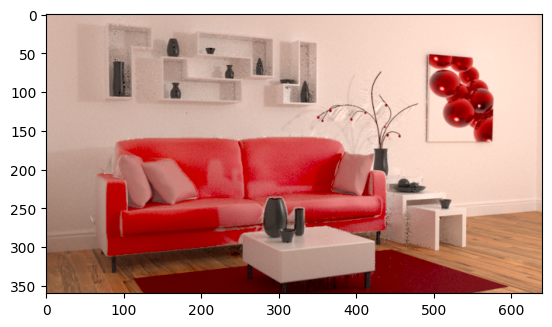

In [159]:
im_in = exr2np('living-room-3/living-room-3/livingroom_nograss.exr',height=360)
plt.imshow(np.clip(im_in+im_red-im, 0,1)**(1/2.2))

In [163]:
Image.fromarray(((np.clip(im_in+im_red-im, 0,1)**(1/2.2))*255).astype(np.uint8)).save('living_default_mesh_final.png')

In [167]:
y = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/0203_20:12:01_sizeopt', twosided=True, spp=1000, fov=50, res=[360,640])[:,:,:3]).numpy()
Image.fromarray(((y**(1/2.2))*255).astype(np.uint8)).save('living_sizeopt.png')

In [172]:
al_color = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', [255,165,0]).astype(np.float32) /255
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_orange',  al_color.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)
al_color = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', [255,255,0]).astype(np.float32) /255
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_yellow',  al_color.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)
al_color = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', [0,0,255]).astype(np.float32) /255
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_blue',  al_color.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)
al_color = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', [128,0,128]).astype(np.float32) /255
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_purple',  al_color.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)
al_color = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', [0,128,0]).astype(np.float32) /255
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_green',  al_color.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)
al_color = change_albedo('/home/michael/yuma/ドキュメント/IndoorInverseRendering/mgnet/livingroom_3/dense_v1/albedo/0000.exr','living-room-3/living-room-3/living_mask2.png', [255,192,203]).astype(np.float32) /255
build_mesh_pixel_face_cut((depth_anyv2_raw*0.5+0.5), 'livingroom_pixelface_cut1_depthanyv2_raw_pink',  al_color.reshape(-1), material_array=mat_l_2, normal_array=living_stable_normal_new, res=[360,640], fov=50, threshold_angle=1)


error num:19
angle error num:640
error num:19
angle error num:640
error num:19
angle error num:640
error num:19
angle error num:640
error num:19
angle error num:640
error num:19
angle error num:640


Mesh[
  name = "livingroom_pixelface_cut1_depthanyv2_raw_pink",
  bbox = BoundingBox3f[
    min = [-0.386374, -0.161421, -1.02839],
    max = [0.473551, 0.260167, -0.507166]
  ],
  vertex_count = 918964,
  vertices = [28 MiB of vertex data],
  face_count = 459482,
  faces = [5.26 MiB of face data],
  face_normals = 0,
  mesh attributes = [
    vertex_metallic: 1 float,
    vertex_roughness: 1 float,
    vertex_albedo: 3 floats
  ]
]

In [174]:
im = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=1000, fov=50, res=[360,640])[:,:,:3]).numpy()
colors = ['orange','yellow','blue','purple','green','pink']
for x in colors:
    im_color = (render_livingroom_disk('livingroom_pixelface_cut1_depthanyv2_raw_'+x+'.ply', 'livingroom_arealight_opt_disk_results/bestvalue_0109_23:15:50', twosided=True, spp=1000, fov=50, res=[360,640])[:,:,:3]).numpy()
    Image.fromarray(((np.clip(im_in+im_color-im, 0,1)**(1/2.2))*255).astype(np.uint8)).save('living_final'+x+'.png')